In [3]:
import os
import json
import pandas as pd
import numpy as np
import tomotopy as tp
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
import logging
import warnings
import random
from collections import defaultdict
from tqdm import tqdm

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')

# Configurar logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Configurar stopwords (ajusta según el idioma de las descripciones)
stop_words = set(stopwords.words('english'))  # Cambia a 'spanish' si las descripciones están en español

# Rutas a los archivos
POLYVORE_METADATA_PATH = "datasets/polyvore/item_metadata.json"
POLYVORE_OUTFITS_PATH = "datasets/polyvore/nondisjoint/train.json"

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH, 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            item_id = str(item['item_id'])  # Asegurar que el ID sea string
            metadata[item_id] = item
    logger.info(f"Loaded {len(metadata)} metadata entries")
    print(f"Loaded {len(metadata)} metadata entries")
    return metadata

def load_outfits(outfits_path):
    """Load outfits from train.json."""
    with open(outfits_path, 'r') as f:
        outfits = json.load(f)
    logger.info(f"Loaded {len(outfits)} outfits from {outfits_path}")
    print(f"Loaded {len(outfits)} outfits from {outfits_path}")
    return outfits

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:  # Nota: typo en el JSON ('catgeories')
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    combined_text = ' '.join(text_fields)
    return combined_text

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    # Convertir a minúsculas
    text = text.lower()
    # Quitar puntuación
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Tokenizar
    tokens = word_tokenize(text)
    # Quitar stopwords y palabras cortas
    tokens = [token for token in tokens if token not in stop_words and len(token) > 2]
    return tokens

def outfits_to_corpus(outfits, metadata):
    """Convierte las descripciones de los outfits en un formato para tomotopy."""
    docs = []
    valid_outfit_ids = []
    item_to_outfits = defaultdict(list)  # Mapa de item_id a los outfits a los que pertenece

    for outfit in tqdm(outfits, desc="Processing outfits"):
        set_id = outfit['set_id']
        item_ids = outfit['item_ids']
        
        # Permutar el orden de las prendas
        item_ids = list(item_ids)
        random.shuffle(item_ids)
        
        # Concatenar las descripciones de las prendas
        combined_texts = []
        for item_id in item_ids:
            item_id = str(item_id)
            if item_id not in metadata:
                continue
            item_text = combine_text_fields(metadata[item_id])
            if item_text:
                combined_texts.append(item_text)
            # Registrar que este item pertenece a este outfit
            item_to_outfits[item_id].append(set_id)
        
        if not combined_texts:
            continue
        
        combined_text = ' '.join(combined_texts)
        tokens = preprocess_text(combined_text)
        if not tokens:
            continue
        
        docs.append(tokens)
        valid_outfit_ids.append(set_id)
    
    return docs, valid_outfit_ids, item_to_outfits

def run_hlda(docs, num_levels=3):
    """Aplica hLDA usando tomotopy."""
    try:
        # Crear el modelo hLDA
        mdl = tp.HLDAModel(
            depth=num_levels,  # Profundidad de la jerarquía
            alpha=1.0,         # Mayor dispersión de temas por documento
            eta=0.5,           # Mayor dispersión de palabras por tema
            gamma=1.0          # Fomentar más temas nuevos
        )
        
        # Añadir documentos al modelo
        for doc in docs:
            mdl.add_doc(doc)
        
        # Entrenar el modelo
        mdl.burn_in = 100
        mdl.train(0)
        print('Num docs:', len(mdl.docs), 'Vocab size:', len(mdl.vocabs))
        
        for i in range(0, 200, 10):
            mdl.train(10)
            print(f'Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}')
        
        # Determinar el número real de niveles generados
        max_level = 0
        for topic_id in range(mdl.global_k):
            level = mdl.level(topic_id)
            max_level = max(max_level, level)
        actual_levels = max_level + 1  # Los niveles empiezan desde 0
        print(f"Niveles generados por hLDA: {actual_levels}")
        
        # Mostrar los temas en cada nivel
        for level in range(actual_levels):
            print(f"\nTemas en nivel {level+1}:")
            for k in range(mdl.global_k):
                if mdl.level(k) != level or not mdl.is_live_topic(k):
                    continue
                topic_words = mdl.get_topic_words(k, top_n=5)
                print(f"Tema {k}: {[word for word, _ in topic_words]}")
        
        return mdl, actual_levels
    except Exception as e:
        print(f"Error al ejecutar hLDA: {e}")
        return None, 0

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, num_examples=5, num_levels=3):
    """Interpreta los grupos generados por hLDA y asigna prendas a temas."""
    if mdl is None:
        print("No se pudo interpretar los grupos porque hLDA falló.")
        return None, None
    
    # Ajustar num_levels al número real de niveles generados
    num_levels = min(num_levels, mdl.max_level + 1)
    
    # Asignar outfits a temas en cada nivel
    topic_assignments = {f"level_{level+1}": [] for level in range(num_levels)}
    
    for i, doc in enumerate(mdl.docs):
        # Obtener el camino de temas para este documento (outfit)
        path = doc.get_topic_path()
        # path es una lista de tuplas (level, topic_id, probability)
        for level in range(num_levels):
            # Encontrar el tema en este nivel
            level_topic = -1
            for lvl, topic_id, _ in path:
                if lvl == level:
                    level_topic = topic_id
                    break
            topic_assignments[f"level_{level+1}"].append((outfit_ids[i], level_topic, docs[i]))
    
    # Agrupar outfits por tema en cada nivel
    outfit_groups = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, doc in topic_assignments[level_key]:
            if topic not in outfit_groups[level_key]:
                outfit_groups[level_key][topic] = []
            outfit_groups[level_key][topic].append((outfit_id, doc))
    
    # Asignar prendas a temas (heredan el tema de su outfit)
    item_to_topics = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, _ in topic_assignments[level_key]:
            # Encontrar todas las prendas en este outfit
            for item_id in item_to_outfits[outfit_id]:
                item_to_topics[level_key][item_id] = topic
    
    # Mostrar ejemplos de outfits por tema
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        print(f"\nEjemplos de outfits por tema ({level_key}):")
        for topic, outfits in outfit_groups[level_key].items():
            if topic == -1:
                continue
            print(f"\nTema {topic}:")
            print(f"Total de outfits: {len(outfits)}")
            print(f"Ejemplos (Set ID, palabras):")
            for outfit_id, doc in outfits[:num_examples]:
                print(f"  - {outfit_id}: {doc}")
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)
        print(f"Asignaciones de temas para prendas (nivel {level+1}) guardadas en '{output_path}'")

def main():
    dataset_dir = "datasets/polyvore"
    
    # Cargar metadatos y outfits
    metadata = load_metadata(dataset_dir)
    outfits = load_outfits(POLYVORE_OUTFITS_PATH)
    
    # Convertir outfits a corpus
    docs, valid_outfit_ids, item_to_outfits = outfits_to_corpus(outfits, metadata)
    print(f"Se procesaron {len(valid_outfit_ids)} outfits con texto válido")
    
    # Entrenar hLDA
    mdl, actual_levels = run_hlda(docs, num_levels=3)
    
    # Interpretar los resultados y asignar temas a prendas
    outfit_groups, item_to_topics = interpret_groups(
        mdl, valid_outfit_ids, docs, metadata, item_to_outfits, num_examples=5, num_levels=actual_levels
    )
    
    # Guardar las asignaciones de temas para las prendas
    if item_to_topics:
        save_item_assignments(item_to_topics, num_levels=actual_levels)
    else:
        print("No se generaron asignaciones de temas debido a un error en hLDA.")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

[nltk_data] Downloading package punkt to /Users/lara/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /Users/lara/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lara/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
INFO:__main__:Loaded 251008 metadata entries
INFO:__main__:Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Loaded 251008 metadata entries
Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Processing outfits: 100%|██████████| 53306/53306 [00:13<00:00, 3925.39it/s]


Se procesaron 53306 outfits con texto válido
Num docs: 53306 Vocab size: 82240
Iteration: 0	Log-likelihood: -7.9449439459397
Iteration: 10	Log-likelihood: -7.861115601002411
Iteration: 20	Log-likelihood: -7.859038833103209
Iteration: 30	Log-likelihood: -7.859313956869257
Iteration: 40	Log-likelihood: -7.857648013245386
Iteration: 50	Log-likelihood: -7.84866981162408
Iteration: 60	Log-likelihood: -7.843062161841383
Iteration: 70	Log-likelihood: -7.839585845509524
Iteration: 80	Log-likelihood: -7.836482273593929
Iteration: 90	Log-likelihood: -7.834449726990992
Iteration: 100	Log-likelihood: -7.830146016209108
Iteration: 110	Log-likelihood: -7.80317601660607
Iteration: 120	Log-likelihood: -7.785210778392489
Iteration: 130	Log-likelihood: -7.774491428993697
Iteration: 140	Log-likelihood: -7.766143733936698
Iteration: 150	Log-likelihood: -7.7608279183952735
Iteration: 160	Log-likelihood: -7.75761463106766
Iteration: 170	Log-likelihood: -7.7561253512926385
Iteration: 180	Log-likelihood: -7.7

In [4]:
import os
import json
import pandas as pd
import numpy as np
import tomotopy as tp
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
import logging
import warnings
import random
from collections import defaultdict
from tqdm import tqdm

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')

# Configurar logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Configurar stopwords (ajusta según el idioma de las descripciones)
stop_words = set(stopwords.words('english'))  # Cambia a 'spanish' si las descripciones están en español

# Rutas a los archivos
POLYVORE_METADATA_PATH = "datasets/polyvore/item_metadata.json"
POLYVORE_OUTFITS_PATH = "datasets/polyvore/nondisjoint/train.json"

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH, 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            item_id = str(item['item_id'])  # Asegurar que el ID sea string
            metadata[item_id] = item
    logger.info(f"Loaded {len(metadata)} metadata entries")
    print(f"Loaded {len(metadata)} metadata entries")
    return metadata

def load_outfits(outfits_path):
    """Load outfits from train.json."""
    with open(outfits_path, 'r') as f:
        outfits = json.load(f)
    logger.info(f"Loaded {len(outfits)} outfits from {outfits_path}")
    print(f"Loaded {len(outfits)} outfits from {outfits_path}")
    return outfits

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:  # Nota: typo en el JSON ('catgeories')
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    combined_text = ' '.join(text_fields)
    return combined_text

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    # Convertir a minúsculas
    text = text.lower()
    # Quitar puntuación
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Tokenizar
    tokens = word_tokenize(text)
    # Quitar stopwords y palabras cortas
    tokens = [token for token in tokens if token not in stop_words and len(token) > 2]
    return tokens

def outfits_to_corpus(outfits, metadata):
    """Convierte las descripciones de los outfits en un formato para tomotopy."""
    docs = []
    valid_outfit_ids = []
    item_to_outfits = defaultdict(list)  # Mapa de item_id a los outfits a los que pertenece

    for outfit in tqdm(outfits, desc="Processing outfits"):
        set_id = outfit['set_id']
        item_ids = outfit['item_ids']
        
        # Permutar el orden de las prendas
        item_ids = list(item_ids)
        random.shuffle(item_ids)
        
        # Concatenar las descripciones de las prendas
        combined_texts = []
        for item_id in item_ids:
            item_id = str(item_id)
            if item_id not in metadata:
                continue
            item_text = combine_text_fields(metadata[item_id])
            if item_text:
                combined_texts.append(item_text)
            # Registrar que este item pertenece a este outfit
            item_to_outfits[item_id].append(set_id)
        
        if not combined_texts:
            continue
        
        combined_text = ' '.join(combined_texts)
        tokens = preprocess_text(combined_text)
        if not tokens:
            continue
        
        docs.append(tokens)
        valid_outfit_ids.append(set_id)
    
    return docs, valid_outfit_ids, item_to_outfits

def run_hlda(docs, num_levels=3):
    """Aplica hLDA usando tomotopy."""
    try:
        # Crear el modelo hLDA
        mdl = tp.HLDAModel(
            depth=num_levels,  # Profundidad de la jerarquía
            alpha=1.0,         # Mayor dispersión de temas por documento
            eta=0.5,           # Mayor dispersión de palabras por tema
            gamma=1.0          # Fomentar más temas nuevos
        )
        
        # Añadir documentos al modelo
        for doc in docs:
            mdl.add_doc(doc)
        
        # Entrenar el modelo
        mdl.burn_in = 100
        mdl.train(0)
        print('Num docs:', len(mdl.docs), 'Vocab size:', len(mdl.vocabs))
        
        for i in range(0, 200, 10):
            mdl.train(10)
            print(f'Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}')
        
        # Determinar el número real de niveles generados
        max_level = 0
        topic_levels = {}  # Mapa de topic_id a su nivel
        for topic_id in range(mdl.k):  # mdl.k es el número total de temas generados
            if mdl.is_live_topic(topic_id):
                level = mdl.level(topic_id)
                topic_levels[topic_id] = level
                max_level = max(max_level, level)
        actual_levels = max_level + 1  # Los niveles empiezan desde 0
        print(f"Niveles generados por hLDA: {actual_levels}")
        
        # Mostrar los temas en cada nivel
        for level in range(actual_levels):
            print(f"\nTemas en nivel {level+1}:")
            for topic_id in range(mdl.k):
                if topic_id not in topic_levels or topic_levels[topic_id] != level or not mdl.is_live_topic(topic_id):
                    continue
                topic_words = mdl.get_topic_words(topic_id, top_n=5)
                print(f"Tema {topic_id}: {[word for word, _ in topic_words]}")
        
        return mdl, actual_levels, topic_levels
    except Exception as e:
        print(f"Error al ejecutar hLDA: {e}")
        return None, 0, {}

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpreta los grupos generados por hLDA y asigna prendas a temas."""
    if mdl is None:
        print("No se pudo interpretar los grupos porque hLDA falló.")
        return None, None
    
    # Ajustar num_levels al número real de niveles generados
    num_levels = min(num_levels, mdl.max_level + 1)
    
    # Asignar outfits a temas en cada nivel
    topic_assignments = {f"level_{level+1}": [] for level in range(num_levels)}
    
    for i, doc in enumerate(mdl.docs):
        # Obtener el camino de temas para este documento (outfit)
        path = doc.get_topic_path()
        # path es una lista de tuplas (level, topic_id, probability)
        for level in range(num_levels):
            # Encontrar el tema en este nivel
            level_topic = -1
            for lvl, topic_id, _ in path:
                if lvl == level:
                    level_topic = topic_id
                    break
            topic_assignments[f"level_{level+1}"].append((outfit_ids[i], level_topic, docs[i]))
    
    # Agrupar outfits por tema en cada nivel
    outfit_groups = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, doc in topic_assignments[level_key]:
            if topic not in outfit_groups[level_key]:
                outfit_groups[level_key][topic] = []
            outfit_groups[level_key][topic].append((outfit_id, doc))
    
    # Asignar prendas a temas (heredan el tema de su outfit)
    item_to_topics = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, _ in topic_assignments[level_key]:
            # Encontrar todas las prendas en este outfit
            for item_id in item_to_outfits[outfit_id]:
                item_to_topics[level_key][item_id] = topic
    
    # Mostrar ejemplos de outfits por tema
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        print(f"\nEjemplos de outfits por tema ({level_key}):")
        for topic, outfits in outfit_groups[level_key].items():
            if topic == -1:
                continue
            print(f"\nTema {topic}:")
            print(f"Total de outfits: {len(outfits)}")
            print(f"Ejemplos (Set ID, palabras):")
            for outfit_id, doc in outfits[:num_examples]:
                print(f"  - {outfit_id}: {doc}")
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)
        print(f"Asignaciones de temas para prendas (nivel {level+1}) guardadas en '{output_path}'")

def main():
    dataset_dir = "datasets/polyvore"
    
    # Cargar metadatos y outfits
    metadata = load_metadata(dataset_dir)
    outfits = load_outfits(POLYVORE_OUTFITS_PATH)
    
    # Convertir outfits a corpus
    docs, valid_outfit_ids, item_to_outfits = outfits_to_corpus(outfits, metadata)
    print(f"Se procesaron {len(valid_outfit_ids)} outfits con texto válido")
    
    # Entrenar hLDA
    mdl, actual_levels, topic_levels = run_hlda(docs, num_levels=3)
    
    # Interpretar los resultados y asignar temas a prendas
    outfit_groups, item_to_topics = interpret_groups(
        mdl, valid_outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    # Guardar las asignaciones de temas para las prendas
    if item_to_topics:
        save_item_assignments(item_to_topics, num_levels=actual_levels)
    else:
        print("No se generaron asignaciones de temas debido a un error en hLDA.")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

[nltk_data] Downloading package punkt to /Users/lara/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /Users/lara/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lara/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
INFO:__main__:Loaded 251008 metadata entries
INFO:__main__:Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Loaded 251008 metadata entries
Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Processing outfits: 100%|██████████| 53306/53306 [00:13<00:00, 3841.84it/s]


Se procesaron 53306 outfits con texto válido
Num docs: 53306 Vocab size: 82240
Iteration: 0	Log-likelihood: -7.922632177358416
Iteration: 10	Log-likelihood: -7.849101965683529
Iteration: 20	Log-likelihood: -7.836666439647382
Iteration: 30	Log-likelihood: -7.83163520605517
Iteration: 40	Log-likelihood: -7.82696270261601
Iteration: 50	Log-likelihood: -7.824965600953585
Iteration: 60	Log-likelihood: -7.822999745382316
Iteration: 70	Log-likelihood: -7.821914180553294
Iteration: 80	Log-likelihood: -7.81713824656196
Iteration: 90	Log-likelihood: -7.814402267306578
Iteration: 100	Log-likelihood: -7.808888919494368
Iteration: 110	Log-likelihood: -7.780848398920624
Iteration: 120	Log-likelihood: -7.763014556524554
Iteration: 130	Log-likelihood: -7.752040546036621
Iteration: 140	Log-likelihood: -7.744550802808453
Iteration: 150	Log-likelihood: -7.740897345019246
Iteration: 160	Log-likelihood: -7.73738480403625
Iteration: 170	Log-likelihood: -7.736152272019295
Iteration: 180	Log-likelihood: -7.73

AttributeError: 'tomotopy.HLDAModel' object has no attribute 'max_level'

In [5]:
import os
import json
import pandas as pd
import numpy as np
import tomotopy as tp
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
import logging
import warnings
import random
from collections import defaultdict
from tqdm import tqdm

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')

# Configurar logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Configurar stopwords (ajusta según el idioma de las descripciones)
stop_words = set(stopwords.words('english'))  # Cambia a 'spanish' si las descripciones están en español

# Rutas a los archivos
POLYVORE_METADATA_PATH = "datasets/polyvore/item_metadata.json"
POLYVORE_OUTFITS_PATH = "datasets/polyvore/nondisjoint/train.json"

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH, 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            item_id = str(item['item_id'])  # Asegurar que el ID sea string
            metadata[item_id] = item
    logger.info(f"Loaded {len(metadata)} metadata entries")
    print(f"Loaded {len(metadata)} metadata entries")
    return metadata

def load_outfits(outfits_path):
    """Load outfits from train.json."""
    with open(outfits_path, 'r') as f:
        outfits = json.load(f)
    logger.info(f"Loaded {len(outfits)} outfits from {outfits_path}")
    print(f"Loaded {len(outfits)} outfits from {outfits_path}")
    return outfits

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:  # Nota: typo en el JSON ('catgeories')
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    combined_text = ' '.join(text_fields)
    return combined_text

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    # Convertir a minúsculas
    text = text.lower()
    # Quitar puntuación
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Tokenizar
    tokens = word_tokenize(text)
    # Quitar stopwords y palabras cortas
    tokens = [token for token in tokens if token not in stop_words and len(token) > 2]
    return tokens

def outfits_to_corpus(outfits, metadata):
    """Convierte las descripciones de los outfits en un formato para tomotopy."""
    docs = []
    valid_outfit_ids = []
    item_to_outfits = defaultdict(list)  # Mapa de item_id a los outfits a los que pertenece

    for outfit in tqdm(outfits, desc="Processing outfits"):
        set_id = outfit['set_id']
        item_ids = outfit['item_ids']
        
        # Permutar el orden de las prendas
        item_ids = list(item_ids)
        random.shuffle(item_ids)
        
        # Concatenar las descripciones de las prendas
        combined_texts = []
        for item_id in item_ids:
            item_id = str(item_id)
            if item_id not in metadata:
                continue
            item_text = combine_text_fields(metadata[item_id])
            if item_text:
                combined_texts.append(item_text)
            # Registrar que este item pertenece a este outfit
            item_to_outfits[item_id].append(set_id)
        
        if not combined_texts:
            continue
        
        combined_text = ' '.join(combined_texts)
        tokens = preprocess_text(combined_text)
        if not tokens:
            continue
        
        docs.append(tokens)
        valid_outfit_ids.append(set_id)
    
    return docs, valid_outfit_ids, item_to_outfits

def run_hlda(docs, num_levels=3):
    """Aplica hLDA usando tomotopy."""
    try:
        # Crear el modelo hLDA
        mdl = tp.HLDAModel(
            depth=num_levels,  # Profundidad de la jerarquía
            alpha=1.0,         # Mayor dispersión de temas por documento
            eta=0.5,           # Mayor dispersión de palabras por tema
            gamma=1.0          # Fomentar más temas nuevos
        )
        
        # Añadir documentos al modelo
        for doc in docs:
            mdl.add_doc(doc)
        
        # Entrenar el modelo
        mdl.burn_in = 100
        mdl.train(0)
        print('Num docs:', len(mdl.docs), 'Vocab size:', len(mdl.vocabs))
        
        for i in range(0, 200, 10):
            mdl.train(10)
            print(f'Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}')
        
        # Determinar el número real de niveles generados
        max_level = 0
        topic_levels = {}  # Mapa de topic_id a su nivel
        for topic_id in range(mdl.k):  # mdl.k es el número total de temas generados
            if mdl.is_live_topic(topic_id):
                level = mdl.level(topic_id)
                topic_levels[topic_id] = level
                max_level = max(max_level, level)
        actual_levels = max_level + 1  # Los niveles empiezan desde 0
        print(f"Niveles generados por hLDA: {actual_levels}")
        
        # Mostrar los temas en cada nivel
        for level in range(actual_levels):
            print(f"\nTemas en nivel {level+1}:")
            for topic_id in range(mdl.k):
                if topic_id not in topic_levels or topic_levels[topic_id] != level or not mdl.is_live_topic(topic_id):
                    continue
                topic_words = mdl.get_topic_words(topic_id, top_n=5)
                print(f"Tema {topic_id}: {[word for word, _ in topic_words]}")
        
        return mdl, actual_levels, topic_levels
    except Exception as e:
        print(f"Error al ejecutar hLDA: {e}")
        return None, 0, {}

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpreta los grupos generados por hLDA y asigna prendas a temas."""
    if mdl is None:
        print("No se pudo interpretar los grupos porque hLDA falló.")
        return None, None
    
    # Ajustar num_levels al número real de niveles generados
    num_levels = min(num_levels, num_levels)  # num_levels ya es actual_levels pasado desde run_hlda
    
    # Asignar outfits a temas en cada nivel
    topic_assignments = {f"level_{level+1}": [] for level in range(num_levels)}
    
    for i, doc in enumerate(mdl.docs):
        # Obtener el camino de temas para este documento (outfit)
        path = doc.get_topic_path()
        # path es una lista de tuplas (level, topic_id, probability)
        for level in range(num_levels):
            # Encontrar el tema en este nivel
            level_topic = -1
            for lvl, topic_id, _ in path:
                if lvl == level:
                    level_topic = topic_id
                    break
            topic_assignments[f"level_{level+1}"].append((outfit_ids[i], level_topic, docs[i]))
    
    # Agrupar outfits por tema en cada nivel
    outfit_groups = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, doc in topic_assignments[level_key]:
            if topic not in outfit_groups[level_key]:
                outfit_groups[level_key][topic] = []
            outfit_groups[level_key][topic].append((outfit_id, doc))
    
    # Asignar prendas a temas (heredan el tema de su outfit)
    item_to_topics = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, _ in topic_assignments[level_key]:
            # Encontrar todas las prendas en este outfit
            for item_id in item_to_outfits[outfit_id]:
                item_to_topics[level_key][item_id] = topic
    
    # Mostrar ejemplos de outfits por tema
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        print(f"\nEjemplos de outfits por tema ({level_key}):")
        for topic, outfits in outfit_groups[level_key].items():
            if topic == -1:
                continue
            print(f"\nTema {topic}:")
            print(f"Total de outfits: {len(outfits)}")
            print(f"Ejemplos (Set ID, palabras):")
            for outfit_id, doc in outfits[:num_examples]:
                print(f"  - {outfit_id}: {doc}")
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)
        print(f"Asignaciones de temas para prendas (nivel {level+1}) guardadas en '{output_path}'")

def main():
    dataset_dir = "datasets/polyvore"
    
    # Cargar metadatos y outfits
    metadata = load_metadata(dataset_dir)
    outfits = load_outfits(POLYVORE_OUTFITS_PATH)
    
    # Convertir outfits a corpus
    docs, valid_outfit_ids, item_to_outfits = outfits_to_corpus(outfits, metadata)
    print(f"Se procesaron {len(valid_outfit_ids)} outfits con texto válido")
    
    # Entrenar hLDA
    mdl, actual_levels, topic_levels = run_hlda(docs, num_levels=3)
    
    # Interpretar los resultados y asignar temas a prendas
    outfit_groups, item_to_topics = interpret_groups(
        mdl, valid_outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    # Guardar las asignaciones de temas para las prendas
    if item_to_topics:
        save_item_assignments(item_to_topics, num_levels=actual_levels)
    else:
        print("No se generaron asignaciones de temas debido a un error en hLDA.")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

[nltk_data] Downloading package punkt to /Users/lara/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /Users/lara/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lara/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
INFO:__main__:Loaded 251008 metadata entries


Loaded 251008 metadata entries


INFO:__main__:Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Processing outfits: 100%|██████████| 53306/53306 [00:14<00:00, 3694.97it/s]


Se procesaron 53306 outfits con texto válido
Num docs: 53306 Vocab size: 82240
Iteration: 0	Log-likelihood: -7.913381188217143
Iteration: 10	Log-likelihood: -7.8532980440520745
Iteration: 20	Log-likelihood: -7.843693450498336
Iteration: 30	Log-likelihood: -7.837633317183655
Iteration: 40	Log-likelihood: -7.831449954256687
Iteration: 50	Log-likelihood: -7.829855761678782
Iteration: 60	Log-likelihood: -7.827804003819751
Iteration: 70	Log-likelihood: -7.826806746826143
Iteration: 80	Log-likelihood: -7.82521420614935
Iteration: 90	Log-likelihood: -7.823800140369917
Iteration: 100	Log-likelihood: -7.820740070872813
Iteration: 110	Log-likelihood: -7.7904604544427665
Iteration: 120	Log-likelihood: -7.770281090048804
Iteration: 130	Log-likelihood: -7.7562586872524415
Iteration: 140	Log-likelihood: -7.747466587827594
Iteration: 150	Log-likelihood: -7.740022412706394
Iteration: 160	Log-likelihood: -7.734693107604108
Iteration: 170	Log-likelihood: -7.731888104036769
Iteration: 180	Log-likelihood:

AttributeError: 'tomotopy.Document' object has no attribute 'get_topic_path'

In [6]:
import os
import json
import pandas as pd
import numpy as np
import tomotopy as tp
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import string
import logging
import warnings
import random
from collections import defaultdict
from tqdm import tqdm

# Descargar recursos de NLTK
nltk.download('punkt')
nltk.download('punkt_tab')
nltk.download('stopwords')

# Configurar logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Configurar stopwords (ajusta según el idioma de las descripciones)
stop_words = set(stopwords.words('english'))  # Cambia a 'spanish' si las descripciones están en español

# Rutas a los archivos
POLYVORE_METADATA_PATH = "datasets/polyvore/item_metadata.json"
POLYVORE_OUTFITS_PATH = "datasets/polyvore/nondisjoint/train.json"

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH, 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            item_id = str(item['item_id'])  # Asegurar que el ID sea string
            metadata[item_id] = item
    logger.info(f"Loaded {len(metadata)} metadata entries")
    print(f"Loaded {len(metadata)} metadata entries")
    return metadata

def load_outfits(outfits_path):
    """Load outfits from train.json."""
    with open(outfits_path, 'r') as f:
        outfits = json.load(f)
    logger.info(f"Loaded {len(outfits)} outfits from {outfits_path}")
    print(f"Loaded {len(outfits)} outfits from {outfits_path}")
    return outfits

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:  # Nota: typo en el JSON ('catgeories')
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    combined_text = ' '.join(text_fields)
    return combined_text

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    # Convertir a minúsculas
    text = text.lower()
    # Quitar puntuación
    text = text.translate(str.maketrans("", "", string.punctuation))
    # Tokenizar
    tokens = word_tokenize(text)
    # Quitar stopwords y palabras cortas
    tokens = [token for token in tokens if token not in stop_words and len(token) > 2]
    return tokens

def outfits_to_corpus(outfits, metadata):
    """Convierte las descripciones de los outfits en un formato para tomotopy."""
    docs = []
    valid_outfit_ids = []
    item_to_outfits = defaultdict(list)  # Mapa de item_id a los outfits a los que pertenece

    for outfit in tqdm(outfits, desc="Processing outfits"):
        set_id = outfit['set_id']
        item_ids = outfit['item_ids']
        
        # Permutar el orden de las prendas
        item_ids = list(item_ids)
        random.shuffle(item_ids)
        
        # Concatenar las descripciones de las prendas
        combined_texts = []
        for item_id in item_ids:
            item_id = str(item_id)
            if item_id not in metadata:
                continue
            item_text = combine_text_fields(metadata[item_id])
            if item_text:
                combined_texts.append(item_text)
            # Registrar que este item pertenece a este outfit
            item_to_outfits[item_id].append(set_id)
        
        if not combined_texts:
            continue
        
        combined_text = ' '.join(combined_texts)
        tokens = preprocess_text(combined_text)
        if not tokens:
            continue
        
        docs.append(tokens)
        valid_outfit_ids.append(set_id)
    
    return docs, valid_outfit_ids, item_to_outfits

def run_hlda(docs, num_levels=3):
    """Aplica hLDA usando tomotopy."""
    try:
        # Crear el modelo hLDA
        mdl = tp.HLDAModel(
            depth=num_levels,  # Profundidad de la jerarquía
            alpha=1.0,         # Mayor dispersión de temas por documento
            eta=0.5,           # Mayor dispersión de palabras por tema
            gamma=1.0          # Fomentar más temas nuevos
        )
        
        # Añadir documentos al modelo
        for doc in docs:
            mdl.add_doc(doc)
        
        # Entrenar el modelo
        mdl.burn_in = 100
        mdl.train(0)
        print('Num docs:', len(mdl.docs), 'Vocab size:', len(mdl.vocabs))
        
        for i in range(0, 200, 10):
            mdl.train(10)
            print(f'Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}')
        
        # Determinar el número real de niveles generados
        max_level = 0
        topic_levels = {}  # Mapa de topic_id a su nivel
        for topic_id in range(mdl.k):  # mdl.k es el número total de temas generados
            if mdl.is_live_topic(topic_id):
                level = mdl.level(topic_id)
                topic_levels[topic_id] = level
                max_level = max(max_level, level)
        actual_levels = max_level + 1  # Los niveles empiezan desde 0
        print(f"Niveles generados por hLDA: {actual_levels}")
        
        # Mostrar los temas en cada nivel
        for level in range(actual_levels):
            print(f"\nTemas en nivel {level+1}:")
            for topic_id in range(mdl.k):
                if topic_id not in topic_levels or topic_levels[topic_id] != level or not mdl.is_live_topic(topic_id):
                    continue
                topic_words = mdl.get_topic_words(topic_id, top_n=5)
                print(f"Tema {topic_id}: {[word for word, _ in topic_words]}")
        
        return mdl, actual_levels, topic_levels
    except Exception as e:
        print(f"Error al ejecutar hLDA: {e}")
        return None, 0, {}

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpreta los grupos generados por hLDA y asigna prendas a temas."""
    if mdl is None:
        print("No se pudo interpretar los grupos porque hLDA falló.")
        return None, None
    
    # Ajustar num_levels al número real de niveles generados
    num_levels = min(num_levels, num_levels)  # num_levels ya es actual_levels pasado desde run_hlda
    
    # Asignar outfits a temas en cada nivel
    topic_assignments = {f"level_{level+1}": [] for level in range(num_levels)}
    
    for i, doc in enumerate(mdl.docs):
        # Obtener los temas asignados al documento
        topics = doc.get_topics(top_n=10)  # Obtener los top 10 temas para el documento
        # Organizar los temas por nivel para construir el camino jerárquico
        path = [None] * num_levels  # Lista para almacenar el tema más probable en cada nivel
        for topic_id, prob in topics:
            if topic_id not in topic_levels:
                continue
            level = topic_levels[topic_id]
            if level < num_levels:
                # Si este tema tiene una probabilidad mayor que el tema actual en este nivel, lo actualizamos
                if path[level] is None or path[level][1] < prob:
                    path[level] = (level, topic_id, prob)
        
        # Asignar los temas a cada nivel
        for level in range(num_levels):
            level_topic = -1
            if path[level] is not None:
                level_topic = path[level][1]  # Obtener el topic_id
            topic_assignments[f"level_{level+1}"].append((outfit_ids[i], level_topic, docs[i]))
    
    # Agrupar outfits por tema en cada nivel
    outfit_groups = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, doc in topic_assignments[level_key]:
            if topic not in outfit_groups[level_key]:
                outfit_groups[level_key][topic] = []
            outfit_groups[level_key][topic].append((outfit_id, doc))
    
    # Asignar prendas a temas (heredan el tema de su outfit)
    item_to_topics = {f"level_{level+1}": {} for level in range(num_levels)}
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        for outfit_id, topic, _ in topic_assignments[level_key]:
            # Encontrar todas las prendas en este outfit
            for item_id in item_to_outfits[outfit_id]:
                item_to_topics[level_key][item_id] = topic
    
    # Mostrar ejemplos de outfits por tema
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        print(f"\nEjemplos de outfits por tema ({level_key}):")
        for topic, outfits in outfit_groups[level_key].items():
            if topic == -1:
                continue
            print(f"\nTema {topic}:")
            print(f"Total de outfits: {len(outfits)}")
            print(f"Ejemplos (Set ID, palabras):")
            for outfit_id, doc in outfits[:num_examples]:
                print(f"  - {outfit_id}: {doc}")
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)
        print(f"Asignaciones de temas para prendas (nivel {level+1}) guardadas en '{output_path}'")

def main():
    dataset_dir = "datasets/polyvore"
    
    # Cargar metadatos y outfits
    metadata = load_metadata(dataset_dir)
    outfits = load_outfits(POLYVORE_OUTFITS_PATH)
    
    # Convertir outfits a corpus
    docs, valid_outfit_ids, item_to_outfits = outfits_to_corpus(outfits, metadata)
    print(f"Se procesaron {len(valid_outfit_ids)} outfits con texto válido")
    
    # Entrenar hLDA
    mdl, actual_levels, topic_levels = run_hlda(docs, num_levels=3)
    
    # Interpretar los resultados y asignar temas a prendas
    outfit_groups, item_to_topics = interpret_groups(
        mdl, valid_outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    # Guardar las asignaciones de temas para las prendas
    if item_to_topics:
        save_item_assignments(item_to_topics, num_levels=actual_levels)
    else:
        print("No se generaron asignaciones de temas debido a un error en hLDA.")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

[nltk_data] Downloading package punkt to /Users/lara/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /Users/lara/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lara/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
INFO:__main__:Loaded 251008 metadata entries


Loaded 251008 metadata entries


INFO:__main__:Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json


Processing outfits: 100%|██████████| 53306/53306 [00:14<00:00, 3799.51it/s]


Se procesaron 53306 outfits con texto válido
Num docs: 53306 Vocab size: 82240
Iteration: 0	Log-likelihood: -8.072534263606258
Iteration: 10	Log-likelihood: -7.8580874832135565
Iteration: 20	Log-likelihood: -7.836390026687194
Iteration: 30	Log-likelihood: -7.832254912157862
Iteration: 40	Log-likelihood: -7.830893947556185
Iteration: 50	Log-likelihood: -7.829060733071584
Iteration: 60	Log-likelihood: -7.827770978191124
Iteration: 70	Log-likelihood: -7.827086287277543
Iteration: 80	Log-likelihood: -7.8279374211338775
Iteration: 90	Log-likelihood: -7.8274103029584445
Iteration: 100	Log-likelihood: -7.823866079340995
Iteration: 110	Log-likelihood: -7.801015040637304
Iteration: 120	Log-likelihood: -7.786480230643329
Iteration: 130	Log-likelihood: -7.777303614228105
Iteration: 140	Log-likelihood: -7.770955023999597
Iteration: 150	Log-likelihood: -7.766240764977667
Iteration: 160	Log-likelihood: -7.763856161941988
Iteration: 170	Log-likelihood: -7.761544461311467
Iteration: 180	Log-likelihood

In [1]:
# Celda 1: Entrenar el modelo hLDA para agrupar outfits

import os
import json
import numpy as np
from tqdm import tqdm
import warnings
import tomotopy as tp
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict
import pickle

# Download required NLTK data
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)

# Define paths
POLYVORE_DIR = './datasets/polyvore'
POLYVORE_SET_DATA_PATH = f"{POLYVORE_DIR}/{{dataset_type}}/{{dataset_split}}.json"
POLYVORE_METADATA_PATH = f"{POLYVORE_DIR}/item_metadata.json"
OUTPUT_DIR = "hlda_outfit_groups"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Configure stopwords
stop_words = set(stopwords.words('english'))

# ------------------------------
# Section 1: Data Loading and Preprocessing
# ------------------------------

def load_set_data(dataset_dir, dataset_type, dataset_split):
    """Load set data from JSON files."""
    with open(
        POLYVORE_SET_DATA_PATH.format(
            dataset_dir=dataset_dir,
            dataset_type=dataset_type,
            dataset_split=dataset_split
        ), 'r'
    ) as f:
        data = json.load(f)
    return data

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH.format(dataset_dir=dataset_dir), 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            metadata[str(item['item_id'])] = item
    return metadata

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and len(token) > 1]
    return tokens

def prepare_outfit_texts(dataset_dir, dataset_type, dataset_split):
    """Prepare text data for outfits from Polyvore dataset."""
    set_data = load_set_data(dataset_dir, dataset_type, dataset_split)
    metadata = load_metadata(dataset_dir)
    
    item_to_outfits = defaultdict(list)
    outfit_ids = []
    docs = []
    
    for outfit in tqdm(set_data, desc=f"Processing {dataset_split} outfits", disable=True):
        set_id = outfit['set_id']
        item_ids = outfit['item_ids']
        
        outfit_text = []
        for item_id in item_ids:
            item_id_str = str(item_id)
            item_to_outfits[item_id_str].append(set_id)
            if item_id_str in metadata:
                item_meta = metadata[item_id_str]
                text = combine_text_fields(item_meta)
                if text:
                    outfit_text.append(text)
        
        if not outfit_text:
            continue
        
        combined_text = ' '.join(outfit_text)
        tokens = preprocess_text(combined_text)
        
        if not tokens:
            continue
        
        docs.append(tokens)
        outfit_ids.append(set_id)
    
    print(f"Se procesaron {len(outfit_ids)} outfits con texto válido")
    return outfit_ids, docs, metadata, item_to_outfits

# ------------------------------
# Section 2: Train hLDA Model
# ------------------------------

def train_hlda(docs):
    """Train Hierarchical LDA on the preprocessed outfit texts."""
    if not docs:
        raise ValueError("No valid documents to train hLDA. Check data preprocessing.")
    
    mdl = tp.HLDAModel(
        tw=tp.TermWeight.IDF,
        alpha=1.0,
        gamma=1.0,
        seed=42
    )
    
    for doc in docs:
        mdl.add_doc(doc)
    
    mdl.burn_in = 100
    print(f"Num docs: {len(mdl.docs)} Vocab size: {len(mdl.vocabs)}")
    
    for i in range(0, 200, 10):
        mdl.train(10)
        print(f"Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}")
    
    topic_levels = {}
    for topic_id in range(mdl.k):
        if mdl.is_live_topic(topic_id):
            level = mdl.level(topic_id) + 1
            topic_levels[topic_id] = level
    
    actual_levels = max(topic_levels.values()) if topic_levels else 1
    print(f"Niveles generados por hLDA: {actual_levels}")
    
    for level in range(1, actual_levels + 1):
        print(f"Temas en nivel {level}:")
        for topic_id, topic_level in topic_levels.items():
            if topic_level == level:
                words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
                print(f"Tema {topic_id}: {words}")
    
    return mdl, actual_levels, topic_levels

# ------------------------------
# Section 3: Main Execution (Training)
# ------------------------------

def main():
    # Prepare outfit texts
    outfit_ids, docs, metadata, item_to_outfits = prepare_outfit_texts(
        dataset_dir=POLYVORE_DIR,
        dataset_type='nondisjoint',
        dataset_split='valid'
    )
    
    # Train hLDA
    mdl, actual_levels, topic_levels = train_hlda(docs)
    
    # Save the trained model and related data
    mdl.save(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
    with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'wb') as f:
        pickle.dump(outfit_ids, f)
    with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'wb') as f:
        pickle.dump(docs, f)
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'wb') as f:
        pickle.dump(metadata, f)
    with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'wb') as f:
        pickle.dump(item_to_outfits, f)
    with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'wb') as f:
        pickle.dump(actual_levels, f)
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'wb') as f:
        pickle.dump(topic_levels, f)
    
    print(f"Saved trained model and data to {OUTPUT_DIR}")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Se procesaron 5000 outfits con texto válido
Num docs: 5000 Vocab size: 24783


/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_17714/499865607.py:158: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(10)


Iteration: 0	Log-likelihood: -6.998719464989563
Iteration: 10	Log-likelihood: -6.901924891966717
Iteration: 20	Log-likelihood: -6.865453592046148
Iteration: 30	Log-likelihood: -6.842995168602482
Iteration: 40	Log-likelihood: -6.832326945719566
Iteration: 50	Log-likelihood: -6.823464960322317
Iteration: 60	Log-likelihood: -6.811532872998434
Iteration: 70	Log-likelihood: -6.8095908651991275
Iteration: 80	Log-likelihood: -6.807074960144663
Iteration: 90	Log-likelihood: -6.8015948624763585
Iteration: 100	Log-likelihood: -6.800729671342601
Iteration: 110	Log-likelihood: -6.798785501993293
Iteration: 120	Log-likelihood: -6.794983939977853
Iteration: 130	Log-likelihood: -6.793110415209094
Iteration: 140	Log-likelihood: -6.791537193404997
Iteration: 150	Log-likelihood: -6.788690203030573
Iteration: 160	Log-likelihood: -6.785633064648997
Iteration: 170	Log-likelihood: -6.781118738132517
Iteration: 180	Log-likelihood: -6.777567220103691
Iteration: 190	Log-likelihood: -6.776042799060244
Niveles g

In [5]:
# Celda 2: Usar el modelo hLDA entrenado para análisis y recomendaciones

import os
import pickle
import warnings
from collections import defaultdict
import tomotopy as tp
import pandas as pd

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Load the trained model and data
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'rb') as f:
    outfit_ids = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'rb') as f:
    docs = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'rb') as f:
    item_to_outfits = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'rb') as f:
    actual_levels = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)

# ------------------------------
# Section 1: Interpret Results
# ------------------------------

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpret the hLDA results by assigning topics to outfits and items."""
    outfit_groups = defaultdict(list)
    # Ahora item_to_topics será un diccionario anidado: {level_key: {item_id: topic_id}}
    item_to_topics = {f"level_{level+1}": defaultdict(int) for level in range(num_levels)}
    
    for i in range(len(docs)):
        doc = mdl.docs[i]
        topics = doc.get_topic_dist()
        topic_with_levels = [
            (topic_id, prob, topic_levels[topic_id])
            for topic_id, prob in enumerate(topics)
            if topic_id in topic_levels and prob > 0.0
        ]
        topic_with_levels = sorted(topic_with_levels, key=lambda x: x[1], reverse=True)
        
        # Determinar el camino jerárquico (uno por nivel)
        path = [None] * num_levels
        for topic_id, prob, level in topic_with_levels:
            if level <= num_levels and path[level-1] is None:
                path[level-1] = (topic_id, prob)
        
        # Asignar el outfit a su tema en cada nivel
        for level in range(num_levels):
            if path[level]:
                topic_id, _ = path[level]
                outfit_groups[topic_id].append(outfit_ids[i])
                # Asignar el tema a cada ítem del outfit en este nivel
                outfit_id = outfit_ids[i]
                for item_id, outfits in item_to_outfits.items():
                    if outfit_id in outfits:
                        level_key = f"level_{level+1}"
                        item_to_topics[level_key][item_id] = topic_id
        
        if i < num_examples:
            print(f"Outfit {outfit_ids[i]} (índice {i}):")
            print("Temas asignados (top 10):", topic_with_levels[:10])
            print("Camino jerárquico:", path)
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)

# ------------------------------
# Section 2: Main Execution (Analysis)
# ------------------------------

def main():
    outfit_groups, item_to_topics = interpret_groups(
        mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    if item_to_topics:
        with open(os.path.join(OUTPUT_DIR, 'item_to_topics.pkl'), 'wb') as f:
            pickle.dump(item_to_topics, f)
    
    if outfit_groups:
        with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'wb') as f:
            pickle.dump(outfit_groups, f)
    
    save_item_assignments(item_to_topics, num_levels=actual_levels)

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Outfit 224930161 (índice 0):
Temas asignados (top 10): [(0, 0.5212904, 1)]
Camino jerárquico: [(0, 0.5212904), None]
Outfit 208756998 (índice 1):
Temas asignados (top 10): [(0, 0.29781133, 1)]
Camino jerárquico: [(0, 0.29781133), None]
Outfit 218698690 (índice 2):
Temas asignados (top 10): [(0, 0.44079491, 1)]
Camino jerárquico: [(0, 0.44079491), None]
Outfit 201033839 (índice 3):
Temas asignados (top 10): [(0, 0.5349729, 1)]
Camino jerárquico: [(0, 0.5349729), None]
Outfit 205002070 (índice 4):
Temas asignados (top 10): [(0, 0.2635499, 1)]
Camino jerárquico: [(0, 0.2635499), None]


In [6]:
# Celda 2: Usar el modelo hLDA entrenado para análisis y visualización de temas

import os
import pickle
import warnings
from collections import defaultdict
import tomotopy as tp
import pandas as pd

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Load the trained model and data
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'rb') as f:
    outfit_ids = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'rb') as f:
    docs = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'rb') as f:
    item_to_outfits = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'rb') as f:
    actual_levels = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)

# Load set data to map outfit_id to item_ids
def load_set_data(dataset_dir, dataset_type, dataset_split):
    with open(
        f"{dataset_dir}/{dataset_type}/{dataset_split}.json", 'r'
    ) as f:
        data = json.load(f)
    return {outfit['set_id']: outfit['item_ids'] for outfit in data}

set_data = load_set_data(POLYVORE_DIR, 'nondisjoint', 'valid')

# ------------------------------
# Section 1: Interpret Results
# ------------------------------

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpret the hLDA results by assigning topics to outfits and items."""
    outfit_groups = defaultdict(list)
    item_to_topics = {f"level_{level+1}": defaultdict(int) for level in range(num_levels)}
    
    for i in range(len(docs)):
        doc = mdl.docs[i]
        topics = doc.get_topic_dist()
        topic_with_levels = [
            (topic_id, prob, topic_levels[topic_id])
            for topic_id, prob in enumerate(topics)
            if topic_id in topic_levels and prob > 0.0
        ]
        topic_with_levels = sorted(topic_with_levels, key=lambda x: x[1], reverse=True)
        
        path = [None] * num_levels
        for topic_id, prob, level in topic_with_levels:
            if level <= num_levels and path[level-1] is None:
                path[level-1] = (topic_id, prob)
        
        for level in range(num_levels):
            if path[level]:
                topic_id, _ = path[level]
                outfit_groups[topic_id].append(outfit_ids[i])
                outfit_id = outfit_ids[i]
                for item_id, outfits in item_to_outfits.items():
                    if outfit_id in outfits:
                        level_key = f"level_{level+1}"
                        item_to_topics[level_key][item_id] = topic_id
        
        if i < num_examples:
            print(f"Outfit {outfit_ids[i]} (índice {i}):")
            print("Temas asignados (top 10):", topic_with_levels[:10])
            print("Camino jerárquico:", path)
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)

def visualize_clusters(outfit_groups, topic_levels, set_data, metadata, num_outfits_per_topic=3):
    """Visualiza los outfits dentro de algunos temas seleccionados."""
    # Encontrar los temas en el nivel más bajo (más específicos)
    max_level = max(topic_levels.values())
    topics_at_max_level = [topic_id for topic_id, level in topic_levels.items() if level == max_level]
    
    print(f"\nVisualizando temas en el nivel más bajo (nivel {max_level}):")
    for topic_id in topics_at_max_level[:5]:  # Limitamos a 5 temas para no saturar
        print(f"\nTema {topic_id}:")
        words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
        print(f"Palabras principales: {words}")
        
        # Obtener los outfits asignados a este tema
        assigned_outfits = outfit_groups.get(topic_id, [])
        print(f"Total de outfits: {len(assigned_outfits)}")
        
        # Mostrar algunos outfits
        for outfit_id in assigned_outfits[:num_outfits_per_topic]:
            item_ids = set_data[outfit_id]
            print(f"  Outfit {outfit_id}:")
            for item_id in item_ids:
                item_meta = metadata[item_id]
                description = item_meta.get('title', item_meta.get('url_name', ''))
                category = item_meta.get('semantic_category', 'unknown')
                print(f"    - Item {item_id}: {description} (Category: {category})")

# ------------------------------
# Section 2: Main Execution (Analysis)
# ------------------------------

def main():
    outfit_groups, item_to_topics = interpret_groups(
        mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    if item_to_topics:
        with open(os.path.join(OUTPUT_DIR, 'item_to_topics.pkl'), 'wb') as f:
            pickle.dump(item_to_topics, f)
    
    if outfit_groups:
        with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'wb') as f:
            pickle.dump(outfit_groups, f)
    
    save_item_assignments(item_to_topics, num_levels=actual_levels)
    
    # Visualizar algunos clusters (temas)
    visualize_clusters(outfit_groups, topic_levels, set_data, metadata, num_outfits_per_topic=3)

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Outfit 224930161 (índice 0):
Temas asignados (top 10): [(0, 0.5212904, 1)]
Camino jerárquico: [(0, 0.5212904), None]
Outfit 208756998 (índice 1):
Temas asignados (top 10): [(0, 0.29781133, 1)]
Camino jerárquico: [(0, 0.29781133), None]
Outfit 218698690 (índice 2):
Temas asignados (top 10): [(0, 0.44079491, 1)]
Camino jerárquico: [(0, 0.44079491), None]
Outfit 201033839 (índice 3):
Temas asignados (top 10): [(0, 0.5349729, 1)]
Camino jerárquico: [(0, 0.5349729), None]
Outfit 205002070 (índice 4):
Temas asignados (top 10): [(0, 0.2635499, 1)]
Camino jerárquico: [(0, 0.2635499), None]

Visualizando temas en el nivel más bajo (nivel 2):

Tema 8:
Palabras principales: ['ancient', 'greek', 'sandal', 'rodarte', 'kimono']
Total de outfits: 0

Tema 9:
Palabras principales: ['zara', 'polyurethane', 'coat', 'thermoplastic', '100']
Total de outfits: 0

Tema 10:
Palabras principales: ['rock', 'paige', 'edgemont', 'jean', 'punk']
Total de outfits: 0

Tema 11:
Palabras principales: ['common', 'projec

### No esta generando suficientes temas

In [12]:
# Celda 1: Entrenar el modelo hLDA para agrupar outfits

import os
import json
import numpy as np
from tqdm import tqdm
import warnings
import tomotopy as tp
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict
import pickle

# Download required NLTK data
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)

# Define paths
POLYVORE_DIR = './datasets/polyvore'
POLYVORE_SET_DATA_PATH = f"{POLYVORE_DIR}/{{dataset_type}}/{{dataset_split}}.json"
POLYVORE_METADATA_PATH = f"{POLYVORE_DIR}/item_metadata.json"
OUTPUT_DIR = "hlda_outfit_groups"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Configure stopwords
stop_words = set(stopwords.words('english'))

# ------------------------------
# Section 1: Data Loading and Preprocessing
# ------------------------------

def load_set_data(dataset_dir, dataset_type, dataset_split):
    """Load set data from JSON files."""
    with open(
        POLYVORE_SET_DATA_PATH.format(
            dataset_dir=dataset_dir,
            dataset_type=dataset_type,
            dataset_split=dataset_split
        ), 'r'
    ) as f:
        data = json.load(f)
    return data

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH.format(dataset_dir=dataset_dir), 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            metadata[str(item['item_id'])] = item
    return metadata

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'])
    
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and len(token) > 1]
    return tokens

def prepare_outfit_texts(dataset_dir, dataset_type, splits):
    """Prepare text data for outfits from multiple splits of the Polyvore dataset."""
    metadata = load_metadata(dataset_dir)
    item_to_outfits = defaultdict(list)
    outfit_ids = []
    docs = []
    
    # Combinar datos de todos los splits
    for split in splits:
        set_data = load_set_data(dataset_dir, dataset_type, split)
        for outfit in tqdm(set_data, desc=f"Processing {split} outfits", disable=True):
            set_id = outfit['set_id']
            item_ids = outfit['item_ids']
            
            outfit_text = []
            for item_id in item_ids:
                item_id_str = str(item_id)
                item_to_outfits[item_id_str].append(set_id)
                if item_id_str in metadata:
                    item_meta = metadata[item_id_str]
                    text = combine_text_fields(item_meta)
                    if text:
                        outfit_text.append(text)
            
            if not outfit_text:
                continue
            
            combined_text = ' '.join(outfit_text)
            tokens = preprocess_text(combined_text)
            
            if not tokens:
                continue
            
            docs.append(tokens)
            outfit_ids.append(set_id)
    
    print(f"Se procesaron {len(outfit_ids)} outfits con texto válido")
    return outfit_ids, docs, metadata, item_to_outfits

# ------------------------------
# Section 2: Train hLDA Model
# ------------------------------

def train_hlda(docs):
    """Train Hierarchical LDA on the preprocessed outfit texts."""
    if not docs:
        raise ValueError("No valid documents to train hLDA. Check data preprocessing.")
    
    mdl = tp.HLDAModel(
        tw=tp.TermWeight.IDF,
        alpha=0.1,  # Reducido aún más para mayor concentración
        gamma=5.0,  # Aumentado para fomentar más nodos
        seed=42
    )
    
    for doc in docs:
        mdl.add_doc(doc)
    
    mdl.burn_in = 100
    print(f"Num docs: {len(mdl.docs)} Vocab size: {len(mdl.vocabs)}")
    
    for i in range(0, 200, 10):
        mdl.train(10)
        print(f"Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}")
    
    topic_levels = {}
    for topic_id in range(mdl.k):
        if mdl.is_live_topic(topic_id):
            level = mdl.level(topic_id) + 1
            topic_levels[topic_id] = level
    
    actual_levels = max(topic_levels.values()) if topic_levels else 1
    print(f"Niveles generados por hLDA: {actual_levels}")
    
    for level in range(1, actual_levels + 1):
        print(f"Temas en nivel {level}:")
        for topic_id, topic_level in topic_levels.items():
            if topic_level == level:
                words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
                print(f"Tema {topic_id}: {words}")
    
    return mdl, actual_levels, topic_levels

# ------------------------------
# Section 3: Main Execution (Training)
# ------------------------------

def main():
    # Prepare outfit texts from train, valid, and test splits
    outfit_ids, docs, metadata, item_to_outfits = prepare_outfit_texts(
        dataset_dir=POLYVORE_DIR,
        dataset_type='nondisjoint',
        splits=['train', 'valid', 'test']
    )
    
    # Train hLDA
    mdl, actual_levels, topic_levels = train_hlda(docs)
    
    # Save the trained model and related data
    mdl.save(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
    with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'wb') as f:
        pickle.dump(outfit_ids, f)
    with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'wb') as f:
        pickle.dump(docs, f)
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'wb') as f:
        pickle.dump(metadata, f)
    with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'wb') as f:
        pickle.dump(item_to_outfits, f)
    with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'wb') as f:
        pickle.dump(actual_levels, f)
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'wb') as f:
        pickle.dump(topic_levels, f)
    
    print(f"Saved trained model and data to {OUTPUT_DIR}")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Se procesaron 68306 outfits con texto válido
Num docs: 68306 Vocab size: 89597


/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_17714/958525612.py:159: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(10)


Iteration: 0	Log-likelihood: -7.724679342339722
Iteration: 10	Log-likelihood: -7.637027115367903
Iteration: 20	Log-likelihood: -7.600421816429561
Iteration: 30	Log-likelihood: -7.579477335436506
Iteration: 40	Log-likelihood: -7.5634332176708465
Iteration: 50	Log-likelihood: -7.549736698564487
Iteration: 60	Log-likelihood: -7.539765093191947
Iteration: 70	Log-likelihood: -7.531998324745317
Iteration: 80	Log-likelihood: -7.525378278380132
Iteration: 90	Log-likelihood: -7.519505916831029
Iteration: 100	Log-likelihood: -7.511487070845637
Iteration: 110	Log-likelihood: -7.506445125028412
Iteration: 120	Log-likelihood: -7.50284061314258
Iteration: 130	Log-likelihood: -7.499016080704164
Iteration: 140	Log-likelihood: -7.495904508097015
Iteration: 150	Log-likelihood: -7.4922471349151145
Iteration: 160	Log-likelihood: -7.488740820707737
Iteration: 170	Log-likelihood: -7.486254172489142
Iteration: 180	Log-likelihood: -7.483849068209983
Iteration: 190	Log-likelihood: -7.4813761810624335
Niveles g

In [17]:
# Celda 2.1: Carga los datos y asigna temas a los outfits y ítems

import os
import pickle
import warnings
from collections import defaultdict
import tomotopy as tp
import pandas as pd

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Load the trained model and data
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'rb') as f:
    outfit_ids = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'rb') as f:
    docs = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'rb') as f:
    item_to_outfits = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'rb') as f:
    actual_levels = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)

# Load set data to map outfit_id to item_ids
def load_set_data(dataset_dir, dataset_type, dataset_split):
    with open(
        f"{dataset_dir}/{dataset_type}/{dataset_split}.json", 'r'
    ) as f:
        data = json.load(f)
    return {outfit['set_id']: outfit['item_ids'] for outfit in data}

# Cargar datos de todos los splits (train, valid, test) para que coincidan con outfit_ids
set_data = {}
for split in ['train', 'valid', 'test']:
    split_data = load_set_data(POLYVORE_DIR, 'nondisjoint', split)
    set_data.update(split_data)
print(f"Loaded set data with {len(set_data)} outfits")

# ------------------------------
# Section 1: Interpret Results
# ------------------------------

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpret the hLDA results by assigning topics to outfits and items."""
    outfit_groups = defaultdict(list)
    item_to_topics = {f"level_{level+1}": defaultdict(int) for level in range(num_levels)}
    
    for i in range(len(docs)):
        doc = mdl.docs[i]
        topics = doc.get_topic_dist()
        topic_with_levels = [
            (topic_id, prob, topic_levels[topic_id])
            for topic_id, prob in enumerate(topics)
            if topic_id in topic_levels and prob > 0.0
        ]
        topic_with_levels = sorted(topic_with_levels, key=lambda x: x[1], reverse=True)
        
        path = [None] * num_levels
        for topic_id, prob, level in topic_with_levels:
            if level <= num_levels and path[level-1] is None:
                path[level-1] = (topic_id, prob)
        
        for level in range(num_levels):
            if path[level]:
                topic_id, _ = path[level]
                outfit_groups[topic_id].append(outfit_ids[i])
                outfit_id = outfit_ids[i]
                for item_id, outfits in item_to_outfits.items():
                    if outfit_id in outfits:
                        level_key = f"level_{level+1}"
                        item_to_topics[level_key][item_id] = topic_id
        
        if i < num_examples:
            print(f"Outfit {outfit_ids[i]} (índice {i}):")
            print("Temas asignados (top 10):", topic_with_levels[:10])
            print("Camino jerárquico:", path)
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)

# ------------------------------
# Section 2: Main Execution (Assignment)
# ------------------------------

def main():
    outfit_groups, item_to_topics = interpret_groups(
        mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    if item_to_topics:
        with open(os.path.join(OUTPUT_DIR, 'item_to_topics.pkl'), 'wb') as f:
            pickle.dump(item_to_topics, f)
    
    if outfit_groups:
        with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'wb') as f:
            pickle.dump(outfit_groups, f)
    
    save_item_assignments(item_to_topics, num_levels=actual_levels)

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Loaded set data with 68306 outfits
Outfit 210750761 (índice 0):
Temas asignados (top 10): [(0, 0.70540065, 1)]
Camino jerárquico: [(0, 0.70540065), None]
Outfit 217602530 (índice 1):
Temas asignados (top 10): [(0, 0.47033355, 1)]
Camino jerárquico: [(0, 0.47033355), None]
Outfit 221884093 (índice 2):
Temas asignados (top 10): [(0, 0.74049145, 1)]
Camino jerárquico: [(0, 0.74049145), None]
Outfit 202131990 (índice 3):
Temas asignados (top 10): [(0, 0.7699324, 1)]
Camino jerárquico: [(0, 0.7699324), None]
Outfit 224733539 (índice 4):
Temas asignados (top 10): [(0, 0.5599251, 1)]
Camino jerárquico: [(0, 0.5599251), None]


In [22]:
# Celda 2.1: Carga los datos y asigna temas a los outfits y ítems

import os
import pickle
import warnings
from collections import defaultdict
import tomotopy as tp
import pandas as pd

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Asegurarse de que el directorio exista
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Load the trained model and data
try:
    mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
    print("Modelo hLDA cargado correctamente.")
except Exception as e:
    print(f"Error al cargar el modelo hLDA: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'rb') as f:
        outfit_ids = pickle.load(f)
    print("outfit_ids cargado correctamente.")
except Exception as e:
    print(f"Error al cargar outfit_ids.pkl: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'rb') as f:
        docs = pickle.load(f)
    print("docs cargado correctamente.")
except Exception as e:
    print(f"Error al cargar docs.pkl: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
        metadata = pickle.load(f)
    print("metadata cargado correctamente.")
except Exception as e:
    print(f"Error al cargar metadata.pkl: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'rb') as f:
        item_to_outfits = pickle.load(f)
    print("item_to_outfits cargado correctamente.")
except Exception as e:
    print(f"Error al cargar item_to_outfits.pkl: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'rb') as f:
        actual_levels = pickle.load(f)
    print("actual_levels cargado correctamente.")
except Exception as e:
    print(f"Error al cargar actual_levels.pkl: {e}")
    raise

try:
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
        topic_levels = pickle.load(f)
    print("topic_levels cargado correctamente.")
except Exception as e:
    print(f"Error al cargar topic_levels.pkl: {e}")
    raise

# Load set data to map outfit_id to item_ids
def load_set_data(dataset_dir, dataset_type, dataset_split):
    with open(
        f"{dataset_dir}/{dataset_type}/{dataset_split}.json", 'r'
    ) as f:
        data = json.load(f)
    return {outfit['set_id']: outfit['item_ids'] for outfit in data}

# Cargar datos de todos los splits (train, valid, test) para que coincidan con outfit_ids
set_data = {}
for split in ['train', 'valid', 'test']:
    try:
        split_data = load_set_data(POLYVORE_DIR, 'nondisjoint', split)
        set_data.update(split_data)
        print(f"Cargado {split}.json con {len(split_data)} outfits")
    except Exception as e:
        print(f"Error al cargar {split}.json: {e}")
        raise
print(f"Loaded set data with {len(set_data)} outfits")

# ------------------------------
# Section 1: Interpret Results
# ------------------------------

def interpret_groups(mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=3):
    """Interpret the hLDA results by assigning topics to outfits and items."""
    outfit_groups = defaultdict(list)
    item_to_topics = {f"level_{level+1}": defaultdict(int) for level in range(num_levels)}
    
    for i in range(len(docs)):
        doc = mdl.docs[i]
        topics = doc.get_topic_dist()
        topic_with_levels = [
            (topic_id, prob, topic_levels[topic_id])
            for topic_id, prob in enumerate(topics)
            if topic_id in topic_levels and prob > 0.0
        ]
        topic_with_levels = sorted(topic_with_levels, key=lambda x: x[1], reverse=True)
        
        path = [None] * num_levels
        for topic_id, prob, level in topic_with_levels:
            if level <= num_levels and path[level-1] is None:
                path[level-1] = (topic_id, prob)
        
        for level in range(num_levels):
            if path[level]:
                topic_id, _ = path[level]
                outfit_groups[topic_id].append(outfit_ids[i])
                outfit_id = outfit_ids[i]
                for item_id, outfits in item_to_outfits.items():
                    if outfit_id in outfits:
                        level_key = f"level_{level+1}"
                        item_to_topics[level_key][item_id] = topic_id
        
        if i < num_examples:
            print(f"Outfit {outfit_ids[i]} (índice {i}):")
            print("Temas asignados (top 10):", topic_with_levels[:10])
            print("Camino jerárquico:", path)
    
    return outfit_groups, item_to_topics

def save_item_assignments(item_to_topics, num_levels=3):
    """Guarda las asignaciones de temas para cada prenda en archivos CSV."""
    for level in range(num_levels):
        level_key = f"level_{level+1}"
        assignments = item_to_topics[level_key]
        assignments_df = pd.DataFrame(
            [(item_id, topic) for item_id, topic in assignments.items()],
            columns=['item_id', 'topic']
        )
        output_path = f'hlda_item_topics_level{level+1}.csv'
        assignments_df.to_csv(output_path, index=False)

# ------------------------------
# Section 2: Main Execution (Assignment)
# ------------------------------

def main():
    outfit_groups, item_to_topics = interpret_groups(
        mdl, outfit_ids, docs, metadata, item_to_outfits, topic_levels, num_examples=5, num_levels=actual_levels
    )
    
    if item_to_topics:
        with open(os.path.join(OUTPUT_DIR, 'item_to_topics.pkl'), 'wb') as f:
            pickle.dump(item_to_topics, f)
        print("Guardado item_to_topics.pkl")
    
    if outfit_groups:
        with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'wb') as f:
            pickle.dump(outfit_groups, f)
        print("Guardado outfit_groups.pkl")
    
    save_item_assignments(item_to_topics, num_levels=actual_levels)
    
    # Guardar variables adicionales necesarias para la visualización
    with open(os.path.join(OUTPUT_DIR, 'set_data.pkl'), 'wb') as f:
        pickle.dump(set_data, f)
    print("Guardado set_data.pkl")
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'wb') as f:
        pickle.dump(topic_levels, f)
    print("Guardado topic_levels.pkl")
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'wb') as f:
        pickle.dump(metadata, f)
    print("Guardado metadata.pkl")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Modelo hLDA cargado correctamente.
outfit_ids cargado correctamente.
docs cargado correctamente.
metadata cargado correctamente.
item_to_outfits cargado correctamente.
actual_levels cargado correctamente.
topic_levels cargado correctamente.
Cargado train.json con 53306 outfits
Cargado valid.json con 5000 outfits
Cargado test.json con 10000 outfits
Loaded set data with 68306 outfits
Outfit 210750761 (índice 0):
Temas asignados (top 10): [(0, 0.70540065, 1)]
Camino jerárquico: [(0, 0.70540065), None]
Outfit 217602530 (índice 1):
Temas asignados (top 10): [(0, 0.47033355, 1)]
Camino jerárquico: [(0, 0.47033355), None]
Outfit 221884093 (índice 2):
Temas asignados (top 10): [(0, 0.74049145, 1)]
Camino jerárquico: [(0, 0.74049145), None]
Outfit 202131990 (índice 3):
Temas asignados (top 10): [(0, 0.7699324, 1)]
Camino jerárquico: [(0, 0.7699324), None]
Outfit 224733539 (índice 4):
Temas asignados (top 10): [(0, 0.5599251, 1)]
Camino jerárquico: [(0, 0.5599251), None]
Guardado item_to_topics.

outfit_groups cargado correctamente.
set_data cargado correctamente.
topic_levels cargado correctamente.
metadata cargado correctamente.
Modelo hLDA cargado correctamente para visualización.

Visualizando temas en el nivel 1:

Tema 0:
Palabras principales: ['skirt', 'shirt', 'top', 'short', 'jean']
Total de outfits: 68306
  Outfit 210750761:
    - Item 154249722: L.L.Bean Scotch Plaid Shirt, Relaxed (Category: tops)
    - Item 188425631:  (Category: jewellery)
    - Item 183214727: Max Mara Slim Leg Trousers (Category: bottoms)


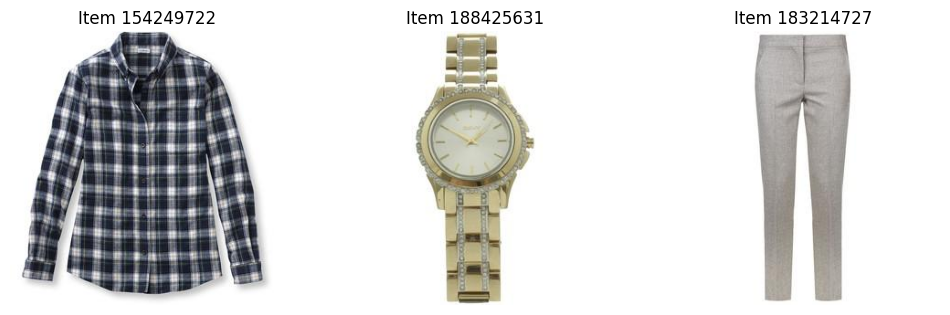

  Outfit 217602530:
    - Item 201813350:  (Category: bags)
    - Item 195213892: Vetements Black Reflector-Heel Boots (Category: shoes)
    - Item 169020872:  (Category: hats)
    - Item 194628844:  (Category: accessories)
    - Item 196672591:  (Category: all-body)
    - Item 185367365:  (Category: outerwear)


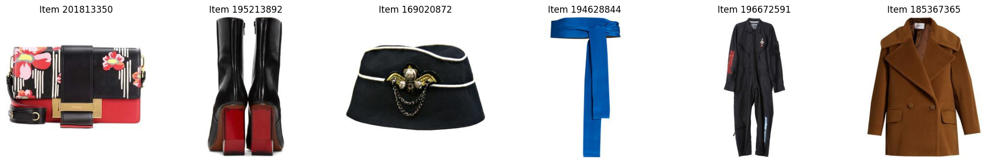

  Outfit 221884093:
    - Item 201799451:  (Category: bags)
    - Item 194990026: RED Valentino Leather Studded Sneakers (Category: shoes)
    - Item 203786992: Opening Ceremony slogan trim sweatshirt (Category: tops)


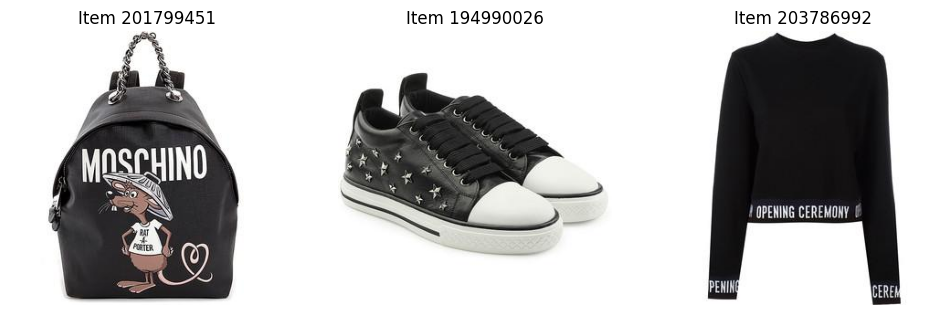


Visualizando temas en el nivel 2:


In [24]:
# Celda 2.2: Visualizar los temas con imágenes de los outfits

import os
import pickle
import matplotlib.pyplot as plt
from PIL import Image

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"
POLYVORE_IMAGE_PATH = f"{POLYVORE_DIR}/images/{{item_id}}.jpg"

# Verificar y cargar las variables necesarias para la visualización
required_files = ['outfit_groups.pkl', 'set_data.pkl', 'topic_levels.pkl', 'metadata.pkl']
for file_name in required_files:
    file_path = os.path.join(OUTPUT_DIR, file_name)
    if not os.path.exists(file_path):
        raise FileNotFoundError(f"El archivo {file_path} no existe. Asegúrate de ejecutar la Celda 2.1 primero.")

with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'rb') as f:
    outfit_groups = pickle.load(f)
print("outfit_groups cargado correctamente.")

with open(os.path.join(OUTPUT_DIR, 'set_data.pkl'), 'rb') as f:
    set_data = pickle.load(f)
print("set_data cargado correctamente.")

with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)
print("topic_levels cargado correctamente.")

with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
print("metadata cargado correctamente.")

# Cargar el modelo hLDA para acceder a get_topic_words
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
print("Modelo hLDA cargado correctamente para visualización.")

def load_image(item_id):
    """Carga una imagen desde el directorio de imágenes de Polyvore."""
    image_path = POLYVORE_IMAGE_PATH.format(item_id=item_id)
    try:
        image = Image.open(image_path).convert('RGB')
        return image
    except Exception as e:
        print(f"Error loading image for item {item_id}: {e}")
        return None

def visualize_clusters(outfit_groups, topic_levels, set_data, metadata, num_outfits_per_topic=3):
    """Visualiza los outfits dentro de algunos temas seleccionados con imágenes."""
    # Encontrar los temas con outfits asignados
    topics_with_outfits = [(topic_id, level) for topic_id, level in topic_levels.items() if outfit_groups.get(topic_id)]
    
    # Agrupar por nivel para visualizar temas de todos los niveles
    for level in range(1, max(topic_levels.values()) + 1):
        print(f"\nVisualizando temas en el nivel {level}:")
        topics_at_level = [topic_id for topic_id, lvl in topics_with_outfits if lvl == level]
        
        for topic_id in topics_at_level[:3]:  # Limitamos a 3 temas por nivel
            print(f"\nTema {topic_id}:")
            words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
            print(f"Palabras principales: {words}")
            
            assigned_outfits = outfit_groups.get(topic_id, [])
            print(f"Total de outfits: {len(assigned_outfits)}")
            
            for outfit_id in assigned_outfits[:num_outfits_per_topic]:
                item_ids = set_data[outfit_id]
                print(f"  Outfit {outfit_id}:")
                for item_id in item_ids:
                    item_meta = metadata[str(item_id)]
                    description = item_meta.get('title', item_meta.get('url_name', ''))
                    category = item_meta.get('semantic_category', 'unknown')
                    print(f"    - Item {item_id}: {description} (Category: {category})")
                
                # Visualizar imágenes
                fig, axes = plt.subplots(1, len(item_ids), figsize=(len(item_ids) * 4, 4))
                if len(item_ids) == 1:
                    axes = [axes]  # Asegurar que axes sea iterable
                for idx, (item_id, ax) in enumerate(zip(item_ids, axes)):
                    image = load_image(item_id)
                    if image is not None:
                        ax.imshow(image)
                        ax.set_title(f"Item {item_id}")
                    else:
                        ax.text(0.5, 0.5, "Image not available", ha='center', va='center')
                    ax.axis('off')
                plt.show()

# ------------------------------
# Section 3: Main Execution (Visualization)
# ------------------------------

def main():
    visualize_clusters(outfit_groups, topic_levels, set_data, metadata, num_outfits_per_topic=3)

if __name__ == "__main__":
    main()

In [27]:
# Celda: Análisis de los temas generados por hLDA y asignación de outfits

import os
import pickle
from collections import defaultdict

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Cargar las variables necesarias para el análisis
with open(os.path.join(OUTPUT_DIR, 'outfit_groups.pkl'), 'rb') as f:
    outfit_groups = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'rb') as f:
    actual_levels = pickle.load(f)

# Cargar el modelo hLDA para acceder a get_topic_words
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))

# Análisis de niveles y temas
print(f"\nTotal de niveles generados por hLDA: {actual_levels}")

# Contar temas por nivel y outfits asignados
themes_per_level = defaultdict(list)
for topic_id, level in topic_levels.items():
    num_outfits = len(outfit_groups.get(topic_id, []))
    themes_per_level[level].append((topic_id, num_outfits))

# Mostrar estadísticas por nivel
for level in range(1, actual_levels + 1):
    themes = themes_per_level[level]
    print(f"\nNivel {level}:")
    print(f"  Número de temas: {len(themes)}")
    for topic_id, num_outfits in themes:
        words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
        print(f"    Tema {topic_id}: {num_outfits} outfits asignados - Palabras principales: {words}")


Total de niveles generados por hLDA: 2

Nivel 1:
  Número de temas: 1
    Tema 0: 68306 outfits asignados - Palabras principales: ['skirt', 'shirt', 'top', 'short', 'jean']

Nivel 2:
  Número de temas: 1384
    Tema 8: 0 outfits asignados - Palabras principales: ['billabong', 'sandal', 'bikini', 'shoreline', 'trip']
    Tema 9: 0 outfits asignados - Palabras principales: ['boot', 'jean', 'vest', 'sorel', 'sweater']
    Tema 10: 0 outfits asignados - Palabras principales: ['brock', 'jean', 'zaful', 'pu', 'free']
    Tema 11: 0 outfits asignados - Palabras principales: ['christian', 'louboutin', 'sandal', 'lhuillier', 'monique']
    Tema 12: 0 outfits asignados - Palabras principales: ['monki', 'asos', 'skirt', 'flat', 'sweater']
    Tema 13: 0 outfits asignados - Palabras principales: ['hollister', 'short', 'shortshorts', 'co', 'denim']
    Tema 14: 0 outfits asignados - Palabras principales: ['mickey', 'mouse', 'disney', 'moa', 'minnie']
    Tema 15: 0 outfits asignados - Palabras pri

In [ ]:
# Celda 1: Reentrenar hLDA con hiperparámetros ajustados

import os
import json
import numpy as np
from tqdm import tqdm
import warnings
import tomotopy as tp
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict
import pickle

# Download required NLTK data
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)

# Define paths
POLYVORE_DIR = './datasets/polyvore'
POLYVORE_SET_DATA_PATH = f"{POLYVORE_DIR}/{{dataset_type}}/{{dataset_split}}.json"
POLYVORE_METADATA_PATH = f"{POLYVORE_DIR}/item_metadata.json"
OUTPUT_DIR = "hlda_outfit_groups"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Configure stopwords
stop_words = set(stopwords.words('english'))
generic_words = {'womens', 'mens', 'fashion', 'style', 'new', 'brand'}

# ------------------------------
# Section 1: Data Loading and Preprocessing
# ------------------------------

def load_set_data(dataset_dir, dataset_type, dataset_split):
    """Load set data from JSON files."""
    with open(
        POLYVORE_SET_DATA_PATH.format(
            dataset_dir=dataset_dir,
            dataset_type=dataset_type,
            dataset_split=dataset_split
        ), 'r'
    ) as f:
        data = json.load(f)
    return data

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH.format(dataset_dir=dataset_dir), 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            metadata[str(item['item_id'])] = item
    return metadata

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'] * 2)  # Duplicar para darle más peso
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and token not in generic_words and len(token) > 1]
    return tokens

def prepare_outfit_texts(dataset_dir, dataset_type, splits):
    """Prepare text data for outfits from multiple splits of the Polyvore dataset."""
    metadata = load_metadata(dataset_dir)
    item_to_outfits = defaultdict(list)
    outfit_ids = []
    docs = []
    
    for split in splits:
        set_data = load_set_data(dataset_dir, dataset_type, split)
        for outfit in tqdm(set_data, desc=f"Processing {split} outfits", disable=True):
            set_id = outfit['set_id']
            item_ids = outfit['item_ids']
            
            outfit_text = []
            for item_id in item_ids:
                item_id_str = str(item_id)
                item_to_outfits[item_id_str].append(set_id)
                if item_id_str in metadata:
                    item_meta = metadata[item_id_str]
                    text = combine_text_fields(item_meta)
                    if text:
                        outfit_text.append(text)
            
            if not outfit_text:
                continue
            
            combined_text = ' '.join(outfit_text)
            tokens = preprocess_text(combined_text)
            
            if not tokens:
                continue
            
            docs.append(tokens)
            outfit_ids.append(set_id)
    
    print(f"Se procesaron {len(outfit_ids)} outfits con texto válido")
    return outfit_ids, docs, metadata, item_to_outfits

# ------------------------------
# Section 2: Train hLDA Model
# ------------------------------

def train_hlda(docs):
    """Train Hierarchical LDA on the preprocessed outfit texts."""
    if not docs:
        raise ValueError("No valid documents to train hLDA. Check data preprocessing.")
    
    mdl = tp.HLDAModel(
        tw=tp.TermWeight.IDF,
        alpha=2.0,  # Aumentado para distribuir mejor entre temas
        gamma=20.0,  # Aumentado para fomentar asignaciones a niveles inferiores
        seed=42
    )
    
    for doc in docs:
        mdl.add_doc(doc)
    
    mdl.burn_in = 100
    print(f"Num docs: {len(mdl.docs)} Vocab size: {len(mdl.vocabs)}")
    
    for i in range(0, 1000, 10):  # Más iteraciones para mejor convergencia
        mdl.train(10)
        print(f"Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}")
    
    topic_levels = {}
    for topic_id in range(mdl.k):
        if mdl.is_live_topic(topic_id):
            level = mdl.level(topic_id) + 1
            topic_levels[topic_id] = level
    
    actual_levels = max(topic_levels.values()) if topic_levels else 1
    print(f"Niveles generados por hLDA: {actual_levels}")
    
    for level in range(1, actual_levels + 1):
        print(f"Temas en nivel {level}:")
        for topic_id, topic_level in topic_levels.items():
            if topic_level == level:
                words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
                print(f"Tema {topic_id}: {words}")
    
    return mdl, actual_levels, topic_levels

# ------------------------------
# Section 3: Main Execution (Training)
# ------------------------------

def main():
    # Prepare outfit texts from train, valid, and test splits
    outfit_ids, docs, metadata, item_to_outfits = prepare_outfit_texts(
        dataset_dir=POLYVORE_DIR,
        dataset_type='nondisjoint',
        splits=['train', 'valid', 'test']
    )
    
    # Train hLDA
    mdl, actual_levels, topic_levels = train_hlda(docs)
    
    # Save the trained model and related data
    mdl.save(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
    with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'wb') as f:
        pickle.dump(outfit_ids, f)
    with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'wb') as f:
        pickle.dump(docs, f)
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'wb') as f:
        pickle.dump(metadata, f)
    with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'wb') as f:
        pickle.dump(item_to_outfits, f)
    with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'wb') as f:
        pickle.dump(actual_levels, f)
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'wb') as f:
        pickle.dump(topic_levels, f)
    
    print(f"Saved trained model and data to {OUTPUT_DIR}")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Se procesaron 68306 outfits con texto válido


In [1]:
# Celda: Análisis de prendas con category_id = 11 dentro de semantic_category = "tops" (con inspección completa)

import os
import pickle
import tomotopy as tp
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Cargar el modelo hLDA y los metadatos
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)

# Configurar stopwords y palabras genéricas
stop_words = set(stopwords.words('english'))
generic_words = {'womens', 'mens', 'fashion', 'style', 'new', 'brand'}

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'] * 2)  # Duplicar para darle más peso
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and token not in generic_words and len(token) > 1]
    return tokens

# Filtrar prendas de semantic_category = "tops"
tops_items = [(item_id, item_meta) for item_id, item_meta in metadata.items() 
              if item_meta.get('semantic_category') == 'tops']

print(f"Total de prendas en la subcategoría 'tops': {len(tops_items)}")

# Agrupar por category_id dentro de "tops"
category_id_counts = defaultdict(int)
for _, item_meta in tops_items:
    category_id = item_meta.get('category_id', 'unknown')
    category_id_counts[category_id] += 1

# Mostrar los category_id disponibles y su cantidad de prendas
print("\nCategory_id disponibles dentro de 'tops':")
for category_id, count in sorted(category_id_counts.items(), key=lambda x: x[1], reverse=True):
    print(f"  Category_id {category_id}: {count} prendas")

# Seleccionar un category_id válido (category_id = 11)
selected_category_id = 11
print(f"\nSeleccionado category_id: {selected_category_id} con {category_id_counts.get(selected_category_id, 0)} prendas")

# Filtrar prendas de ese category_id
selected_items = [(item_id, item_meta) for item_id, item_meta in tops_items 
                  if item_meta.get('category_id') == selected_category_id]

print(f"Total de prendas en category_id {selected_category_id}: {len(selected_items)}")

# Inspeccionar el número total de temas en el modelo
print(f"\nNúmero total de temas en el modelo (mdl.k): {mdl.k}")

# Procesar las descripciones de las prendas e inferir temas
items_with_topics = []
for item_id, item_meta in selected_items[:10]:  # Limitar a 10 para no saturar
    text = combine_text_fields(item_meta)
    tokens = preprocess_text(text)
    
    # Depuración: Mostrar el texto original y los tokens generados
    print(f"\nItem {item_id}:")
    print(f"  Texto original: {text}")
    print(f"  Tokens generados: {tokens}")
    
    if not tokens:
        print("  (Descartado: No hay tokens válidos)")
        continue
    
    # Crear un nuevo documento para inferencia
    doc = mdl.make_doc(tokens)
    
    # Inferir la distribución de temas
    topic_dist, ll = mdl.infer(doc, iter=100)  # Aumentar iteraciones para mejor inferencia
    
    # Depuración: Mostrar información sobre topic_dist
    print(f"  Longitud de topic_dist: {len(topic_dist)}")
    print(f"  Log-likelihood: {ll}")
    
    # Mostrar la distribución de probabilidades para todos los temas
    print("  Distribución de probabilidades (todos los temas con prob > 0):")
    all_topics = [(topic_id, prob) for topic_id, prob in enumerate(topic_dist) 
                  if prob > 0.0 and topic_id in topic_levels]
    for topic_id, prob in sorted(all_topics, key=lambda x: x[1], reverse=True)[:5]:
        level = topic_levels[topic_id]
        words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
        print(f"    Tema {topic_id} (Nivel {level}, Probabilidad: {prob:.4f}): {words}")
    
    # Filtrar temas del nivel 2 y tomar el más probable
    level_2_topics = [(topic_id, prob) for topic_id, prob in enumerate(topic_dist) 
                      if topic_id in topic_levels and topic_levels[topic_id] == 2 and prob > 0.0]
    
    # Ordenar por probabilidad y tomar el tema más probable del nivel 2
    if level_2_topics:
        level_2_topics = sorted(level_2_topics, key=lambda x: x[1], reverse=True)
        most_likely_topic = level_2_topics[0]  # (topic_id, prob)
        
        # Obtener las palabras principales del tema
        topic_words = [word for word, _ in mdl.get_topic_words(most_likely_topic[0], top_n=5)]
        
        items_with_topics.append({
            'item_id': item_id,
            'description': item_meta.get('title', item_meta.get('url_name', '')),
            'topic_id': most_likely_topic[0],
            'probability': most_likely_topic[1],
            'topic_words': topic_words
        })
    else:
        print("  (No se encontraron temas del nivel 2 con probabilidad > 0)")

# Mostrar los resultados
print(f"\nPrendas de semantic_category 'tops' y category_id {selected_category_id} con su tema más probable (nivel 2):")
for item in items_with_topics:
    print(f"\nItem {item['item_id']}: {item['description']}")
    print(f"  Tema más probable: Tema {item['topic_id']} (Probabilidad: {item['probability']:.4f})")
    print(f"  Palabras principales del tema: {item['topic_words']}")

Total de prendas en la subcategoría 'tops': 32998

Category_id disponibles dentro de 'tops':
  Category_id 11: 9149 prendas
  Category_id 19: 5750 prendas
  Category_id 17: 4956 prendas
  Category_id 21: 4893 prendas
  Category_id 104: 3233 prendas
  Category_id 4495: 1270 prendas
  Category_id 26: 756 prendas
  Category_id 4496: 722 prendas
  Category_id 4517: 400 prendas
  Category_id 15: 386 prendas
  Category_id 315: 361 prendas
  Category_id 257: 357 prendas
  Category_id 275: 148 prendas
  Category_id 250: 135 prendas
  Category_id 309: 129 prendas
  Category_id 4454: 102 prendas
  Category_id 252: 98 prendas
  Category_id 256: 63 prendas
  Category_id 273: 25 prendas
  Category_id 341: 17 prendas
  Category_id 272: 14 prendas
  Category_id 343: 12 prendas
  Category_id 342: 11 prendas
  Category_id 286: 6 prendas
  Category_id 289: 5 prendas

Seleccionado category_id: 11 con 9149 prendas
Total de prendas en category_id 11: 9149

Número total de temas en el modelo (mdl.k): 1392



## Volvemos a probar a entrenar hLDA

In [ ]:
# Celda 1: Reentrenar hLDA con hiperparámetros ajustados

import os
import json
import numpy as np
from tqdm import tqdm
import warnings
import tomotopy as tp
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict
import pickle

# Download required NLTK data
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)
nltk.download('wordnet', quiet=True)

# Define paths
POLYVORE_DIR = './datasets/polyvore'
POLYVORE_SET_DATA_PATH = f"{POLYVORE_DIR}/{{dataset_type}}/{{dataset_split}}.json"
POLYVORE_METADATA_PATH = f"{POLYVORE_DIR}/item_metadata.json"
OUTPUT_DIR = "hlda_outfit_groups"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Configure stopwords
stop_words = set(stopwords.words('english'))
# Aumentar las palabras genéricas eliminadas para mejorar la diversidad textual
generic_words = {'womens', 'mens', 'fashion', 'style', 'new', 'brand', 'top', 'shirt', 'skirt', 'short', 'jean', 'clothing', 'tops'}

# ------------------------------
# Section 1: Data Loading and Preprocessing
# ------------------------------

def load_set_data(dataset_dir, dataset_type, dataset_split):
    """Load set data from JSON files."""
    with open(
        POLYVORE_SET_DATA_PATH.format(
            dataset_dir=dataset_dir,
            dataset_type=dataset_type,
            dataset_split=dataset_split
        ), 'r'
    ) as f:
        data = json.load(f)
    return data

def load_metadata(dataset_dir):
    """Load item metadata from item_metadata.json."""
    metadata = {}
    with open(POLYVORE_METADATA_PATH.format(dataset_dir=dataset_dir), 'r') as f:
        metadata_ = json.load(f)
        for item in metadata_:
            metadata[str(item['item_id'])] = item
    return metadata

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'] * 2)  # Duplicar para darle más peso
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and token not in generic_words and len(token) > 1]
    return tokens

def prepare_outfit_texts(dataset_dir, dataset_type, splits):
    """Prepare text data for outfits from multiple splits of the Polyvore dataset."""
    metadata = load_metadata(dataset_dir)
    item_to_outfits = defaultdict(list)
    outfit_ids = []
    docs = []
    
    for split in splits:
        set_data = load_set_data(dataset_dir, dataset_type, split)
        for outfit in tqdm(set_data, desc=f"Processing {split} outfits", disable=True):
            set_id = outfit['set_id']
            item_ids = outfit['item_ids']
            
            outfit_text = []
            for item_id in item_ids:
                item_id_str = str(item_id)
                item_to_outfits[item_id_str].append(set_id)
                if item_id_str in metadata:
                    item_meta = metadata[item_id_str]
                    text = combine_text_fields(item_meta)
                    if text:
                        outfit_text.append(text)
            
            if not outfit_text:
                continue
            
            combined_text = ' '.join(outfit_text)
            tokens = preprocess_text(combined_text)
            
            if not tokens:
                continue
            
            docs.append(tokens)
            outfit_ids.append(set_id)
    
    print(f"Se procesaron {len(outfit_ids)} outfits con texto válido")
    return outfit_ids, docs, metadata, item_to_outfits

# ------------------------------
# Section 2: Train hLDA Model
# ------------------------------

def train_hlda(docs):
    """Train Hierarchical LDA on the preprocessed outfit texts."""
    if not docs:
        raise ValueError("No valid documents to train hLDA. Check data preprocessing.")
    
    mdl = tp.HLDAModel(
        tw=tp.TermWeight.IDF,
        alpha=5.0,  # Aumentado aún más para distribuir mejor entre temas
        gamma=50.0,  # Aumentado aún más para fomentar asignaciones a niveles inferiores
        seed=42
    )
    
    for doc in docs:
        mdl.add_doc(doc)
    
    mdl.burn_in = 100
    print(f"Num docs: {len(mdl.docs)} Vocab size: {len(mdl.vocabs)}")
    
    for i in range(0, 2000, 10):  # Más iteraciones para mejor convergencia
        mdl.train(10)
        print(f"Iteration: {i}\tLog-likelihood: {mdl.ll_per_word}")
    
    topic_levels = {}
    for topic_id in range(mdl.k):
        if mdl.is_live_topic(topic_id):
            level = mdl.level(topic_id) + 1
            topic_levels[topic_id] = level
    
    actual_levels = max(topic_levels.values()) if topic_levels else 1
    print(f"Niveles generados por hLDA: {actual_levels}")
    
    for level in range(1, actual_levels + 1):
        print(f"Temas en nivel {level}:")
        themes_per_level = defaultdict(list)
        for topic_id, topic_level in topic_levels.items():
            if topic_level == level:
                words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
                print(f"  Tema {topic_id}: {words}")
    
    return mdl, actual_levels, topic_levels

# ------------------------------
# Section 3: Main Execution (Training)
# ------------------------------

def main():
    # Prepare outfit texts from train, valid, and test splits
    outfit_ids, docs, metadata, item_to_outfits = prepare_outfit_texts(
        dataset_dir=POLYVORE_DIR,
        dataset_type='nondisjoint',
        splits=['train', 'valid', 'test']
    )
    
    # Train hLDA
    mdl, actual_levels, topic_levels = train_hlda(docs)
    
    # Save the trained model and related data
    mdl.save(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
    with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'wb') as f:
        pickle.dump(outfit_ids, f)
    with open(os.path.join(OUTPUT_DIR, 'docs.pkl'), 'wb') as f:
        pickle.dump(docs, f)
    with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'wb') as f:
        pickle.dump(metadata, f)
    with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'wb') as f:
        pickle.dump(item_to_outfits, f)
    with open(os.path.join(OUTPUT_DIR, 'actual_levels.pkl'), 'wb') as f:
        pickle.dump(actual_levels, f)
    with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'wb') as f:
        pickle.dump(topic_levels, f)
    
    print(f"Saved trained model and data to {OUTPUT_DIR}")

if __name__ == "__main__":
    warnings.filterwarnings("ignore", message=".*likelihood is decreasing.*")
    main()

Se procesaron 68306 outfits con texto válido


In [ ]:
# Celda: Inferir temas a nivel de outfits y asignar a prendas

import os
import pickle
import tomotopy as tp
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import string
from collections import defaultdict

# Define paths
OUTPUT_DIR = "hlda_outfit_groups"

# Cargar el modelo hLDA y los datos necesarios
mdl = tp.HLDAModel.load(os.path.join(OUTPUT_DIR, 'hlda_model.bin'))
with open(os.path.join(OUTPUT_DIR, 'metadata.pkl'), 'rb') as f:
    metadata = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'topic_levels.pkl'), 'rb') as f:
    topic_levels = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'set_data.pkl'), 'rb') as f:
    set_data = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'outfit_ids.pkl'), 'rb') as f:
    outfit_ids = pickle.load(f)
with open(os.path.join(OUTPUT_DIR, 'item_to_outfits.pkl'), 'rb') as f:
    item_to_outfits = pickle.load(f)

# Configurar stopwords y palabras genéricas
stop_words = set(stopwords.words('english'))
generic_words = {'womens', 'mens', 'fashion', 'style', 'new', 'brand', 'top', 'shirt', 'skirt', 'short', 'jean', 'clothing', 'tops'}

def combine_text_fields(item):
    """Combina todos los campos textuales de una prenda en un solo texto."""
    text_fields = []
    
    if 'description' in item and item['description']:
        text_fields.append(item['description'] * 2)
    if 'related' in item and item['related']:
        if isinstance(item['related'], list):
            text_fields.append(' '.join(item['related']))
        else:
            text_fields.append(item['related'])
    if 'url_name' in item and item['url_name']:
        text_fields.append(item['url_name'])
    if 'title' in item and item['title']:
        text_fields.append(item['title'])
    if 'catgeories' in item and item['catgeories']:
        if isinstance(item['catgeories'], list):
            text_fields.append(' '.join(item['catgeories']))
        else:
            text_fields.append(item['catgeories'])
    if 'semantic_category' in item and item['semantic_category']:
        text_fields.append(item['semantic_category'])
    
    return ' '.join(text_fields)

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, limpia y quita stopwords."""
    lemmatizer = WordNetLemmatizer()
    text = text.translate(str.maketrans("", "", string.punctuation))
    text = text.lower()
    tokens = word_tokenize(text)
    tokens = [lemmatizer.lemmatize(token) for token in tokens 
              if token not in stop_words and token not in generic_words and len(token) > 1]
    return tokens

# Crear un diccionario para mapear outfits a sus temas
outfit_to_topic = {}

# Inferir temas para cada outfit
for outfit_id in outfit_ids:  # Procesar todos los outfits
    item_ids = set_data[outfit_id]
    
    # Combinar el texto de todas las prendas del outfit
    outfit_text = []
    for item_id in item_ids:
        item_id_str = str(item_id)
        if item_id_str in metadata:
            item_meta = metadata[item_id_str]
            text = combine_text_fields(item_meta)
            if text:
                outfit_text.append(text)
    
    if not outfit_text:
        continue
    
    combined_text = ' '.join(outfit_text)
    tokens = preprocess_text(combined_text)
    
    if not tokens:
        continue
    
    # Crear un nuevo documento para inferencia
    doc = mdl.make_doc(tokens)
    
    # Inferir la distribución de temas
    topic_dist, ll = mdl.infer(doc, iter=100)
    
    # Filtrar temas del nivel 2 y tomar el más probable
    level_2_topics = [(topic_id, prob) for topic_id, prob in enumerate(topic_dist) 
                      if topic_id in topic_levels and topic_levels[topic_id] == 2 and prob > 0.0]
    
    if level_2_topics:
        level_2_topics = sorted(level_2_topics, key=lambda x: x[1], reverse=True)
        most_likely_topic = level_2_topics[0]  # (topic_id, prob)
        outfit_to_topic[outfit_id] = most_likely_topic
    else:
        outfit_to_topic[outfit_id] = None

# Filtrar prendas de semantic_category = "tops" y category_id = 11
tops_items = [(item_id, item_meta) for item_id, item_meta in metadata.items() 
              if item_meta.get('semantic_category') == 'tops' and item_meta.get('category_id') == 11]

print(f"Total de prendas en semantic_category 'tops' y category_id 11: {len(tops_items)}")

# Asignar temas a las prendas basándose en los temas de los outfits
items_with_topics = []
for item_id, item_meta in tops_items[:10]:  # Limitar a 10 para no saturar
    item_id_str = str(item_id)
    # Buscar un outfit que contenga esta prenda
    found = False
    for outfit_id in item_to_outfits[item_id_str]:
        if outfit_id in outfit_to_topic and outfit_to_topic[outfit_id]:
            topic_id, prob = outfit_to_topic[outfit_id]
            topic_words = [word for word, _ in mdl.get_topic_words(topic_id, top_n=5)]
            items_with_topics.append({
                'item_id': item_id,
                'description': item_meta.get('title', item_meta.get('url_name', '')),
                'topic_id': topic_id,
                'probability': prob,
                'topic_words': topic_words
            })
            found = True
            break
    
    if not found:
        print(f"Item {item_id}: No se encontró un outfit con tema asignado")

# Mostrar los resultados
print(f"\nPrendas de semantic_category 'tops' y category_id 11 con su tema más probable (nivel 2):")
for item in items_with_topics:
    print(f"\nItem {item['item_id']}: {item['description']}")
    print(f"  Tema más probable: Tema {item['topic_id']} (Probabilidad: {item['probability']:.4f})")
    print(f"  Palabras principales del tema: {item['topic_words']}")

## Probamos a empezar de 0

In [2]:
import os
import json
import pickle
import pandas as pd
import numpy as np
from collections import defaultdict
import tomotopy as tp
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk
import string

# Descargar recursos de NLTK (ejecutar una vez)
nltk.download('punkt')
nltk.download('stopwords')

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
TRAIN_PATH = "datasets/polyvore/nondisjoint/train.json"
OUTPUT_DIR = "hlda_clusters"  # Carpeta para guardar los clusters
MIN_DF = 5  # Frecuencia mínima de palabras
MAX_DF = 0.8  # Frecuencia máxima de palabras

def load_metadata():
    """Carga los metadatos de las prendas."""
    with open(METADATA_PATH, 'r') as f:
        metadata = json.load(f)
    metadata_dict = {str(item['item_id']): item for item in metadata}
    print(f"Cargados {len(metadata_dict)} metadatos de prendas")
    return metadata_dict

def load_outfits():
    """Carga los outfits de train.json."""
    with open(TRAIN_PATH, 'r') as f:
        outfits = json.load(f)
    print(f"Cargados {len(outfits)} outfits")
    return outfits

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, elimina stop words y puntuación."""
    stop_words = set(stopwords.words('english') + list(string.punctuation))
    tokens = word_tokenize(text.lower())
    tokens = [t for t in tokens if t not in stop_words and t.isalnum()]
    return tokens

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)

def prepare_corpus(outfits, metadata):
    """Prepara el corpus para hLDA: documentos (outfits) y diccionario."""
    documents = []
    item_to_outfits = defaultdict(list)  # Mapa de item_id a outfits donde aparece
    
    for outfit in outfits:
        item_ids = [str(item_id) for item_id in outfit['item_ids']]
        # Filtrar prendas con metadatos válidos
        valid_items = [item_id for item_id in item_ids if item_id in metadata]
        if not valid_items:
            continue
        # Concatenar descripciones de todas las prendas del outfit
        outfit_text = ' '.join(get_item_description(metadata[item_id]) for item_id in valid_items)
        tokens = preprocess_text(outfit_text)
        if tokens:
            documents.append(tokens)
            # Registrar en qué outfits aparece cada prenda
            for item_id in valid_items:
                item_to_outfits[item_id].append(len(documents) - 1)
    
    print(f"Preparados {len(documents)} documentos válidos")
    return documents, item_to_outfits

def train_hlda(documents, num_levels=3, num_topics_per_level=10):
    """Entrena un modelo hLDA con los documentos."""
    # Crear el modelo hLDA
    mdl = tp.HLDAModel(depth=num_levels, seed=42)
    
    # Añadir documentos al modelo
    for doc in documents:
        mdl.add_doc(doc)
    
    # Entrenar el modelo
    mdl.burn_in = 100
    mdl.train(0)
    print(f"Vocabulario: {len(mdl.vocabs)} palabras")
    
    for i in range(0, 500, 10):
        mdl.train(10)
        print(f"Iteración {i}, LL: {mdl.ll_per_word:.4f}")
    
    return mdl

def assign_clusters(mdl, documents, item_to_outfits, metadata):
    """Asigna clusters a cada prenda basándose en los temas de hLDA."""
    # Obtener distribución de temas por documento
    doc_topic_dists = [mdl.infer(tp.Document(doc))[0] for doc in documents]
    
    # Calcular probabilidad de cada prenda en cada tema
    item_topic_probs = defaultdict(lambda: np.zeros(mdl.k))
    for item_id, doc_indices in item_to_outfits.items():
        for doc_idx in doc_indices:
            item_topic_probs[item_id] += doc_topic_dists[doc_idx]
        # Normalizar probabilidades
        total = np.sum(item_topic_probs[item_id])
        if total > 0:
            item_topic_probs[item_id] /= total
    
    # Organizar por semantic_category y category_id
    clusters_by_category = defaultdict(list)
    for item_id, probs in item_topic_probs.items():
        if item_id not in metadata:
            continue
        semantic_cat = metadata[item_id].get('semantic_category', 'unknown')
        category_id = metadata[item_id].get('category_id', 'unknown')
        cluster = np.argmax(probs)  # Asignar al tema con mayor probabilidad
        clusters_by_category[(semantic_cat, category_id)].append({
            'item_id': item_id,
            'cluster': cluster,
            'probs': probs.tolist()
        })
    
    # Guardar resultados
    os.makedirs(OUTPUT_DIR, exist_ok=True)
    for (semantic_cat, category_id), items in clusters_by_category.items():
        output_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        os.makedirs(output_dir, exist_ok=True)
        df = pd.DataFrame(items)
        output_file = os.path.join(output_dir, f'cat{category_id}_hlda_clusters.csv')
        df.to_csv(output_file, index=False)
        print(f"Guardados clusters para {semantic_cat}/cat{category_id} en {output_file}")


# Cargar datos
metadata = load_metadata()
outfits = load_outfits()

# Preparar corpus
documents, item_to_outfits = prepare_corpus(outfits, metadata)

# Entrenar hLDA
print("Entrenando modelo hLDA...")
mdl = train_hlda(documents, num_levels=3, num_topics_per_level=10)



[nltk_data] Downloading package punkt to /Users/lara/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/lara/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Cargados 251008 metadatos de prendas
Cargados 53306 outfits
Preparados 53306 documentos válidos
Entrenando modelo hLDA...


/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_27166/11063048.py:92: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(0)
/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_27166/11063048.py:96: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(10)


Vocabulario: 58606 palabras
Iteración 0, LL: -8.2376
Iteración 10, LL: -7.9006
Iteración 20, LL: -7.8167
Iteración 30, LL: -7.7586
Iteración 40, LL: -7.7336
Iteración 50, LL: -7.7169
Iteración 60, LL: -7.7052
Iteración 70, LL: -7.6969
Iteración 80, LL: -7.6903
Iteración 90, LL: -7.6845
Iteración 100, LL: -7.6752
Iteración 110, LL: -7.6826
Iteración 120, LL: -7.6843
Iteración 130, LL: -7.6823
Iteración 140, LL: -7.6791
Iteración 150, LL: -7.6779
Iteración 160, LL: -7.6777
Iteración 170, LL: -7.6776
Iteración 180, LL: -7.6768
Iteración 190, LL: -7.6764
Iteración 200, LL: -7.6744
Iteración 210, LL: -7.6735
Iteración 220, LL: -7.6723
Iteración 230, LL: -7.6707
Iteración 240, LL: -7.6687
Iteración 250, LL: -7.6686
Iteración 260, LL: -7.6680
Iteración 270, LL: -7.6676
Iteración 280, LL: -7.6667
Iteración 290, LL: -7.6652
Iteración 300, LL: -7.6647
Iteración 310, LL: -7.6633
Iteración 320, LL: -7.6617
Iteración 330, LL: -7.6602
Iteración 340, LL: -7.6595
Iteración 350, LL: -7.6576
Iteración 3

In [3]:

# Asignar clusters
print("Asignando clusters a prendas...")
assign_clusters(mdl, documents, item_to_outfits, metadata)

: 

### Repetimos guardando el entrenamiento apra q no pete el kernel

In [2]:
import os
import json
import pickle
import pandas as pd
import numpy as np
from collections import defaultdict
import tomotopy as tp
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import nltk
import string
from scipy import sparse
import logging
from tqdm import tqdm

# Configurar logging para monitorear el progreso
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Descargar recursos de NLTK (ejecutar una vez)
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
TRAIN_PATH = "datasets/polyvore/nondisjoint/train.json"
OUTPUT_DIR = "hlda_outputs"  # Carpeta para guardar modelo y clusters
MODEL_PATH = os.path.join(OUTPUT_DIR, "hlda_model.bin")
CORPUS_PATH = os.path.join(OUTPUT_DIR, "corpus.pkl")
MIN_DF = 5
MAX_DF = 0.8
BATCH_SIZE = 1000  # Tamaño del lote para inferencia

def load_metadata():
    """Carga los metadatos de las prendas."""
    with open(METADATA_PATH, 'r') as f:
        metadata = json.load(f)
    metadata_dict = {str(item['item_id']): item for item in metadata}
    logging.info(f"Cargados {len(metadata_dict)} metadatos de prendas")
    return metadata_dict

def load_outfits():
    """Carga los outfits de train.json."""
    with open(TRAIN_PATH, 'r') as f:
        outfits = json.load(f)
    logging.info(f"Cargados {len(outfits)} outfits")
    return outfits

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, elimina stop words y puntuación."""
    stop_words = set(stopwords.words('english') + list(string.punctuation))
    tokens = word_tokenize(text.lower())
    tokens = [t for t in tokens if t not in stop_words and t.isalnum()]
    return tokens

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)

def prepare_corpus(outfits, metadata):
    """Prepara el corpus para hLDA: documentos (outfits) y diccionario."""
    documents = []
    item_to_outfits = defaultdict(list)
    
    for outfit in tqdm(outfits, desc="Procesando outfits"):
        item_ids = [str(item_id) for item_id in outfit['item_ids']]
        valid_items = [item_id for item_id in item_ids if item_id in metadata]
        if not valid_items:
            continue
        outfit_text = ' '.join(get_item_description(metadata[item_id]) for item_id in valid_items)
        tokens = preprocess_text(outfit_text)
        if tokens:
            documents.append(tokens)
            for item_id in valid_items:
                item_to_outfits[item_id].append(len(documents) - 1)
    
    logging.info(f"Preparados {len(documents)} documentos válidos")
    return documents, item_to_outfits

def train_hlda(documents, num_levels=3, num_topics_per_level=10):
    """Entrena un modelo hLDA o lo carga si ya existe."""
    os.makedirs(OUTPUT_DIR, exist_ok=True)
    
    if os.path.exists(MODEL_PATH):
        logging.info(f"Cargando modelo hLDA desde {MODEL_PATH}")
        mdl = tp.HLDAModel.load(MODEL_PATH)
        with open(CORPUS_PATH, 'rb') as f:
            saved_corpus = pickle.load(f)
        return mdl, saved_corpus
    
    mdl = tp.HLDAModel(depth=num_levels, seed=42)
    for doc in tqdm(documents, desc="Añadiendo documentos"):
        mdl.add_doc(doc)
    
    mdl.burn_in = 100
    mdl.train(0)
    logging.info(f"Vocabulario: {len(mdl.vocabs)} palabras")
    
    for i in range(0, 1000, 10):
        mdl.train(10)
        logging.info(f"Iteración {i}, LL: {mdl.ll_per_word:.4f}")
    
    # Guardar el modelo
    mdl.save(MODEL_PATH)
    logging.info(f"Modelo guardado en {MODEL_PATH}")
    
    # Guardar el corpus
    with open(CORPUS_PATH, 'wb') as f:
        pickle.dump(documents, f)
    logging.info(f"Corpus guardado en {CORPUS_PATH}")
    
    return mdl, documents

def assign_clusters(mdl, documents, item_to_outfits, metadata):
    """Asigna clusters a cada prenda basándose en los temas de hLDA."""
    # Procesar documentos en lotes para reducir uso de memoria
    doc_topic_dists = []
    for i in tqdm(range(0, len(documents), BATCH_SIZE), desc="Infiriendo temas"):
        batch = documents[i:i + BATCH_SIZE]
        batch_dists = [mdl.infer(tp.Document(doc))[0] for doc in batch]
        doc_topic_dists.extend(batch_dists)
    
    # Usar matriz dispersa para almacenar probabilidades
    num_items = len(item_to_outfits)
    num_topics = mdl.k
    item_topic_probs = sparse.lil_matrix((num_items, num_topics), dtype=np.float32)
    item_ids = list(item_to_outfits.keys())
    
    for idx, item_id in enumerate(tqdm(item_ids, desc="Calculando probabilidades por prenda")):
        doc_indices = item_to_outfits[item_id]
        for doc_idx in doc_indices:
            item_topic_probs[idx] += doc_topic_dists[doc_idx]
        # Normalizar
        total = item_topic_probs[idx].sum()
        if total > 0:
            item_topic_probs[idx] /= total
    
    # Convertir a formato denso para asignaciones
    item_topic_probs = item_topic_probs.toarray()
    
    # Organizar por semantic_category y category_id
    clusters_by_category = defaultdict(list)
    for idx, item_id in enumerate(item_ids):
        if item_id not in metadata:
            continue
        semantic_cat = metadata[item_id].get('semantic_category', 'unknown')
        category_id = metadata[item_id].get('category_id', 'unknown')
        probs = item_topic_probs[idx]
        cluster = np.argmax(probs) if probs.sum() > 0 else -1
        clusters_by_category[(semantic_cat, category_id)].append({
            'item_id': item_id,
            'cluster': cluster,
            'probs': probs.tolist()
        })
    
    # Guardar resultados
    os.makedirs(OUTPUT_DIR, exist_ok=True)
    for (semantic_cat, category_id), items in clusters_by_category.items():
        output_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        os.makedirs(output_dir, exist_ok=True)
        df = pd.DataFrame(items)
        output_file = os.path.join(output_dir, f'cat{category_id}_hlda_clusters.csv')
        df.to_csv(output_file, index=False)
        logging.info(f"Guardados clusters para {semantic_cat}/cat{category_id} en {output_file}")

def inspect_clusters(mdl, metadata, item_to_outfits, top_n_words=10, top_n_items=5):
    """Inspecciona los temas (clusters) mostrando palabras y prendas representativas."""
    logging.info("Inspeccionando clusters...")
    for topic_id in range(mdl.k):
        # Obtener palabras más probables
        words = mdl.get_topic_words(topic_id, top_n=top_n_words)
        logging.info(f"\nCluster {topic_id}:")
        logging.info(f"Palabras más probables: {', '.join(f'{w} ({p:.4f})' for w, p in words)}")
        
        # Encontrar prendas representativas
        item_scores = []
        for item_id, doc_indices in item_to_outfits.items():
            probs = np.zeros(mdl.k)
            for doc_idx in doc_indices:
                doc_probs = mdl.infer(tp.Document(mdl.docs[doc_idx].words))[0]
                probs += doc_probs
            total = probs.sum()
            if total > 0:
                probs /= total
            item_scores.append((item_id, probs[topic_id]))
        
        # Ordenar y seleccionar top N prendas
        item_scores = sorted(item_scores, key=lambda x: x[1], reverse=True)[:top_n_items]
        logging.info("Prendas representativas:")
        for item_id, score in item_scores:
            item = metadata.get(item_id, {})
            description = get_item_description(item)[:50] + "..." if item else "Desconocida"
            logging.info(f" - Prenda {item_id} (score: {score:.4f}): {description}")


In [ ]:


# Cargar datos
metadata = load_metadata()
outfits = load_outfits()

# Preparar corpus
documents, item_to_outfits = prepare_corpus(outfits, metadata)

# Entrenar o cargar hLDA
logging.info("Entrenando o cargando modelo hLDA...")
mdl, documents = train_hlda(documents, num_levels=3, num_topics_per_level=10)


2025-05-26 01:50:52,360 - INFO - Cargados 251008 metadatos de prendas
2025-05-26 01:50:52,570 - INFO - Cargados 53306 outfits
Procesando outfits: 100%|██████████| 53306/53306 [00:22<00:00, 2321.63it/s]
2025-05-26 01:51:15,539 - INFO - Preparados 53306 documentos válidos
2025-05-26 01:51:15,540 - INFO - Entrenando o cargando modelo hLDA...
Añadiendo documentos: 100%|██████████| 53306/53306 [00:00<00:00, 70088.02it/s]
/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_33174/496095991.py:103: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(0)
2025-05-26 01:51:16,798 - INFO - Vocabulario: 58606 palabras
/var/folders/11/8n3x035j1rngnz1l98ysm7vm0000gn/T/ipykernel_33174/496095991.py:107: RuntimeWarning: The training result may differ even with fixed seed if `workers` != 1.
  mdl.train(10)
2025-05-26 01:52:42,225 - INFO - Iteración 0, LL: -8.2376
2025-05-26 01:54:08,006 - INFO - Iteración 10, LL: -7.9006
2025-05-26 01:55:33,935 - INFO 

In [ ]:

# Inspeccionar clusters
inspect_clusters(mdl, metadata, item_to_outfits)

# Asignar clusters
logging.info("Asignando clusters a prendas...")
assign_clusters(mdl, documents, item_to_outfits, metadata)


# HDP

In [4]:
import os
import json
import pickle
import pandas as pd
import numpy as np
from collections import defaultdict
from gensim.models import HdpModel
from gensim.corpora import Dictionary
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
import logging
from tqdm import tqdm
import shutil
import gc

# Configurar logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Descargar recursos de NLTK
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
TRAIN_PATH = "datasets/polyvore/nondisjoint/train.json"
OUTPUT_DIR = "hlda_outputs"
MODEL_PATH = os.path.join(OUTPUT_DIR, "hdp_model.gensim")
CORPUS_PATH = os.path.join(OUTPUT_DIR, "corpus.pkl")
CHECKPOINT_DIR = os.path.join(OUTPUT_DIR, "checkpoints")
MIN_DF = 10  # Frecuencia mínima de palabras
MAX_DF = 0.3  # Frecuencia máxima de palabras
MAX_OUTFITS = 20000  # Máximo número de outfits para pruebas

def check_disk_space(path):
    """Verifica si hay suficiente espacio en disco."""
    dir_path = os.path.dirname(path) or os.getcwd()
    try:
        total, used, free = shutil.disk_usage(dir_path)
        free_gb = free / (2**30)
        logging.info(f"Espacio libre en disco ({dir_path}): {free_gb:.2f} GB")
        if free_gb < 1:
            raise RuntimeError("Espacio en disco insuficiente (< 1 GB).")
    except FileNotFoundError as e:
        logging.error(f"Directorio no encontrado: {dir_path}. Error: {e}")
        raise
    except OSError as e:
        logging.error(f"Error al verificar espacio en disco para {dir_path}: {e}")
        raise

def ensure_writable_dir(directory):
    """Asegura que el directorio sea escribible."""
    try:
        os.makedirs(directory, exist_ok=True)
        if not os.access(directory, os.W_OK):
            raise PermissionError(f"No se tienen permisos de escritura en {directory}")
    except OSError as e:
        logging.error(f"Error al crear/verificar directorio {directory}: {e}")
        raise

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        logging.info(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        logging.error(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        logging.error(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def load_outfits():
    """Carga los outfits de train.json."""
    try:
        with open(TRAIN_PATH, 'r') as f:
            outfits = json.load(f)
        if MAX_OUTFITS:
            outfits = outfits[:MAX_OUTFITS]  # Muestreo para pruebas
        logging.info(f"Cargados {len(outfits)} outfits")
        return outfits
    except FileNotFoundError as e:
        logging.error(f"No se encontró {TRAIN_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        logging.error(f"Error al decodificar {TRAIN_PATH}: {e}")
        raise

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, elimina stop words y puntuación."""
    stop_words = set(stopwords.words('english') + list(string.punctuation))
    tokens = word_tokenize(text.lower())
    tokens = [t for t in tokens if t not in stop_words and t.isalnum() and len(t) > 2]
    return tokens

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)

def prepare_corpus(outfits, metadata):
    """Prepara el corpus para HDP: documentos (outfits) y diccionario."""
    documents = []
    item_to_outfits = defaultdict(list)
    
    for outfit in tqdm(outfits, desc="Procesando outfits"):
        item_ids = [str(item_id) for item_id in outfit['item_ids']]
        valid_items = [item_id for item_id in item_ids if item_id in metadata]
        if not valid_items:
            continue
        outfit_text = ' '.join(get_item_description(metadata[item_id]) for item_id in valid_items)
        tokens = preprocess_text(outfit_text)
        if tokens:
            documents.append(tokens)
            for item_id in valid_items:
                item_to_outfits[item_id].append(len(documents) - 1)
    
    # Crear diccionario y filtrar vocabulario
    dictionary = Dictionary(documents)
    dictionary.filter_extremes(no_below=MIN_DF, no_above=MAX_DF)
    logging.info(f"Vocabulario reducido a {len(dictionary)} palabras")
    
    # Crear corpus (bag-of-words)
    corpus = [dictionary.doc2bow(doc) for doc in documents]
    
    logging.info(f"Preparados {len(documents)} documentos válidos")
    return corpus, dictionary, documents, item_to_outfits

def train_hdp(corpus, dictionary, max_iterations=200):
    """Entrena un modelo HDP o lo carga si ya existe."""
    ensure_writable_dir(OUTPUT_DIR)
    ensure_writable_dir(CHECKPOINT_DIR)
    check_disk_space(MODEL_PATH)
    
    if os.path.exists(MODEL_PATH):
        logging.info(f"Cargando modelo HDP desde {MODEL_PATH}")
        hdp = HdpModel.load(MODEL_PATH)
        with open(CORPUS_PATH, 'rb') as f:
            saved_corpus = pickle.load(f)
        return hdp, saved_corpus
    
    hdp = HdpModel(
        corpus,
        dictionary,
        T=100,
        K=20,
        alpha=1.0,
        gamma=1.0,
        eta=0.5
    )
    
    checkpoint_interval = 50
    for i in tqdm(range(0, max_iterations, 10), desc="Entrenando HDP"):
        hdp.update(corpus)
        logging.info(f"Iteración {i+10} completada")
        
        if (i + 10) % checkpoint_interval == 0:
            checkpoint_path = os.path.join(CHECKPOINT_DIR, f"hdp_checkpoint_iter_{i+10}.gensim")
            try:
                hdp.save(checkpoint_path)
                logging.info(f"Checkpoint guardado en {checkpoint_path}")
            except Exception as e:
                logging.error(f"Error al guardar checkpoint en iteración {i+10}: {e}")
    
    try:
        hdp.save(MODEL_PATH)
        logging.info(f"Modelo final guardado en {MODEL_PATH}")
    except Exception as e:
        logging.error(f"Error al guardar modelo final: {e}")
        raise
    
    with open(CORPUS_PATH, 'wb') as f:
        pickle.dump(corpus, f)
    logging.info(f"Corpus guardado en {CORPUS_PATH}")
    
    return hdp, corpus

def assign_clusters(hdp, corpus, item_to_outfits, metadata, dictionary):
    """Asigna clusters a cada prenda basándose en los temas de HDP."""
    doc_topic_dists = []
    for i in tqdm(range(0, len(corpus), 500), desc="Infiriendo temas"):
        batch = corpus[i:i + 500]
        batch_dists = [hdp[doc] for doc in batch]
        doc_topic_dists.extend(batch_dists)
        del batch_dists
        gc.collect()
    
    num_items = len(item_to_outfits)
    item_ids = list(item_to_outfits.keys())
    item_topic_probs = np.zeros((num_items, hdp.m_T), dtype=np.float32)
    
    for idx, item_id in enumerate(tqdm(item_ids, desc="Calculando probabilidades por prenda")):
        doc_indices = item_to_outfits[item_id]
        for doc_idx in doc_indices:
            for topic_id, prob in doc_topic_dists[doc_idx]:
                item_topic_probs[idx, topic_id] += prob
        total = item_topic_probs[idx].sum()
        if total > 0:
            item_topic_probs[idx] /= total
    
    clusters_by_category = defaultdict(list)
    for idx, item_id in enumerate(item_ids):
        if item_id not in metadata:
            continue
        semantic_cat = metadata[item_id].get('semantic_category', 'unknown')
        category_id = metadata[item_id].get('category_id', 'unknown')
        probs = item_topic_probs[idx]
        cluster = np.argmax(probs) if probs.sum() > 0 else -1
        clusters_by_category[(semantic_cat, category_id)].append({
            'item_id': item_id,
            'cluster': cluster,
            'probs': probs.tolist()
        })
    
    ensure_writable_dir(OUTPUT_DIR)
    for (semantic_cat, category_id), items in clusters_by_category.items():
        output_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        ensure_writable_dir(output_dir)
        df = pd.DataFrame(items)
        output_file = os.path.join(output_dir, f'cat{category_id}_hdp_clusters.csv')
        df.to_csv(output_file, index=False)
        logging.info(f"Guardados clusters para {semantic_cat}/cat{category_id} en {output_file}")

def inspect_clusters(hdp, metadata, item_to_outfits, corpus, dictionary, top_n_words=10, top_n_items=5):
    """Inspecciona los temas (clusters) mostrando palabras y prendas representativas."""
    logging.info("Inspeccionando clusters...")
    for topic_id in range(min(20, hdp.m_T)):
        words = hdp.show_topic(topic_id, topn=top_n_words)
        logging.info(f"\nCluster {topic_id}:")
        logging.info(f"Palabras más probables: {', '.join(f'{w} ({p:.4f})' for w, p in words)}")
        
        item_scores = []
        for item_id, doc_indices in item_to_outfits.items():
            probs = np.zeros(hdp.m_T)
            for doc_idx in doc_indices:
                doc_probs = hdp[corpus[doc_idx]]
                for tid, prob in doc_probs:
                    probs[tid] += prob
            total = probs.sum()
            if total > 0:
                probs /= total
            item_scores.append((item_id, probs[topic_id]))
        
        item_scores = sorted(item_scores, key=lambda x: x[1], reverse=True)[:top_n_items]
        logging.info("Prendas representativas:")
        for item_id, score in item_scores:
            item = metadata.get(item_id, {})
            description = get_item_description(item)[:50] + "..." if item else "Desconocida"
            logging.info(f" - Prenda {item_id} (score: {score:.4f}): {description}")

def main():
    ensure_writable_dir(OUTPUT_DIR)
    check_disk_space(OUTPUT_DIR)
    
    metadata = load_metadata()
    outfits = load_outfits()
    
    corpus, dictionary, documents, item_to_outfits = prepare_corpus(outfits, metadata)
    
    logging.info("Entrenando o cargando modelo HDP...")
    hdp, corpus = train_hdp(corpus, dictionary, max_iterations=200)
    
    inspect_clusters(hdp, metadata, item_to_outfits, corpus, dictionary)
    
    logging.info("Asignando clusters a prendas...")
    assign_clusters(hdp, corpus, item_to_outfits, metadata, dictionary)

if __name__ == "__main__":
    main()

2025-05-26 19:02:27,370 - INFO - Espacio libre en disco (/Users/lara/UNI/4imatLOCAL/TFG/TFG_CLIP): 1.72 GB
2025-05-26 19:02:29,297 - INFO - Cargados 251008 metadatos de prendas
2025-05-26 19:02:29,511 - INFO - Cargados 20000 outfits
Procesando outfits: 100%|██████████| 20000/20000 [00:08<00:00, 2358.65it/s]
2025-05-26 19:02:38,001 - INFO - adding document #0 to Dictionary<0 unique tokens: []>
2025-05-26 19:02:38,298 - INFO - adding document #10000 to Dictionary<27393 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...>
2025-05-26 19:02:38,594 - INFO - built Dictionary<37764 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...> from 20000 documents (total 1887366 corpus positions)
2025-05-26 19:02:38,595 - INFO - Dictionary lifecycle event {'msg': "built Dictionary<37764 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...> from 20000 documents (total 1887366 corpus positions)", 'datetime': '2025-05-26T19:02:38.595100', 'gensim': '4.3.2', 'p

In [13]:
import os
import json
import pandas as pd
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def check_cluster_assignments():
    """Verifica la asignación de clusters y cuenta las prendas en el cluster basura."""
    # Cargar metadatos
    metadata = load_metadata()
    all_item_ids = set(metadata.keys())
    
    # Recopilar todas las asignaciones de clusters
    assigned_items = defaultdict(list)  # (semantic_cat, category_id) -> [(item_id, cluster)]
    cluster_minus_one_counts = defaultdict(int)  # (semantic_cat, category_id) -> count
    total_assigned = set()
    
    # Recorrer todos los CSVs en hlda_outputs
    for semantic_cat in os.listdir(OUTPUT_DIR):
        semantic_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        if not os.path.isdir(semantic_dir):
            continue
        for csv_file in os.listdir(semantic_dir):
            if csv_file.endswith("_hdp_clusters.csv"):
                # Extraer category_id del nombre del archivo (por ejemplo, cat15_hdp_clusters.csv)
                try:
                    category_id = int(csv_file.replace("cat", "").replace("_hdp_clusters.csv", ""))
                except ValueError:
                    continue
                csv_path = os.path.join(semantic_dir, csv_file)
                try:
                    df = pd.read_csv(csv_path)
                    for _, row in df.iterrows():
                        item_id = str(row['item_id'])
                        cluster_id = row['cluster']
                        assigned_items[(semantic_cat, category_id)].append((item_id, cluster_id))
                        total_assigned.add(item_id)
                        if cluster_id == -1:
                            cluster_minus_one_counts[(semantic_cat, category_id)] += 1
                except Exception as e:
                    print(f"Error al leer {csv_path}: {e}")
    
    # Prendas no asignadas
    unassigned_items = all_item_ids - total_assigned
    
    # Imprimir resumen
    print("\n=== Resumen de Asignación de Clusters ===")
    print(f"Total de prendas en item_metadata.json: {len(all_item_ids)}")
    print(f"Prendas asignadas a un cluster: {len(total_assigned)}")
    print(f"Prendas no asignadas: {len(unassigned_items)}")
    if unassigned_items:
        print(f"Ejemplo de prendas no asignadas (hasta 10): {list(unassigned_items)[:10]}")
    
    print("\n=== Detalle por Categoría Semántica y Subcategoría ===")
    for (semantic_cat, category_id), items in sorted(assigned_items.items()):
        total_in_category = len(items)
        minus_one_count = cluster_minus_one_counts.get((semantic_cat, category_id), 0)
        print(f"\n{semantic_cat}/cat{category_id}:")
        print(f" - Total de prendas asignadas: {total_in_category}")
        print(f" - Prendas en cluster basura (-1): {minus_one_count} ({minus_one_count/total_in_category*100:.2f}%)")
        print(f" - Prendas en clusters válidos: {total_in_category - minus_one_count}")
    
    # Resumen global del cluster basura
    total_minus_one = sum(cluster_minus_one_counts.values())
    print("\n=== Resumen del Cluster Basura ===")
    print(f"Total de prendas en cluster basura (-1) en todas las categorías: {total_minus_one}")
    print(f"Porcentaje de prendas asignadas en cluster basura: {total_minus_one/len(total_assigned)*100:.2f}%")

# Ejecutar
check_cluster_assignments()

Cargados 251008 metadatos de prendas

=== Resumen de Asignación de Clusters ===
Total de prendas en item_metadata.json: 251008
Prendas asignadas a un cluster: 89121
Prendas no asignadas: 161887
Ejemplo de prendas no asignadas (hasta 10): ['200802107', '182514812', '209454029', '116414924', '185129226', '189289175', '82252191', '147836343', '178762067', '130801073']

=== Detalle por Categoría Semántica y Subcategoría ===

accessories/cat52:
 - Total de prendas asignadas: 623
 - Prendas en cluster basura (-1): 0 (0.00%)
 - Prendas en clusters válidos: 623

accessories/cat53:
 - Total de prendas asignadas: 276
 - Prendas en cluster basura (-1): 0 (0.00%)
 - Prendas en clusters válidos: 276

accessories/cat56:
 - Total de prendas asignadas: 9
 - Prendas en cluster basura (-1): 0 (0.00%)
 - Prendas en clusters válidos: 9

accessories/cat58:
 - Total de prendas asignadas: 799
 - Prendas en cluster basura (-1): 0 (0.00%)
 - Prendas en clusters válidos: 799

accessories/cat59:
 - Total de pren

In [14]:
import os
import json
import pandas as pd
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
TRAIN_PATH = "datasets/polyvore/nondisjoint/train.json"
VALID_PATH = "datasets/polyvore/nondisjoint/valid.json"
TEST_PATH = "datasets/polyvore/nondisjoint/test.json"

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def load_outfits(file_path):
    """Carga los outfits de un archivo JSON."""
    try:
        with open(file_path, 'r') as f:
            outfits = json.load(f)
        return outfits
    except FileNotFoundError:
        print(f"No se encontró {file_path}")
        return []
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {file_path}: {e}")
        return []

def inspect_unassigned_items(unassigned_ids, num_examples=10):
    """Inspecciona las prendas no asignadas."""
    metadata = load_metadata()
    train_outfits = load_outfits(TRAIN_PATH)
    valid_outfits = load_outfits(VALID_PATH)
    test_outfits = load_outfits(TEST_PATH)
    
    print("\n=== Inspección de Prendas No Asignadas ===")
    for item_id in list(unassigned_ids)[:num_examples]:
        print(f"\nPrenda {item_id}:")
        # Mostrar metadatos
        item = metadata.get(item_id, {})
        if item:
            print(f" - Categoría semántica: {item.get('semantic_category', 'Desconocida')}")
            print(f" - Subcategoría: {item.get('category_id', 'Desconocida')}")
            description = ' '.join([
                item.get('url_name', ''),
                item.get('description', ''),
                item.get('title', ''),
                ' '.join(item.get('categories', [])),
                ' '.join(item.get('related', []))
            ])[:100] + "..." if len(' '.join([
                item.get('url_name', ''),
                item.get('description', ''),
                item.get('title', ''),
                ' '.join(item.get('categories', [])),
                ' '.join(item.get('related', []))
            ])) > 100 else ' '.join([
                item.get('url_name', ''),
                item.get('description', ''),
                item.get('title', ''),
                ' '.join(item.get('categories', [])),
                ' '.join(item.get('related', []))
            ])
            print(f" - Descripción: {description}")
        else:
            print(" - No se encontraron metadatos")
        
        # Verificar si aparece en outfits
        in_train = any(str(item_id) in [str(id) for id in outfit['item_ids']] for outfit in train_outfits)
        in_valid = any(str(item_id) in [str(id) for id in outfit['item_ids']] for outfit in valid_outfits)
        in_test = any(str(item_id) in [str(id) for id in outfit['item_ids']] for outfit in test_outfits)
        print(f" - En train.json: {in_train}")
        print(f" - En valid.json: {in_valid}")
        print(f" - En test.json: {in_test}")

# Lista de prendas no asignadas (de tu salida)
unassigned_ids = {'200802107', '182514812', '209454029', '116414924', '185129226', 
                  '189289175', '82252191', '147836343', '178762067', '130801073'}

# Ejecutar
inspect_unassigned_items(unassigned_ids)

Cargados 251008 metadatos de prendas

=== Inspección de Prendas No Asignadas ===

Prenda 185129226:
 - Categoría semántica: accessories
 - Subcategoría: 58
 - Descripción: handkerchief double bow headband pink    
 - En train.json: True
 - En valid.json: False
 - En test.json: False

Prenda 189289175:
 - Categoría semántica: all-body
 - Subcategoría: 4
 - Descripción: striped button shoulder dress    
 - En train.json: False
 - En valid.json: True
 - En test.json: False

Prenda 200802107:
 - Categoría semántica: jewellery
 - Subcategoría: 106
 - Descripción: ruifier jewelry friends smitten love    
 - En train.json: False
 - En valid.json: True
 - En test.json: False

Prenda 82252191:
 - Categoría semántica: shoes
 - Subcategoría: 46
 - Descripción: steve madden mila Hellllooo, Gorgeous! MILA’s ultra-thin stiletto and strappy silhouette make her a ...
 - En train.json: True
 - En valid.json: False
 - En test.json: False

Prenda 182514812:
 - Categoría semántica: bags
 - Subcategoría: 3

Cargados 251008 metadatos de prendas
Cargado hlda_outputs/tops/cat15_hdp_clusters.csv con 115 prendas

Cluster 0 (24 prendas):
 - Prenda 46123055: maggie tunic Fitted button up tunic with stitch detail and tie at the back. Main: 100% cotton Trim: ...
 - Prenda 132165466: tunic
 - Prenda 197628022: chicos striped sleeveless tunic
 - Prenda 119043492: marc jacobs wave sequin tunic Wave Sequin Tunic From Marc JacobsBoatneck With Three-Quarter Sleeves ...
 - Prenda 190836505: joe browns easy sunday morning
 - Prenda 198616573: tibi edwardian silk tunic top
 - Prenda 12778514: oli beaded long vest Low scooped knitted top with lovely beading detail around neckline. Wear with a...
 - Prenda 182979170: joseph ribkoff tunic style 163468
 - Prenda 88457774: rick owens crepe de chine White crepe de chine. Rounded sleeves, pleated cape-effect back. Slips on....
 - Prenda 138169711: white sleeveless tunic top
  Mostrando 10 imágenes del cluster 0:


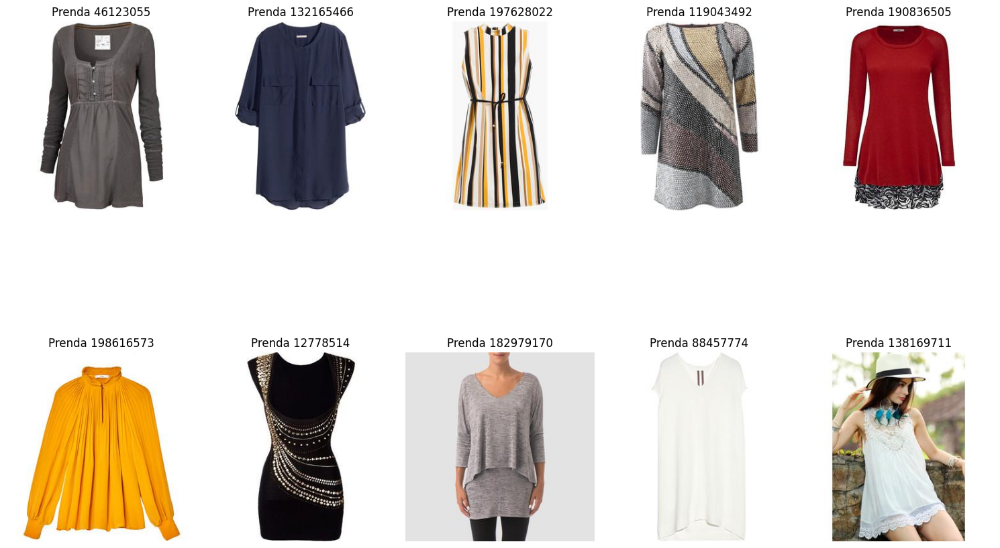


Cluster 1 (46 prendas):
 - Prenda 122174841: zimmermann riot broderie anglaise tunic Zimmermann takes inspiration from the airy styles worn by Ba...
 - Prenda 53918695: tiger lily kaftan Vintage inspired kaftan with volume created from gathered seams for a dramatic sil...
 - Prenda 193782067: button up tunic with paint Even if you aren't an artist, you will look like one in Nu Vintage's Butt...
 - Prenda 183642653: samoon cream plus size embroidered
 - Prenda 80777798: witchery drop back spliced sleeve This spliced tunic features a silk front placket detail with a hig...
 - Prenda 206658188: embroidered batwing sleeve tunic top Shop for Embroidered Batwing Sleeve Tunic Top at ZAFUL. Free Sh...
 - Prenda 208491274: flower ink wash painting plus
 - Prenda 176057624: white neck chiffon tunic lookbook
 - Prenda 183754434: plunge neck see through crochet Plunge V Neck See Through Crochet Tunic Top Plunge V Neck See Throug...
 - Prenda 212086061: sweet sammy jo eyelet tunic Sweet Sammy Jo E

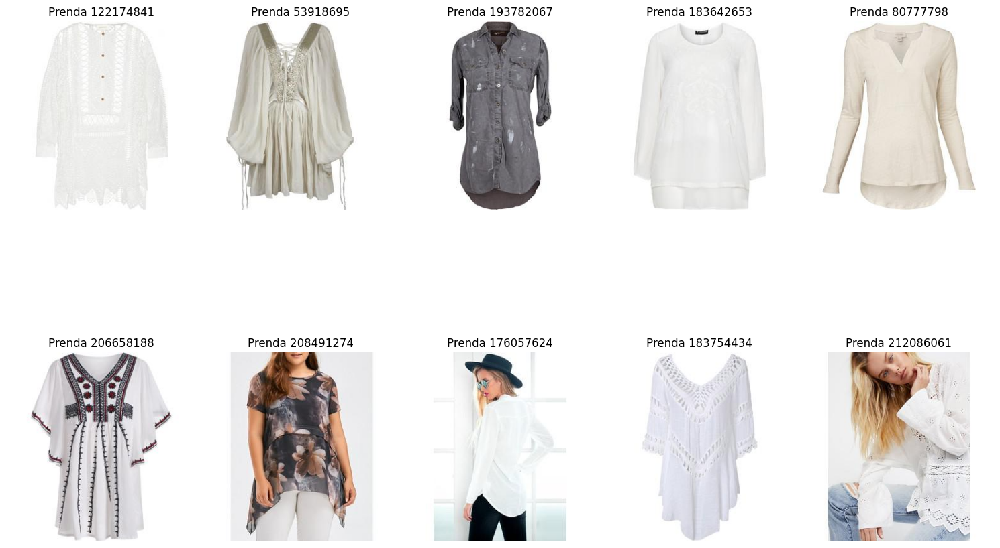


Cluster 2 (34 prendas):
 - Prenda 78813989: athena procopiou tribes sari cotton Tonal green printed cotton and silk-blend. Stitched armholes, po...
 - Prenda 212369595: emilio pucci kaftan
 - Prenda 194100059: joseph ribkoff tunic style 171692
 - Prenda 136516765: crew embroidered linen top
 - Prenda 203429300: vintage printed tunic shirt dress
 - Prenda 152463658: marni bonded washed felt sleeveless This sleeveless Marni tunic is rendered in bonded washed felt an...
 - Prenda 170689447: lazul kira silk tunic Step into summer with Lazul’s Kira tunic, a chic beach cover-up in sunshine ye...
 - Prenda 212692037: graffiti print plus size chiffon
 - Prenda 47698836: missoni cannes crochet-knit kaftan
 - Prenda 195141406: joseph ribkoff tunic style 171063
  Mostrando 10 imágenes del cluster 2:


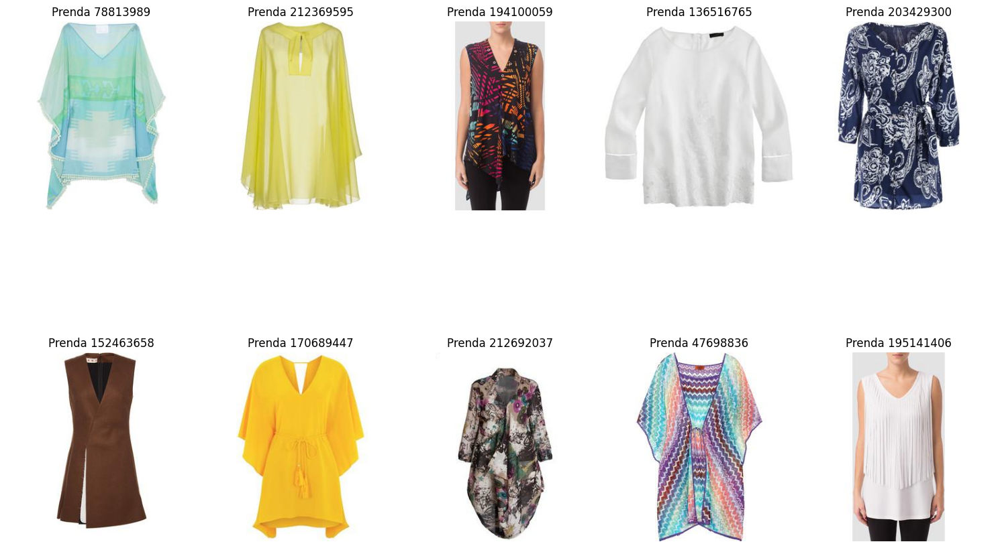


Cluster 3 (2 prendas):
 - Prenda 165092507: roamans boho floral tunic
 - Prenda 202283201: ibex womens w2 sport tunic
  Mostrando 2 imágenes del cluster 3:


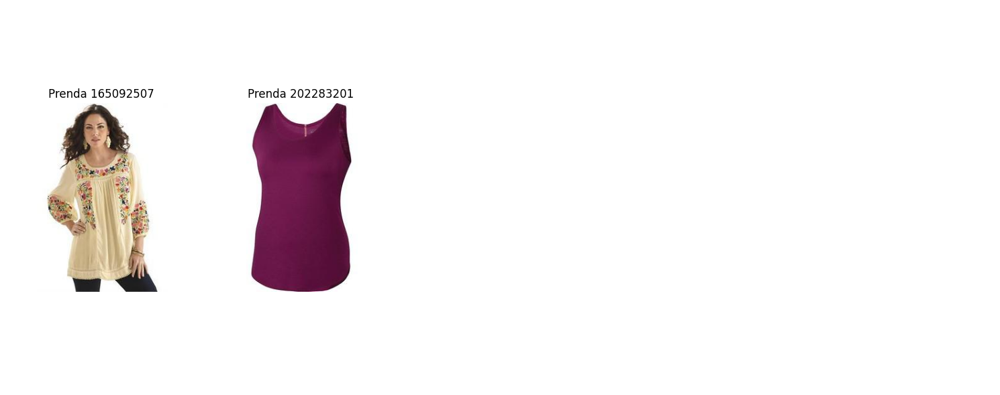


Cluster 4 (5 prendas):
 - Prenda 47112111: roberto cavalli long silk caftan
 - Prenda 115200259: stylish garderobe atos lombardini brown
 - Prenda 71916103: rachel comey shelter tunic trc502ps13
 - Prenda 212249717: cold shoulder leaf print plus Cold shoulder leaf print plus size tunic top in purplish blue at Twink...
 - Prenda 214172218: preowned vintage chinese silk embroidered We Acquired This Beautiful Vintage Silk Outfit When We Pur...
  Mostrando 5 imágenes del cluster 4:


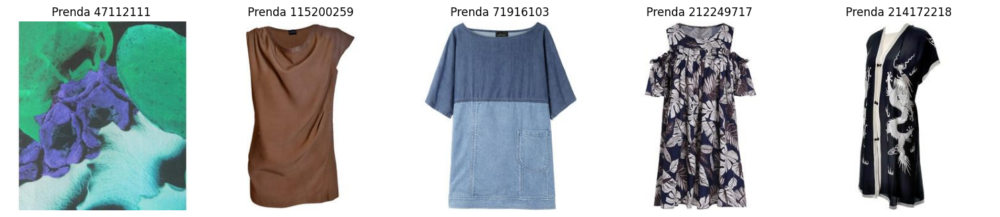


Cluster 5 (3 prendas):
 - Prenda 206077722: lemlem edna embroidered kaftan
 - Prenda 177929708: michael kors collection kaftan
 - Prenda 170540457: erika cavallini semi-couture silk akinori
  Mostrando 3 imágenes del cluster 5:


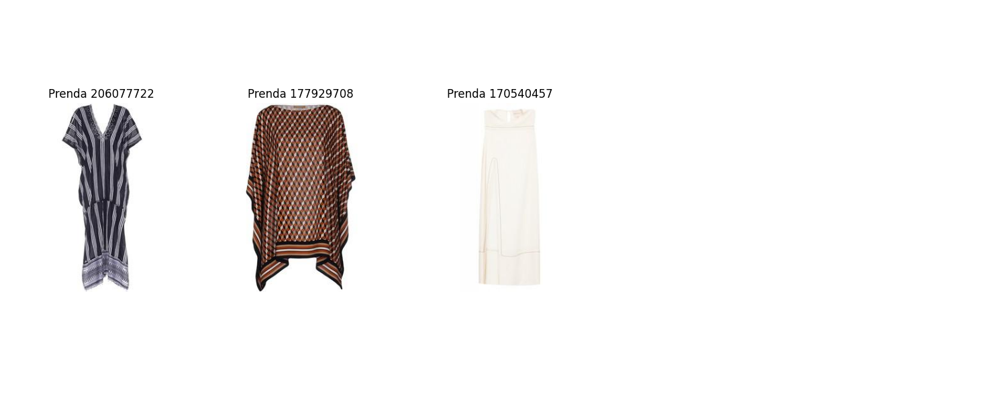


Cluster 6 (1 prendas):
 - Prenda 76631594: dsquared2 kaftan
  Mostrando 1 imágenes del cluster 6:


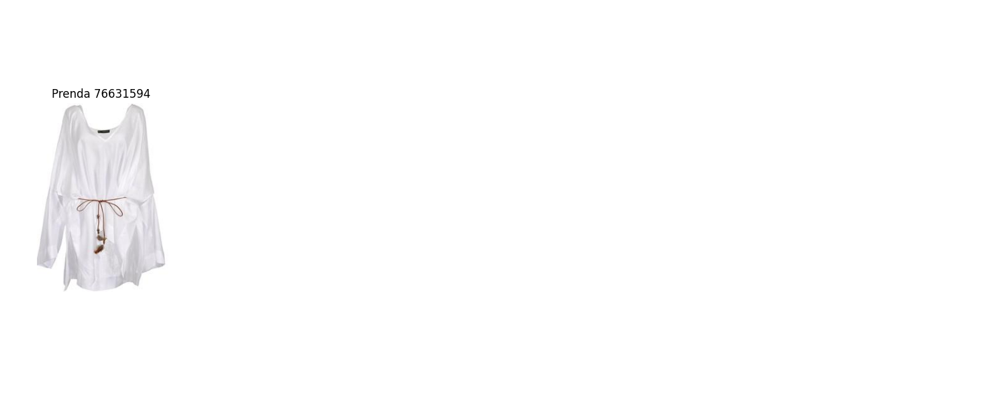

In [6]:
import os
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"
SUBCATEGORY = "tops"  # Subcategoría semántica
CATEGORY_ID = 15      # Subcategoría específica (ajusta según tus datos, por ejemplo, cat15)

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)[:100] + "..." if len(' '.join(parts)) > 100 else ' '.join(parts)

def show_cluster_examples():
    """Muestra 10 ejemplos de prendas por cluster y visualiza sus imágenes."""
    # Cargar metadatos
    metadata = load_metadata()
    
    # Ruta al CSV de la subcategoría
    csv_path = os.path.join(OUTPUT_DIR, SUBCATEGORY, f'cat{CATEGORY_ID}_hdp_clusters.csv')
    
    try:
        clusters_df = pd.read_csv(csv_path)
        print(f"Cargado {csv_path} con {len(clusters_df)} prendas")
    except FileNotFoundError:
        print(f"No se encontró {csv_path}. Verifica CATEGORY_ID o si los CSVs se generaron.")
        print("CSVs disponibles en hlda_outputs/tops/:")
        import glob
        csv_files = glob.glob(os.path.join(OUTPUT_DIR, SUBCATEGORY, "cat*.csv"))
        print([os.path.basename(f) for f in csv_files])
        return
    
    # Agrupar por cluster
    clusters = defaultdict(list)
    for _, row in clusters_df.iterrows():
        item_id = str(row['item_id'])
        cluster_id = row['cluster']
        if item_id in metadata:
            clusters[cluster_id].append((item_id, metadata[item_id]))
    
    # Mostrar ejemplos y visualizar
    for cluster_id in sorted(clusters.keys()):
        if cluster_id == -1:  # Saltar prendas sin cluster asignado
            continue
        print(f"\nCluster {cluster_id} ({len(clusters[cluster_id])} prendas):")
        
        # Mostrar hasta 10 ejemplos
        examples = clusters[cluster_id][:10]
        for item_id, item in examples:
            description = get_item_description(item)
            print(f" - Prenda {item_id}: {description}")
        
        # Visualizar imágenes
        num_items_to_show = min(10, len(examples))
        if num_items_to_show == 0:
            print("  No hay prendas para visualizar en este cluster.")
            continue
        
        images_per_row = 5
        num_rows = (num_items_to_show + images_per_row - 1) // images_per_row
        fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
        # Asegurar que axes sea un array 1D de Axes objects
        axes = axes.flatten() if num_rows * images_per_row > 1 else [axes] if num_items_to_show == 1 else axes
        
        print(f"  Mostrando {num_items_to_show} imágenes del cluster {cluster_id}:")
        for i, (item_id, _) in enumerate(examples):
            image_path = f"datasets/polyvore/images/{item_id}.jpg"
            try:
                img = mpimg.imread(image_path)
                axes[i].imshow(img)
                axes[i].set_title(f"Prenda {item_id}")
                axes[i].axis('off')
            except Exception as e:
                axes[i].text(0.5, 0.5, f"No se pudo cargar\nPrenda {item_id}\n{e}",
                             ha='center', va='center', fontsize=10, color='red')
                axes[i].axis('off')
        
        # Ocultar ejes vacíos
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

# Ejecutar
show_cluster_examples()

Cargados 251008 metadatos de prendas
Cargado hlda_outputs/tops/cat11_hdp_clusters.csv con 3169 prendas

Cluster 0 (1315 prendas):
 - Prenda 130288559: alexander wang wool-blend top Alexander Wang gray top.  Fine.knit wool.blend.  Sheer tulle inserts, ...
 - Prenda 109648803: theory stretch cotton-blend shirt Theory white shirt.  Cotton-blend.  Curved hem.  Button fastenings...
 - Prenda 195621075: river island cream tie-up turtleneck Eyelet tie-up Slim fit Cropped length Turtleneck Short sleeve O...
 - Prenda 159834068: monki fitted sleeve top A super fresh ¾ sleeve top with a fetching half polo neck.  A perfect comple...
 - Prenda 210535691: misha nonoo husband shirt Every brand claims to have the perfect white shirt. Not us. We know our cr...
 - Prenda 170837778: splendid winward asymmetric striped stretch-jersey We love Splendid for its considered approach to w...
 - Prenda 76859307: joie tasminia top This sleeveless silk blouse features a button front, single front chest pocket, an

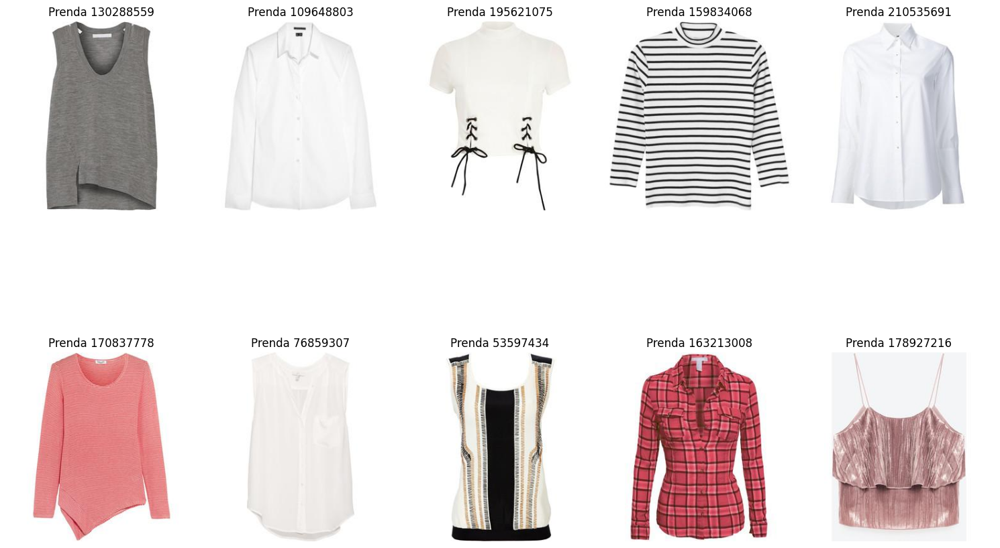


Cluster 1 (1314 prendas):
 - Prenda 175018750: topshop moto denim cropped tie Look to cropped details to add a seasonal touch to the classic denim ...
 - Prenda 132992976: crocheted top Short, crocheted cotton top.  100% cotton.  Machine wash at 40˚ H&M Crocheted top Crop...
 - Prenda 206365795: cropped top kiss my ass
 - Prenda 211838097: needle thread embroidered crop top Blue, white and black embroidered crop top from Needle & Thread. ...
 - Prenda 191534548: mira mikati printed denim shirt Printed Denim Shirt from Mira Mikati Available in Light Blue.  Fold-...
 - Prenda 190223655: river island green velvet deep Velvet fabric Deep frill detail Elasticated bardot neckline Short sle...
 - Prenda 209512157: off shoulder pintuck puff sleeve
 - Prenda 182220690: fleur du mal velvet longline This Fleur Du Mal bralette is rendered in velvet and features a v-neckl...
 - Prenda 206061115: off-the-shoulder poplin top A smocked off-the-shoulder top in white cotton poplin. Off-The-Shoulder ...

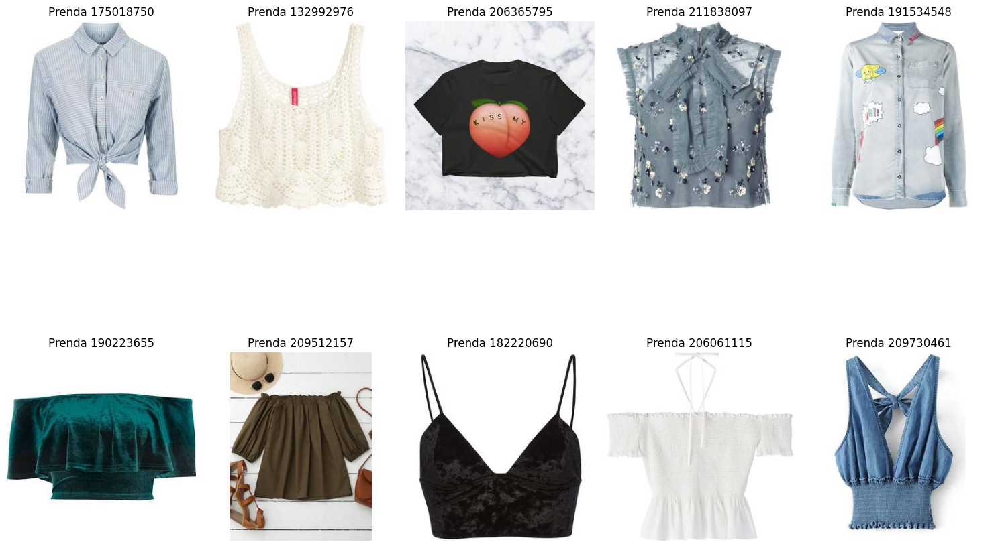


Cluster 2 (359 prendas):
 - Prenda 205171420: topshop choker short sleeve wrap Your latest staple day-to-night piece, this short sleeve top in bla...
 - Prenda 194104332: msgm cropped bow detail top Yellow cotton blend cropped bow detail top from MSGM.  Dry clean only.  ...
 - Prenda 181054366: monique lhuillier silk faille bodice Rendered in silk, this strapless Monique Lhuillier top features...
 - Prenda 213599031: pre-owned pinko blue viscose top
 - Prenda 197247863: msgm poplin-trimmed cutout cotton-jersey top MSGM's Resort '17 collection references motorcross, ska...
 - Prenda 214046180: zimmermann maples bow top Maples Bow Top, from our Fall 17 collection, in Black and Pearl stripe twi...
 - Prenda 169820935: dolce gabbana printed crop top
 - Prenda 192404669: victoria beckham cotton top Made from jet black cotton with full voluminous ruffles on the sleeves, ...
 - Prenda 172413710: new look black palm leaf New Look  Black Palm Leaf Print Wrap Crop Top, Stand out on nights out w

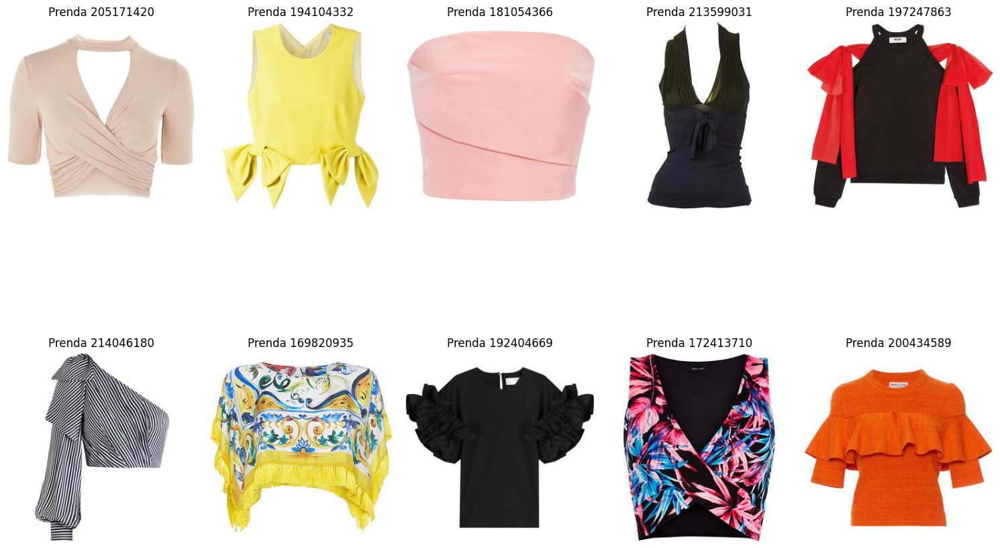


Cluster 3 (107 prendas):
 - Prenda 154249722: bean scotch plaid shirt relaxed The same great tartan flannel as in our men's shirt, designed just f...
 - Prenda 164289231: age innocence cold shoulder top
 - Prenda 120968144: maison kitsun%C3%A9 classic oxford shirt From the acclaimed, cult label, Maison Kitsuné with an emph...
 - Prenda 75573060: madewell denim boyshirt in saltstone Faded in all the right places with a perfectly shrunken fit, it...
 - Prenda 156865303: yoins black cross pinstripe bralets
 - Prenda 105388562: uniqlo women denim long sleeve A denim button-down shirt that's lightweight and comfortable with cas...
 - Prenda 136087043: azzedine ala%C3%AFa cerceaux stretch knitted Round neckline. Sleeveless. Coordinating item available...
 - Prenda 126910308: victorias secret pink university florida With sporty graphics and an oversized fit, the Varsity Crew...
 - Prenda 110376334: liana bustier selected femme Nelly.de: Liana Bustier - Selected Femme - Frau - Schwarz. Jeden 

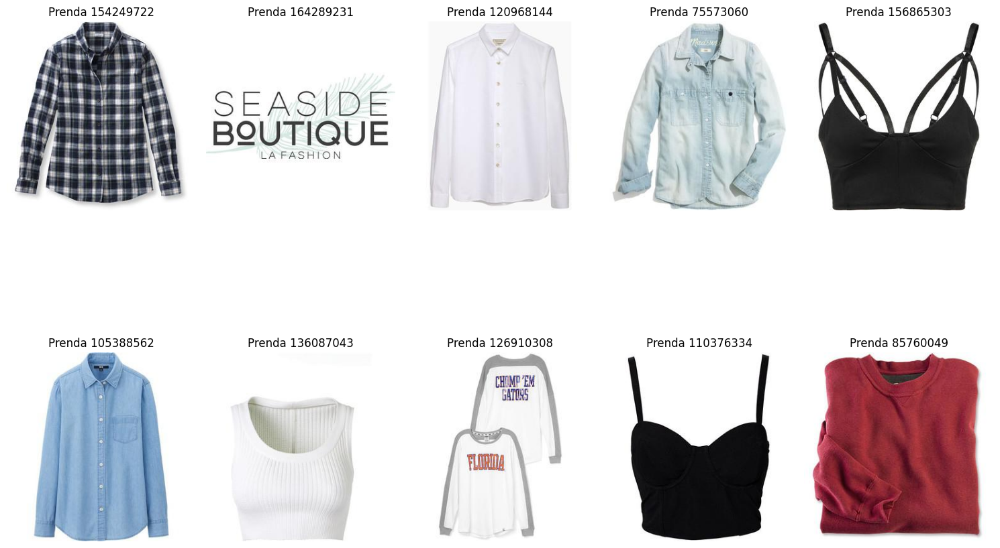


Cluster 4 (46 prendas):
 - Prenda 213332998: doublju neck floral printing girlish Buy Doublju V Neck Floral Printing Girlish Crop Tank Top For Wo...
 - Prenda 206395194: zig zag off shoulder saclloped
 - Prenda 151157278: vivienne westwood red label classic
 - Prenda 211832524: rosie assoulin dust ruffle red Dust Ruffle Red Top Rosie Assoulin Dust Ruffle Red Top Rosie Assoulin...
 - Prenda 171802707: alice olivia emmeline white guipure Alice + Olivia white guipure lace top Adjustable grosgrain shoul...
 - Prenda 171877472: plus size asymmetrical open shoulder
 - Prenda 214515102: surplice sleeveless plus size top
 - Prenda 197513525: etro silk top Yellow silk top by Etro. Etro Silk Top Etro Yellow top Silk top
 - Prenda 182620091: sea tie-front wool top
 - Prenda 193678018: mother pearl georgia embellished neck
  Mostrando 10 imágenes del cluster 4:


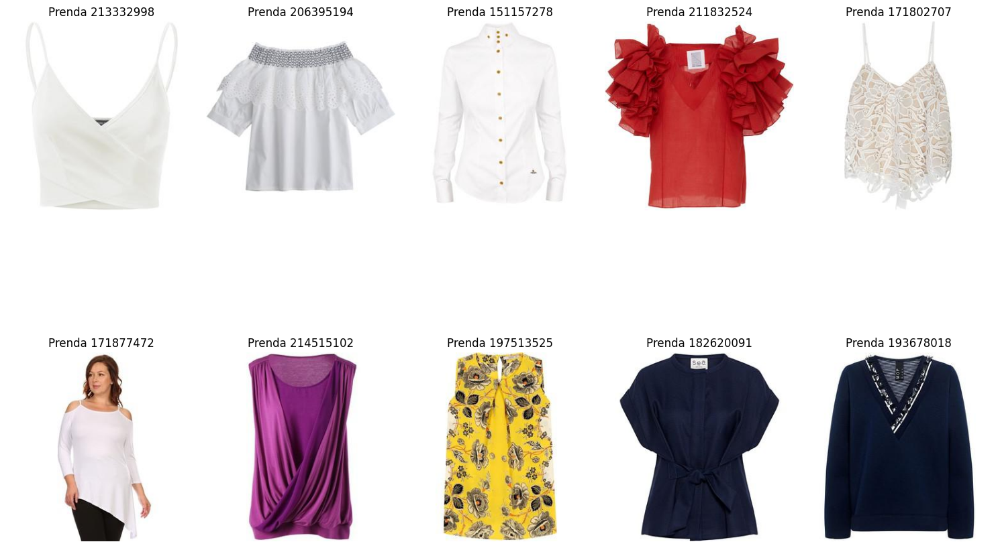


Cluster 5 (15 prendas):
 - Prenda 208139760: orange red swirls doodles crop pattern, drawing, watercolor, doodles, zentangle, scrolls, spirals, a...
 - Prenda 50800119: marc jacobs tapioca peter pan
 - Prenda 208464604: emoji basketball crop top OOhhh, I see you girl! Getting flirty with this emoji crop top. Does your ...
 - Prenda 134676707: cameo no diggity top
 - Prenda 153100369: marc jacobs wool-gabardine shirt
 - Prenda 114981538: current elliott prep school plaid Blue The Prep School plaid cotton shirt. Current/Elliott The Prep ...
 - Prenda 161770161: we it Image shared by niall af¿? on We Heart It: discover brown, beige, and tan photos. We ❤ It
 - Prenda 189082550: grid pocket asymmetrical shirt I like this. Do you think I should buy it? Grid Pocket Asymmetrical S...
 - Prenda 203334789: detournament crop top
 - Prenda 207648771: jonathan simkhai womens lace inset
  Mostrando 10 imágenes del cluster 5:


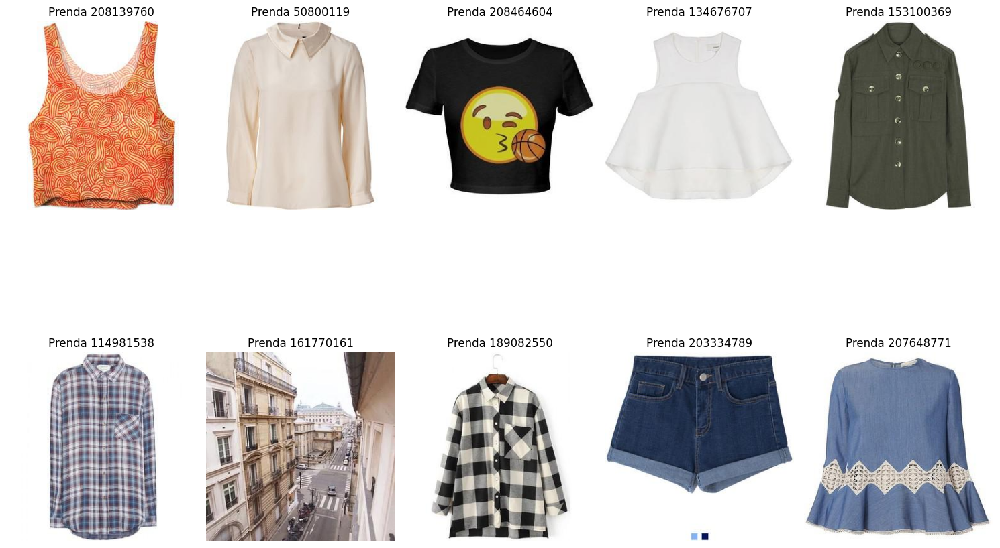


Cluster 6 (7 prendas):
 - Prenda 136849578: silvia victoria madeleine sofia which
 - Prenda 203958627: protagonist classic knit top White silk, cashmere and wool classic knit top from Protagonist. Design...
 - Prenda 23455240: womens online exclusives 50-100 svpply Women's ONLINE EXCLUSIVES ($50-100) - Svpply Madewell White t...
 - Prenda 211507878: cap sleeves shirt
 - Prenda 208812373: flare sleeve knitting tied top
 - Prenda 168227599: mulberry regina shirt
 - Prenda 136398529: giambattista valli floral striped sleeveless White silk blend floral striped sleeveless shirt  from ...
  Mostrando 7 imágenes del cluster 6:


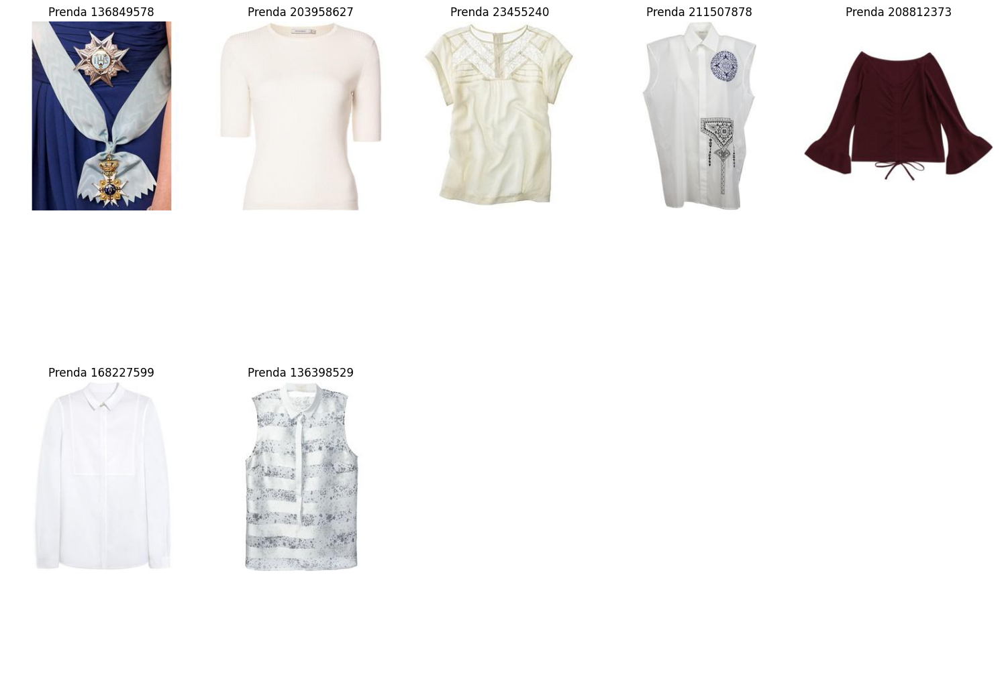


Cluster 7 (2 prendas):
 - Prenda 90795630: vila officiel wide stripe top
 - Prenda 160043592: pre-owned rachel zoe top
  Mostrando 2 imágenes del cluster 7:


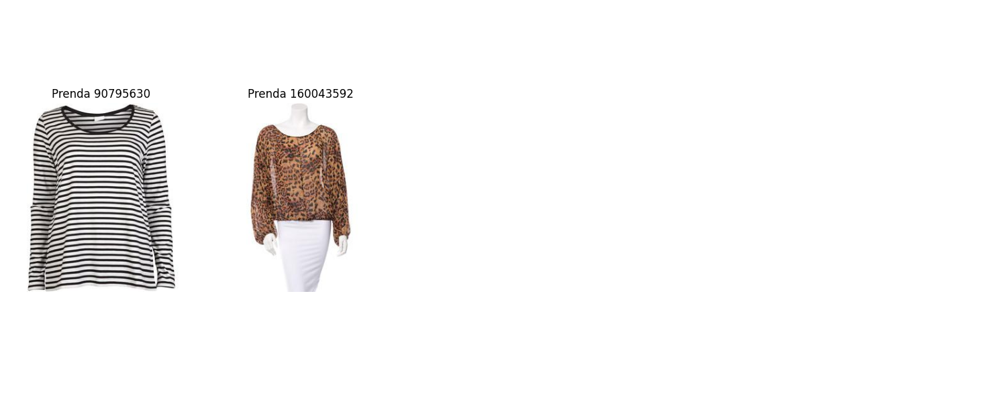


Cluster 20 (1 prendas):
 - Prenda 70443865: ultra 90s tommy hilfiger tribal Ultra 90s Tommy Hilfiger Tribal TShirt L by NeonStockyards Tommy Hil...
  Mostrando 1 imágenes del cluster 20:


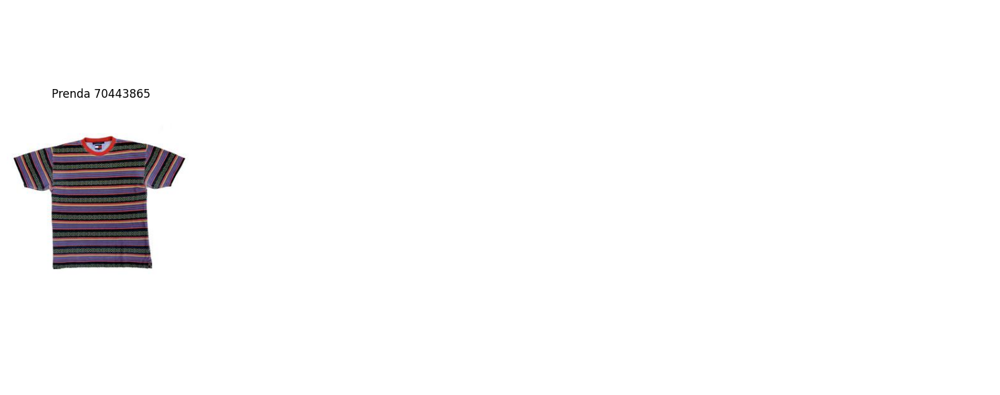


Cluster 26 (1 prendas):
 - Prenda 154518343: pilgrim minnie thanksgiving mouse kissing Instant download, image as shown. No customization for thi...
  Mostrando 1 imágenes del cluster 26:


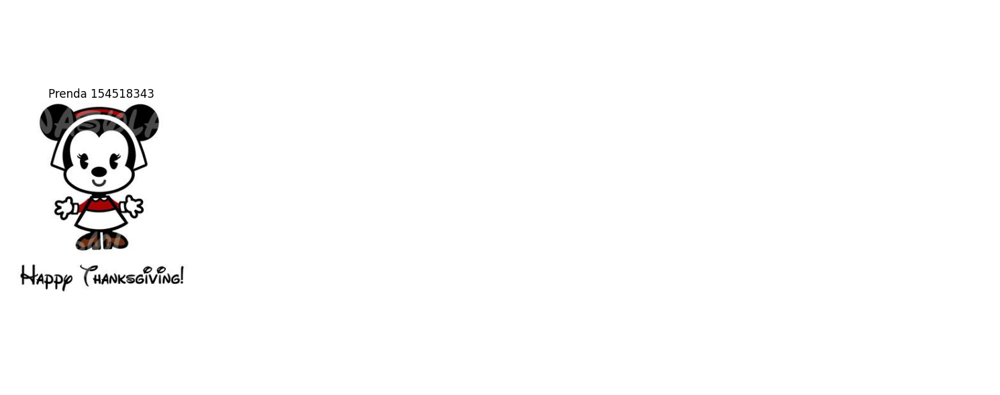


Cluster 53 (1 prendas):
 - Prenda 144812497: comme des gar%C3%A7ons cotton top Cotton top, Comme des Garçons Comme des Garçons' sailor-style cott...
  Mostrando 1 imágenes del cluster 53:


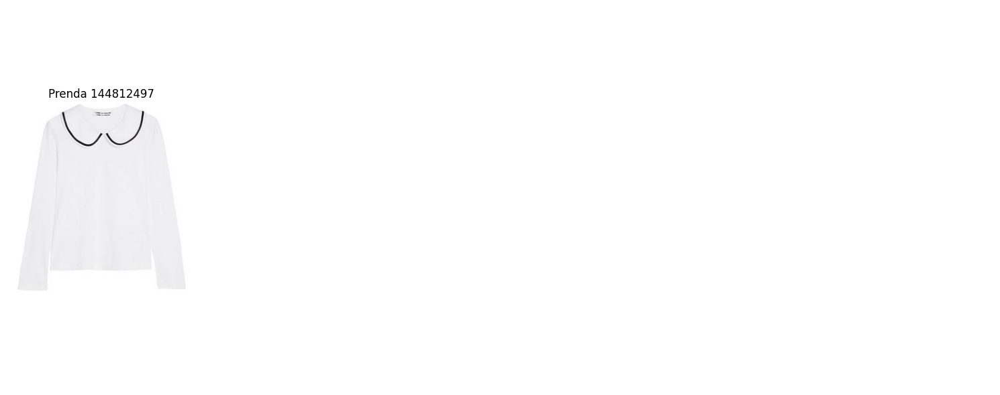


Cluster 85 (1 prendas):
 - Prenda 49636968: %E3%83%95%E3%82%A1%E3%83%83%E3%82%B7%E3%83%A7%E3%83%B3
  Mostrando 1 imágenes del cluster 85:


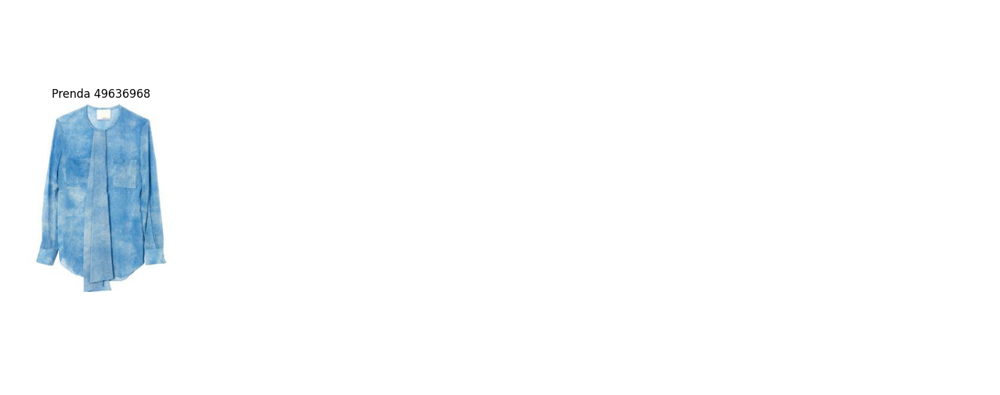

In [7]:
import os
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"
SUBCATEGORY = "tops"  # Subcategoría semántica
CATEGORY_ID = 11      # Subcategoría específica (ajusta según tus datos, por ejemplo, cat15)

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)[:100] + "..." if len(' '.join(parts)) > 100 else ' '.join(parts)

def show_cluster_examples():
    """Muestra 10 ejemplos de prendas por cluster y visualiza sus imágenes."""
    # Cargar metadatos
    metadata = load_metadata()
    
    # Ruta al CSV de la subcategoría
    csv_path = os.path.join(OUTPUT_DIR, SUBCATEGORY, f'cat{CATEGORY_ID}_hdp_clusters.csv')
    
    try:
        clusters_df = pd.read_csv(csv_path)
        print(f"Cargado {csv_path} con {len(clusters_df)} prendas")
    except FileNotFoundError:
        print(f"No se encontró {csv_path}. Verifica CATEGORY_ID o si los CSVs se generaron.")
        print("CSVs disponibles en hlda_outputs/tops/:")
        import glob
        csv_files = glob.glob(os.path.join(OUTPUT_DIR, SUBCATEGORY, "cat*.csv"))
        print([os.path.basename(f) for f in csv_files])
        return
    
    # Agrupar por cluster
    clusters = defaultdict(list)
    for _, row in clusters_df.iterrows():
        item_id = str(row['item_id'])
        cluster_id = row['cluster']
        if item_id in metadata:
            clusters[cluster_id].append((item_id, metadata[item_id]))
    
    # Mostrar ejemplos y visualizar
    for cluster_id in sorted(clusters.keys()):
        if cluster_id == -1:  # Saltar prendas sin cluster asignado
            continue
        print(f"\nCluster {cluster_id} ({len(clusters[cluster_id])} prendas):")
        
        # Mostrar hasta 10 ejemplos
        examples = clusters[cluster_id][:10]
        for item_id, item in examples:
            description = get_item_description(item)
            print(f" - Prenda {item_id}: {description}")
        
        # Visualizar imágenes
        num_items_to_show = min(10, len(examples))
        if num_items_to_show == 0:
            print("  No hay prendas para visualizar en este cluster.")
            continue
        
        images_per_row = 5
        num_rows = (num_items_to_show + images_per_row - 1) // images_per_row
        fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
        # Asegurar que axes sea un array 1D de Axes objects
        axes = axes.flatten() if num_rows * images_per_row > 1 else [axes] if num_items_to_show == 1 else axes
        
        print(f"  Mostrando {num_items_to_show} imágenes del cluster {cluster_id}:")
        for i, (item_id, _) in enumerate(examples):
            image_path = f"datasets/polyvore/images/{item_id}.jpg"
            try:
                img = mpimg.imread(image_path)
                axes[i].imshow(img)
                axes[i].set_title(f"Prenda {item_id}")
                axes[i].axis('off')
            except Exception as e:
                axes[i].text(0.5, 0.5, f"No se pudo cargar\nPrenda {item_id}\n{e}",
                             ha='center', va='center', fontsize=10, color='red')
                axes[i].axis('off')
        
        # Ocultar ejes vacíos
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

# Ejecutar
show_cluster_examples()

Cargados 251008 metadatos de prendas
Cargado hlda_outputs/tops/cat17_hdp_clusters.csv con 1785 prendas

Cluster 0 (1019 prendas):
 - Prenda 184587087: iro womens greta mock neck A boxy blouse with mock neckline and long sleeves.  Zip closure at back. ...
 - Prenda 118413023: shein sheinside white lapel long White Cute Lapel Long Sleeve Polyester Plain Fall Blouses, Size Ava...
 - Prenda 126047523: rotita long sleeve chiffon leopard Style:Casual.  Collar:Turndown Collar.  Sleeve's Length:Long Slee...
 - Prenda 191199166: stella mccartney striped cotton-blend blouse Stella McCartney's blouse is cut from airy cotton-blend...
 - Prenda 200044782: oscar de la renta metallic Bringing Oscar de la Renta’s refined femininity to evening looks, this to...
 - Prenda 181349496: chloe lace silk blouse Colour: black Composition 100% polyamide  Composition II 100% silk  Lining 10...
 - Prenda 97503867: elizabeth james brendan sleeveless crop With a sheer chiffon panel at the shoulders plus an exposed 

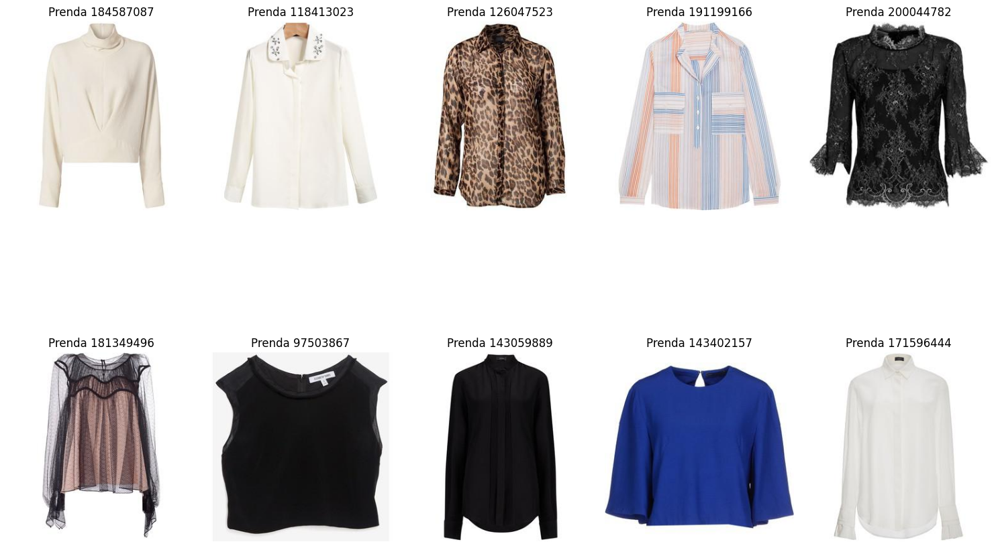


Cluster 1 (554 prendas):
 - Prenda 179791046: croosover poplin blouse Premium Collection, Cotton poplin, Crossover design, V-neck, Short sleeve, S...
 - Prenda 194799164: floral embroidered flounce blouse white Floral embroidered flounce blouse in white at Twinkledeals.c...
 - Prenda 22653517: charlie
 - Prenda 201897442: yoins neck blouse with adjustable There is no doubt that basics are getting better and better with p...
 - Prenda 209360524: mogul womens red tank top
 - Prenda 208956139: shein sheinside fluted sleeve florals Navy Casual Vacation Cute V Neck Long Sleeve Bell Sleeve Chiff...
 - Prenda 211024550: leaves print neck self tie
 - Prenda 183743678: spaghetti strap crochet patchwork black Spaghetti Strap Crochet Patchwork Black Blouse Spaghetti Str...
 - Prenda 215071059: tie white linen blouse The Tie Blouse is the perfect classic that is always so hard to find. This si...
 - Prenda 50482214: ralph lauren lace ruffled blouse Off-white silk blouse from Ralph Lauren featurin

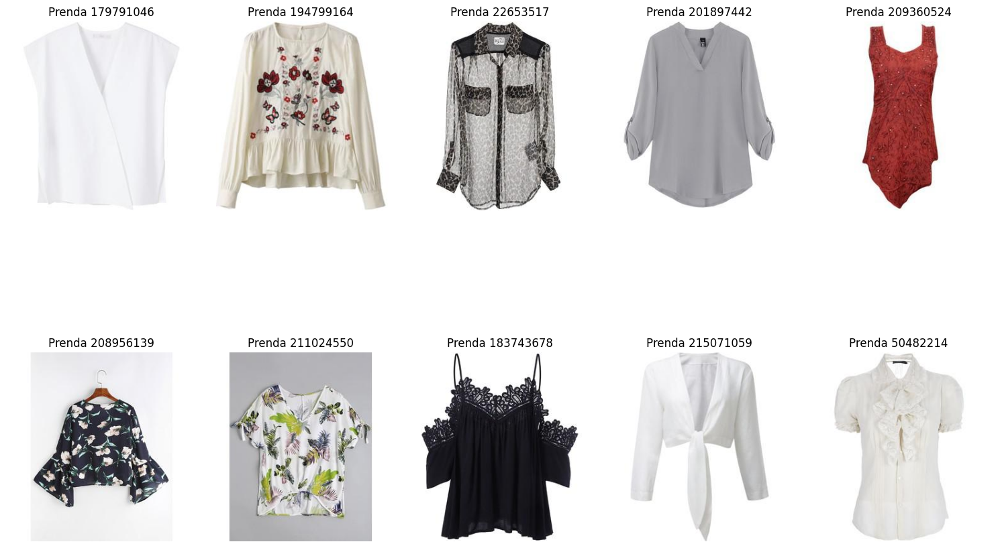


Cluster 2 (150 prendas):
 - Prenda 169480508: blumarine blouse
 - Prenda 213469439: spaghetti strap ruffle blouse yellow
 - Prenda 169841987: caroline constas carmen off shoulder From the emerging New York-based designer comes this *Caroline ...
 - Prenda 204794771: vita kin grapevine embroidered linen
 - Prenda 199548686: jacquemus off-shoulder shirt White cotton off-shoulder shirt from Jacquemus. Jacquemus Off-Shoulder ...
 - Prenda 146536948: rebecca taylor silk georgette drape A draped, wrap front creates a dramatic blouson finish on this g...
 - Prenda 52644667: simone rocha lace shirt
 - Prenda 197532295: red valentino hummingbird ruffle silk Red Valentino's sheer hummingbird blouse is crafted from silk ...
 - Prenda 203491076: givenchy blouse Givenchy Women Blouse on YOOX. The best online selection of Blouses Givenchy. YOOX e...
 - Prenda 206605953: layered see-through lace blouse white
  Mostrando 10 imágenes del cluster 2:


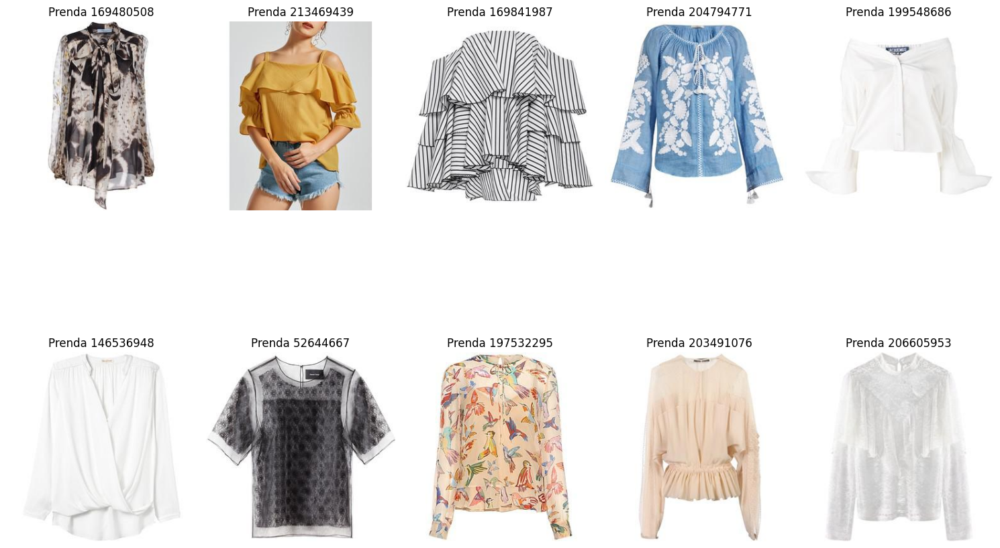


Cluster 3 (12 prendas):
 - Prenda 42677194: chic shirt clothing new clothes Chic shirt, Chic clothing, New clothes, Romwe.com Blue shirt Shirt t...
 - Prenda 39598998: thomas wylde red light embellished Thomas Wylde black Red Light top. Silk-chiffon. Clear and black c...
 - Prenda 146739048: alexander wang football blouse Inspired by the infamous football uniforms, T by Wang designs this bl...
 - Prenda 51209506: old navy womens lightweight dolman
 - Prenda 163402682: green lapel preppy appropriately checks Green Lapel Preppy Appropriately Checks Plaid Buttons Crop B...
 - Prenda 20040404: roll sleeve burnout top teen Roll Sleeve Burnout Top - Teen Clothing by Wet Seal Shirt top Burnout s...
 - Prenda 131070952: gray pretty ladies long sleeve Gray Pretty Ladies Long Sleeve Plaid Long Blouse Long sleeve blouse L...
 - Prenda 181080334: white lace up fringe embroidered
 - Prenda 56051523: oversized stud denim shirt Oversized denim shirt with yoke and front yoke stud detailing. 100% Cott

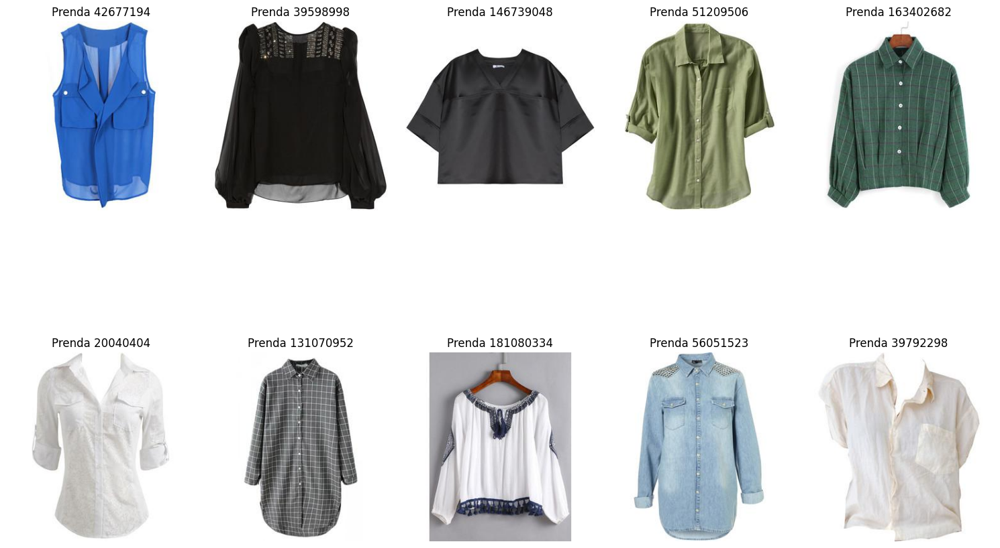


Cluster 4 (37 prendas):
 - Prenda 164167001: rodarte chantilly lace draped blouse
 - Prenda 149524212: cushnie et ochs pearl-trimmed silk-georgette
 - Prenda 186230075: space style concept blouse
 - Prenda 181299805: sahara blouse Relaxed style cropped blouse featuring a deep v neckline with soft front draping. This...
 - Prenda 192143968: needle threadembellished tulle top Needle & Thread's top is embellished with sequins, beads and pail...
 - Prenda 196163473: self-portrait ophelia ruffled lace-sleeved blouse This black Ophelia top demonstrates Self Potrait's...
 - Prenda 204288542: maticevski ruffled off shoulder blouse Yellow silk ruffled off shoulder blouse from Maticevski. Desi...
 - Prenda 192565540: thep intense black stretch blouse
 - Prenda 171629819: see-through embroidery shirt collar butterfly
 - Prenda 197937556: printed chiffon asymmetric plus size
  Mostrando 10 imágenes del cluster 4:


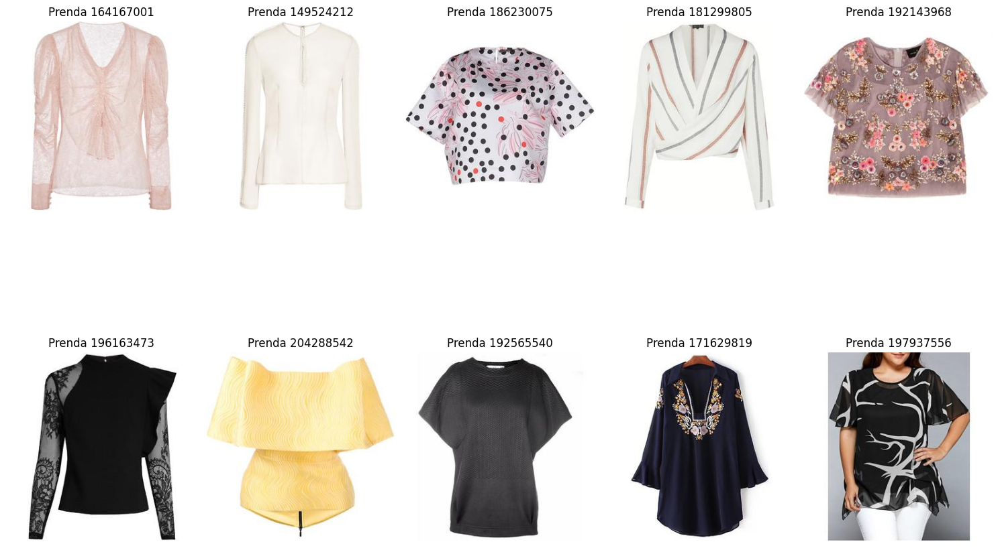


Cluster 5 (5 prendas):
 - Prenda 204298322: rosie assoulin asymmetric ruffled blouse Navy blue and white cotton blend asymmetric ruffled blouse ...
 - Prenda 170723844: womens long-sleeved tops american vintage
 - Prenda 193663003: tiered ruffle stripe blouse
 - Prenda 207834750: shein sheinside flounce layered neckline
 - Prenda 198226245: silk blouse 49.99
  Mostrando 5 imágenes del cluster 5:


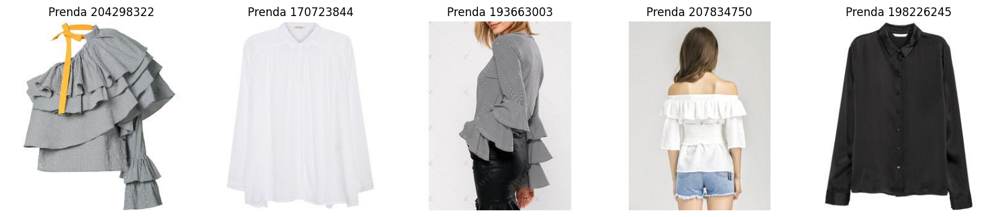


Cluster 6 (6 prendas):
 - Prenda 101156182: wunderkind lilac blue bow blouse Locker geschnittene Bluse mit rundem, halsfernem Kragen und langen ...
 - Prenda 134619256: erika cavallini semi couture flutter
 - Prenda 208988201: off-the-shoulder blouse 19.99
 - Prenda 206695873: blouses for women intermix
 - Prenda 49981989: valentino silk-satin shirt
 - Prenda 47742520: lelativement ファッション誌『VOGUE JAPAN』の公式サイト。『VOGUE JAPAN』で掲載されたファッションアイテムの検索ページ。ファッションアイテム名からはもちろん、ファッショ...
  Mostrando 6 imágenes del cluster 6:


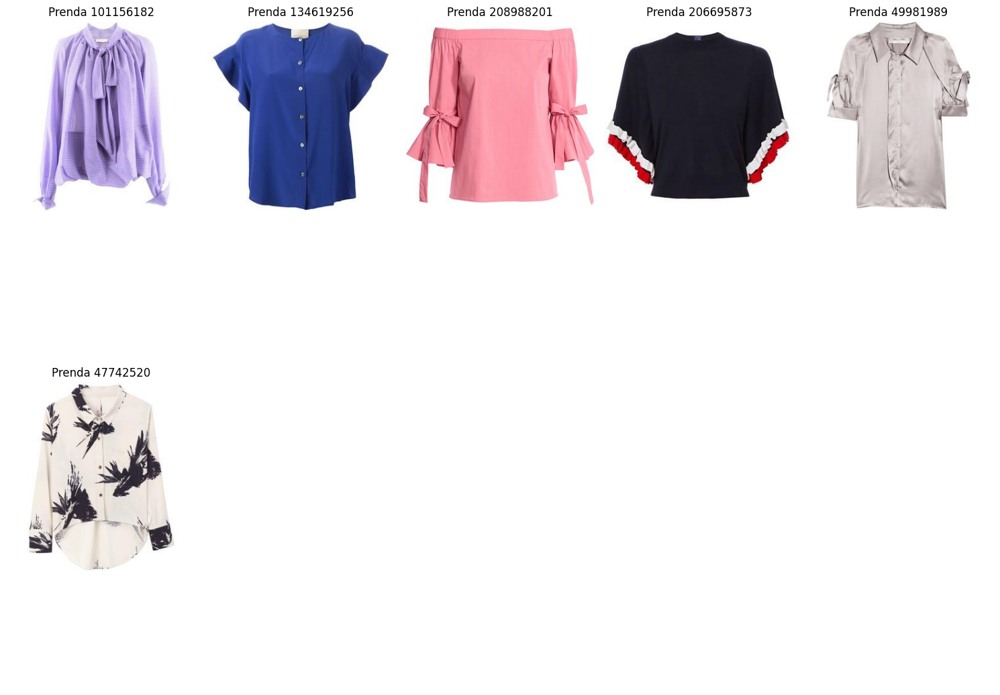


Cluster 7 (1 prendas):
 - Prenda 99300850: derek lam bright blouse
  Mostrando 1 imágenes del cluster 7:


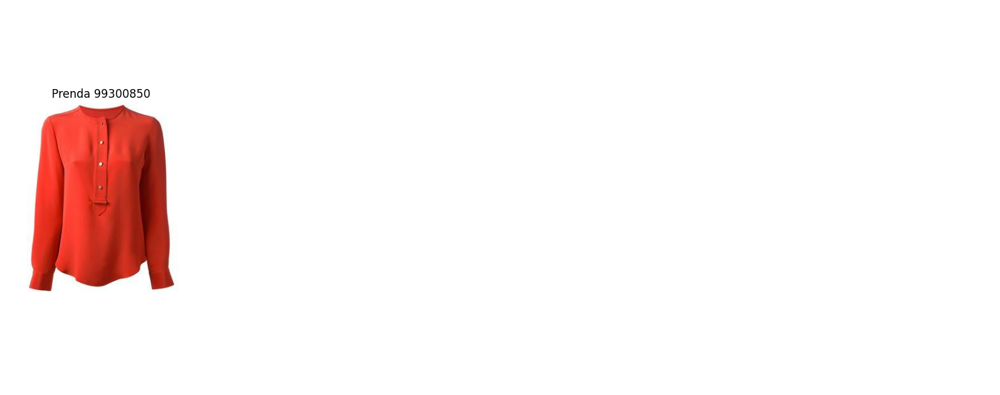


Cluster 48 (1 prendas):
 - Prenda 203051828: loewe crystal dot blouse
  Mostrando 1 imágenes del cluster 48:


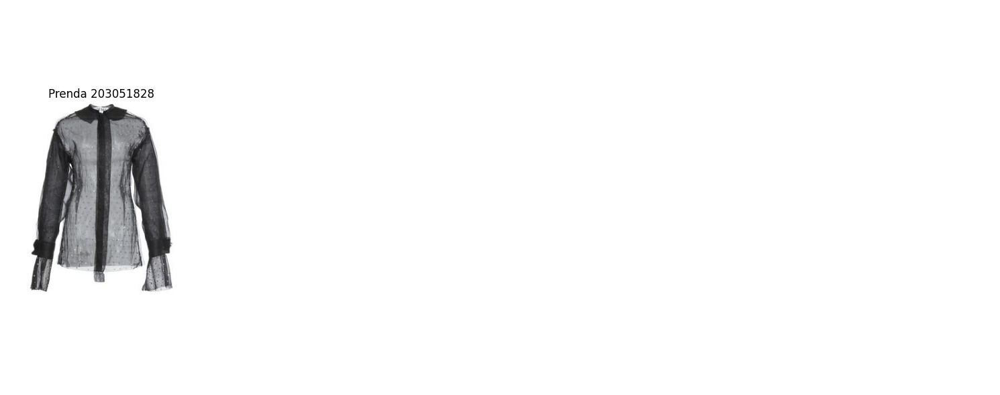

In [8]:
import os
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"
SUBCATEGORY = "tops"  # Subcategoría semántica
CATEGORY_ID = 17     # Subcategoría específica (ajusta según tus datos, por ejemplo, cat15)

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)[:100] + "..." if len(' '.join(parts)) > 100 else ' '.join(parts)

def show_cluster_examples():
    """Muestra 10 ejemplos de prendas por cluster y visualiza sus imágenes."""
    # Cargar metadatos
    metadata = load_metadata()
    
    # Ruta al CSV de la subcategoría
    csv_path = os.path.join(OUTPUT_DIR, SUBCATEGORY, f'cat{CATEGORY_ID}_hdp_clusters.csv')
    
    try:
        clusters_df = pd.read_csv(csv_path)
        print(f"Cargado {csv_path} con {len(clusters_df)} prendas")
    except FileNotFoundError:
        print(f"No se encontró {csv_path}. Verifica CATEGORY_ID o si los CSVs se generaron.")
        print("CSVs disponibles en hlda_outputs/tops/:")
        import glob
        csv_files = glob.glob(os.path.join(OUTPUT_DIR, SUBCATEGORY, "cat*.csv"))
        print([os.path.basename(f) for f in csv_files])
        return
    
    # Agrupar por cluster
    clusters = defaultdict(list)
    for _, row in clusters_df.iterrows():
        item_id = str(row['item_id'])
        cluster_id = row['cluster']
        if item_id in metadata:
            clusters[cluster_id].append((item_id, metadata[item_id]))
    
    # Mostrar ejemplos y visualizar
    for cluster_id in sorted(clusters.keys()):
        if cluster_id == -1:  # Saltar prendas sin cluster asignado
            continue
        print(f"\nCluster {cluster_id} ({len(clusters[cluster_id])} prendas):")
        
        # Mostrar hasta 10 ejemplos
        examples = clusters[cluster_id][:10]
        for item_id, item in examples:
            description = get_item_description(item)
            print(f" - Prenda {item_id}: {description}")
        
        # Visualizar imágenes
        num_items_to_show = min(10, len(examples))
        if num_items_to_show == 0:
            print("  No hay prendas para visualizar en este cluster.")
            continue
        
        images_per_row = 5
        num_rows = (num_items_to_show + images_per_row - 1) // images_per_row
        fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
        # Asegurar que axes sea un array 1D de Axes objects
        axes = axes.flatten() if num_rows * images_per_row > 1 else [axes] if num_items_to_show == 1 else axes
        
        print(f"  Mostrando {num_items_to_show} imágenes del cluster {cluster_id}:")
        for i, (item_id, _) in enumerate(examples):
            image_path = f"datasets/polyvore/images/{item_id}.jpg"
            try:
                img = mpimg.imread(image_path)
                axes[i].imshow(img)
                axes[i].set_title(f"Prenda {item_id}")
                axes[i].axis('off')
            except Exception as e:
                axes[i].text(0.5, 0.5, f"No se pudo cargar\nPrenda {item_id}\n{e}",
                             ha='center', va='center', fontsize=10, color='red')
                axes[i].axis('off')
        
        # Ocultar ejes vacíos
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

# Ejecutar
show_cluster_examples()

Cargados 251008 metadatos de prendas
Cargado hlda_outputs/bags/cat36_hdp_clusters.csv con 2209 prendas

Cluster 0 (873 prendas):
 - Prenda 124833271: carven burgundy leather chain-lock tote
 - Prenda 147254244: sole society foldover fringe tote
 - Prenda 134516958: tods leather suede tote
 - Prenda 142624145: saint laurent nano sac de
 - Prenda 50254787: bucket tote maggie bags
 - Prenda 186764524: pre-owned fendi multicolor 2jours handbag
 - Prenda 103376899: burberry bloomsbury in hand-painted leather
 - Prenda 120261057: burberry prorsum black colorblock bloomsbury
 - Prenda 119095708: dkny large chelsea shopper
 - Prenda 206580030: prada city calf leather inside
  Mostrando 10 imágenes del cluster 0:


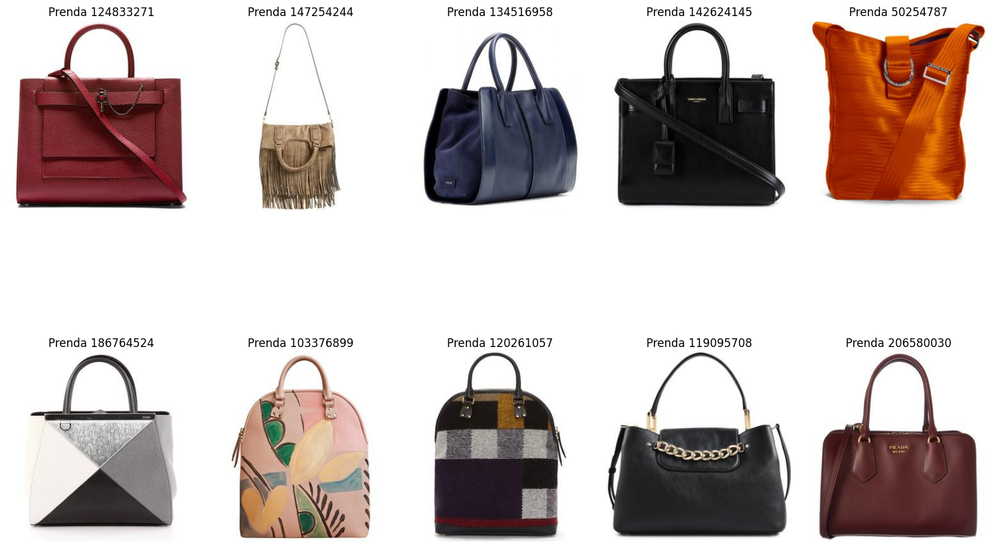


Cluster 1 (647 prendas):
 - Prenda 171261185: straw studios graphic tote
 - Prenda 209439293: antonello tedde medium urtei east-west
 - Prenda 203114502: home accents rectangle tote yellow
 - Prenda 210402772: metal solid colour cover tote
 - Prenda 211025131: linen tote bag with pu
 - Prenda 209344761: miu leather hand bag
 - Prenda 208919610: womens topshop faux leather tote
 - Prenda 170273349: letter print contrast canvas drawstring
 - Prenda 55352846: vintage bicycle tote bag canvas
 - Prenda 186879033: givenchy small antigona tote
  Mostrando 10 imágenes del cluster 1:


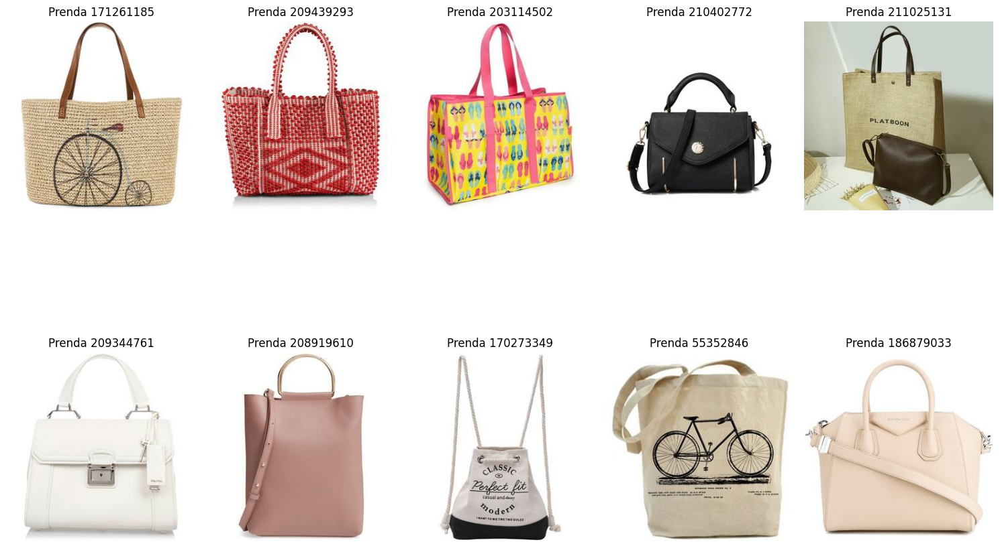


Cluster 2 (483 prendas):
 - Prenda 158274454: chloe paraty medium tote
 - Prenda 80280063: leghila beach tote
 - Prenda 211853566: nannacay red woven straw nica
 - Prenda 208735941: straw shopper 24.99
 - Prenda 145504915: womens nylon french market tote
 - Prenda 214560771: liebeskind womens lome leather shopper
 - Prenda 103697254: mar sol tulum tote
 - Prenda 202803855: womens classic straw summer beach
 - Prenda 165502261: ilishop womens summer straw ring
 - Prenda 205016327: simon miller birch tote
  Mostrando 10 imágenes del cluster 2:


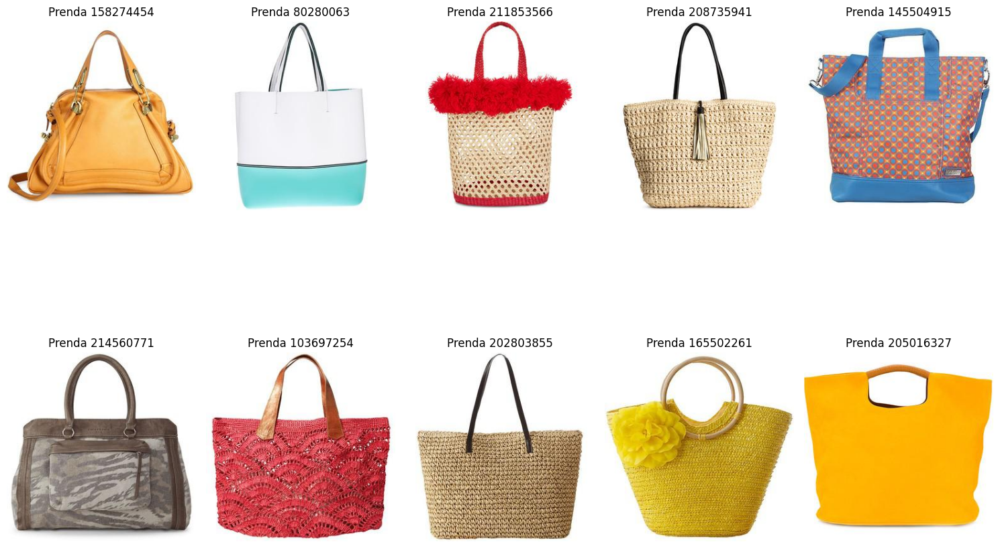


Cluster 3 (61 prendas):
 - Prenda 111128915: michael kors medium sutton tote
 - Prenda 109878682: fendi womens 2jours petite tote
 - Prenda 164474345: bao issey miyake lucent-2 prism
 - Prenda 120981284: modcloth cats feline fanatic tote
 - Prenda 202599161: givenchy pyramid striped leather tote
 - Prenda 202778360: tony bianco claridges camel tote
 - Prenda 188820646: graceful plush buckles design womens
 - Prenda 132852105: face with stuck out tongue
 - Prenda 120636155: fendi 3jours mini leather tote
 - Prenda 187418581: antonello urtei large tote
  Mostrando 10 imágenes del cluster 3:


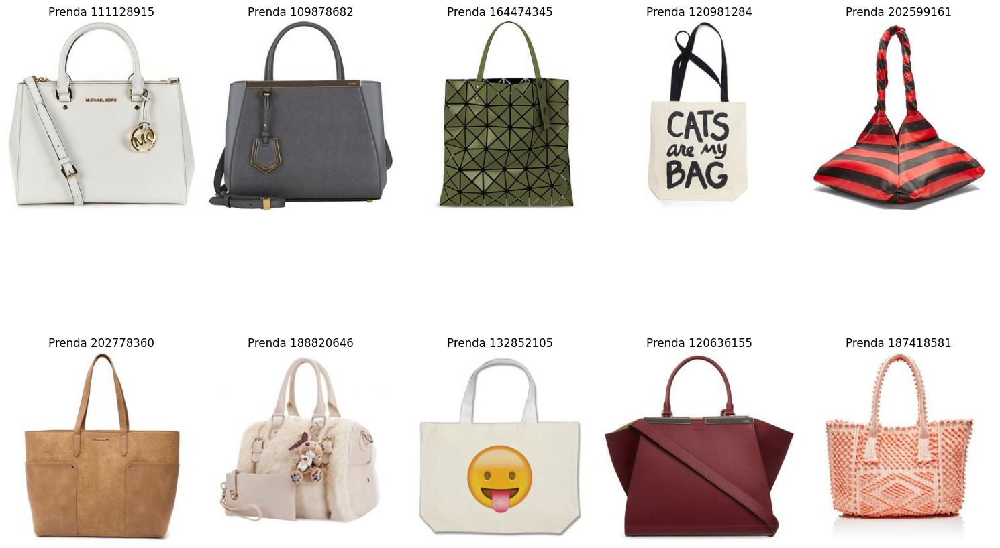


Cluster 4 (78 prendas):
 - Prenda 189103425: retro embossing argyle design womens
 - Prenda 149432020: chanel grand shopping tote
 - Prenda 127253684: tigmi shopper tote gold totes
 - Prenda 205098454: sharo leather alligator textured italian
 - Prenda 206682639: geunine leather handbag retro shoulder
 - Prenda 196304424: dolce gabbana handle bag sicily
 - Prenda 160594774: ostrich horiz ldn tote kurt
 - Prenda 201814264: prada midollino large leather-trimmed canvas
 - Prenda 211739437: marc jacobs daisy flower tote
 - Prenda 176952674: mm6 maison martin margiela handbags
  Mostrando 10 imágenes del cluster 4:


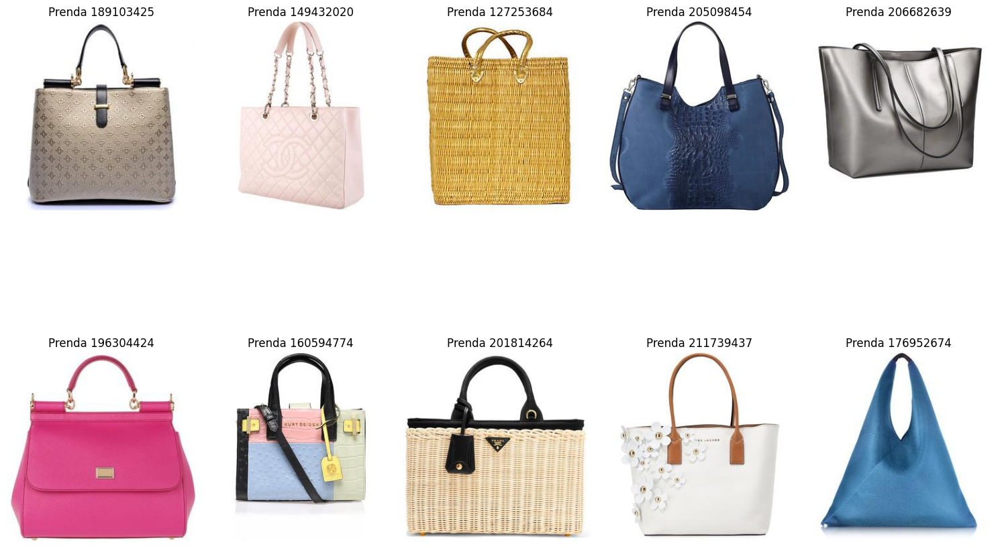


Cluster 5 (29 prendas):
 - Prenda 174739480: stylish magnetic closure transparent plastic
 - Prenda 215115744: light gray faux leather square
 - Prenda 60054241: preppy look tassel orange bag
 - Prenda 139234258: saint laurent sac de jour
 - Prenda 191781449: womens saint laurent baby sac
 - Prenda 191981591: michael kors jet set travel
 - Prenda 171178956: womens old trend forest island
 - Prenda 145609935: pre-owned prada tote
 - Prenda 204619466: aranaz banana tote bag
 - Prenda 204451251: nannacay natural straw cleo box
  Mostrando 10 imágenes del cluster 5:


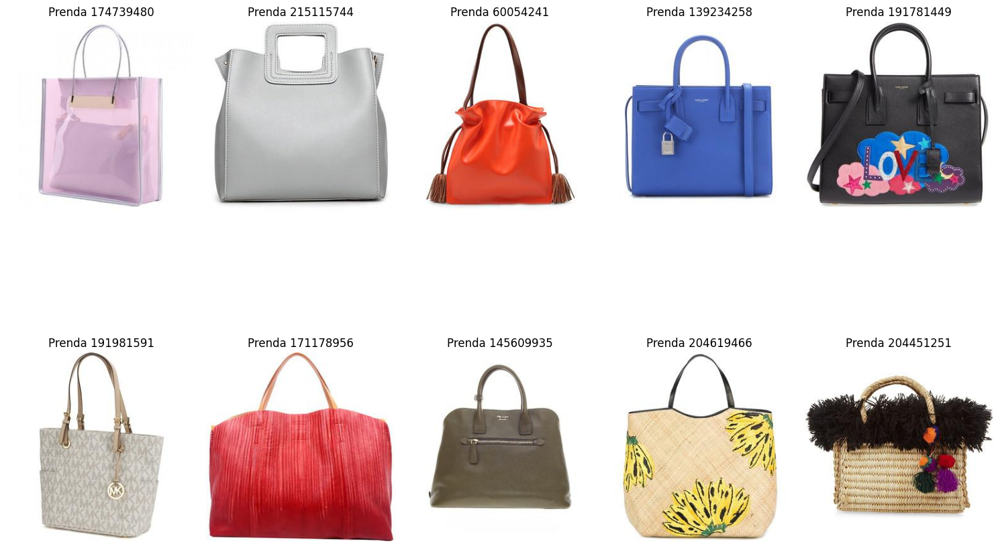


Cluster 6 (21 prendas):
 - Prenda 25441318: c%C3%A9line 6521 3gfl 04fg mini
 - Prenda 204631551: givenchy medium pandora tote bag
 - Prenda 72553028: meredith wendell circle canvas handbag
 - Prenda 200635127: figure print rivet cartoon tote
 - Prenda 152116238: burberry small banner house check
 - Prenda 32130227: longchamp roseau embossed tote gunmetal
 - Prenda 205140575: ermanno scervino straw basket tote
 - Prenda 170262970: melissa odabash barbados tote bag
 - Prenda 161951454: handbag republic red bow polka
 - Prenda 173854818: mcm handbags milla navy blue
  Mostrando 10 imágenes del cluster 6:


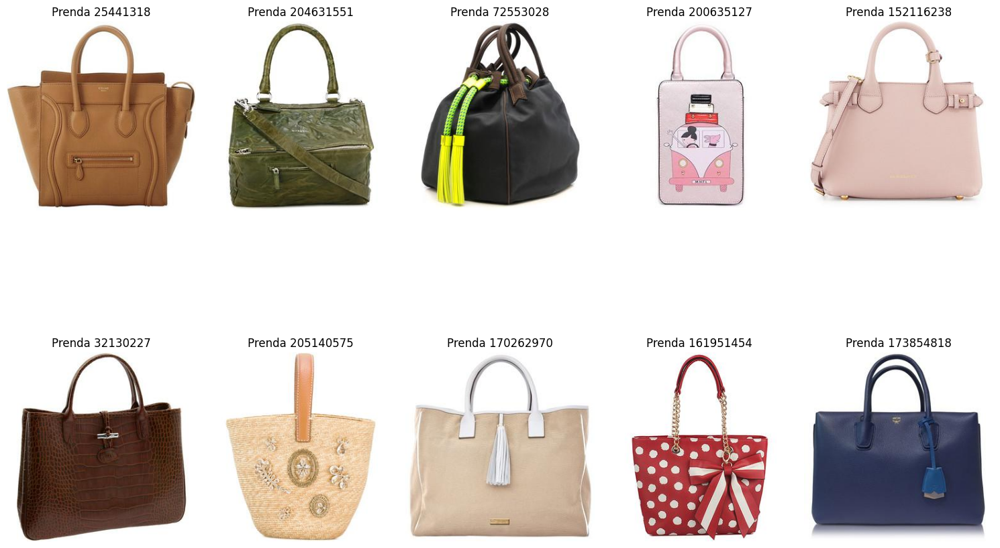


Cluster 7 (3 prendas):
 - Prenda 159208574: ted baker ethereal posie large
 - Prenda 188742624: christian dior handle bag lady
 - Prenda 157666616: pre-owned leather in pink rose
  Mostrando 3 imágenes del cluster 7:


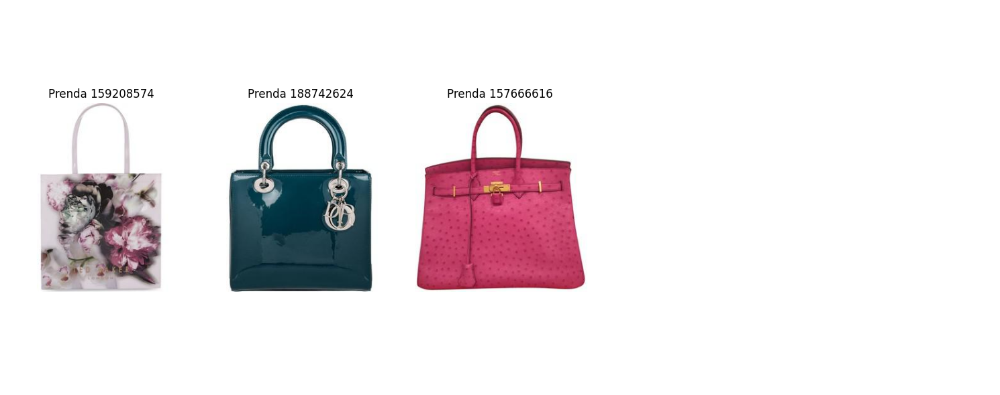


Cluster 8 (1 prendas):
 - Prenda 172309451: nine west coral it girl
  Mostrando 1 imágenes del cluster 8:


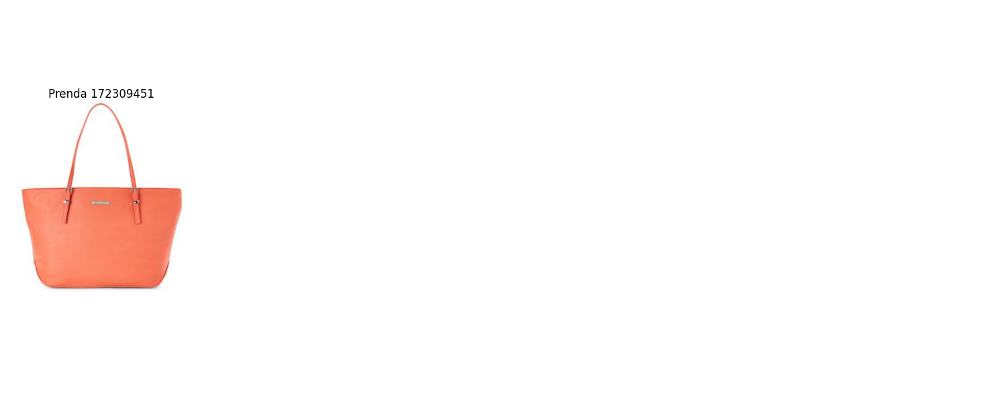


Cluster 9 (1 prendas):
 - Prenda 54947959: overstock.com online shopping bedding furniture
  Mostrando 1 imágenes del cluster 9:


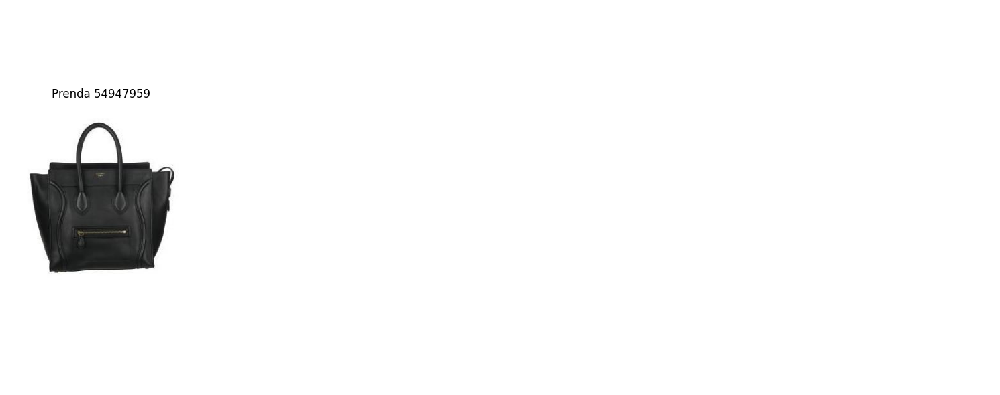


Cluster 16 (1 prendas):
 - Prenda 139436342: alexander mcqueen mini heroine snake-print
  Mostrando 1 imágenes del cluster 16:


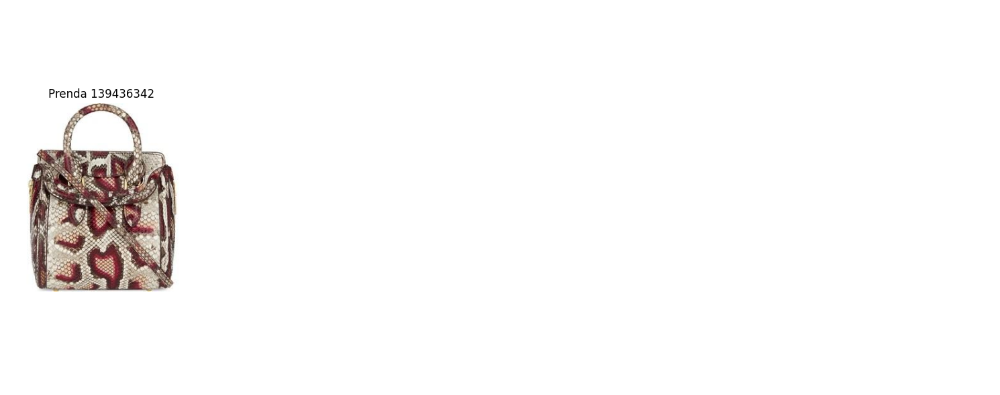


Cluster 18 (2 prendas):
 - Prenda 202286159: maison margiela glossed-leather tote
 - Prenda 204460175: michael kors circle handle tote
  Mostrando 2 imágenes del cluster 18:


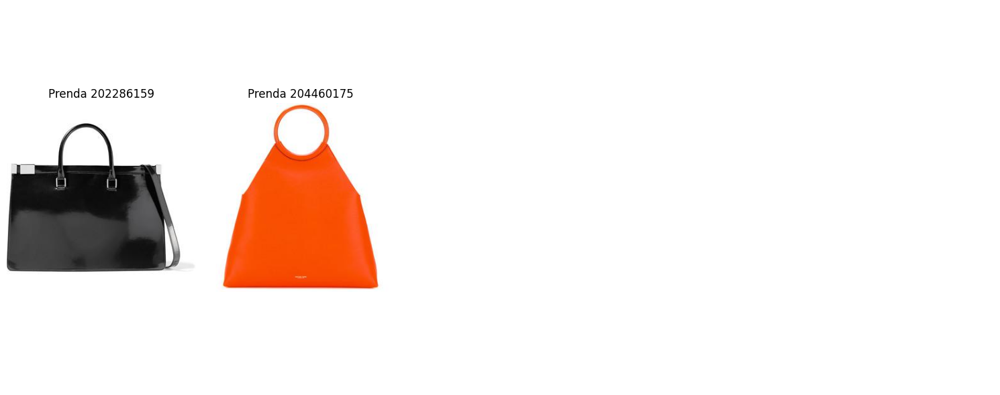


Cluster 19 (1 prendas):
 - Prenda 112526009: fendi white silver leather 3jours
  Mostrando 1 imágenes del cluster 19:


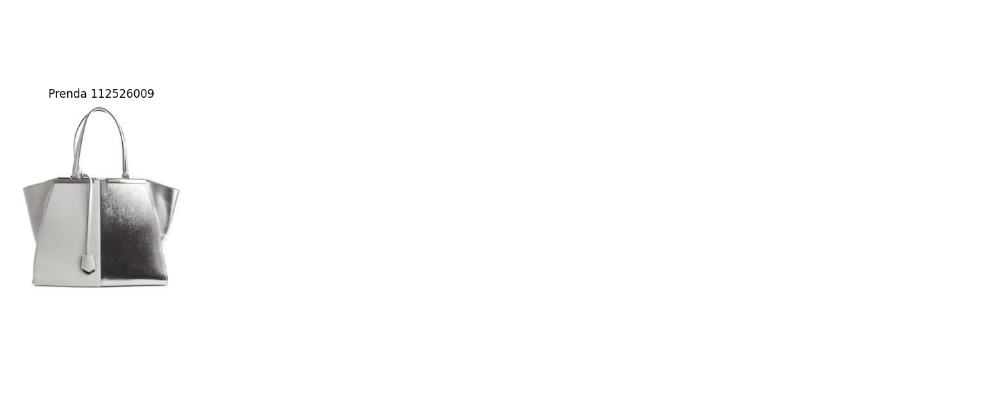


Cluster 25 (1 prendas):
 - Prenda 201302709: proenza schouler hava small leather
  Mostrando 1 imágenes del cluster 25:


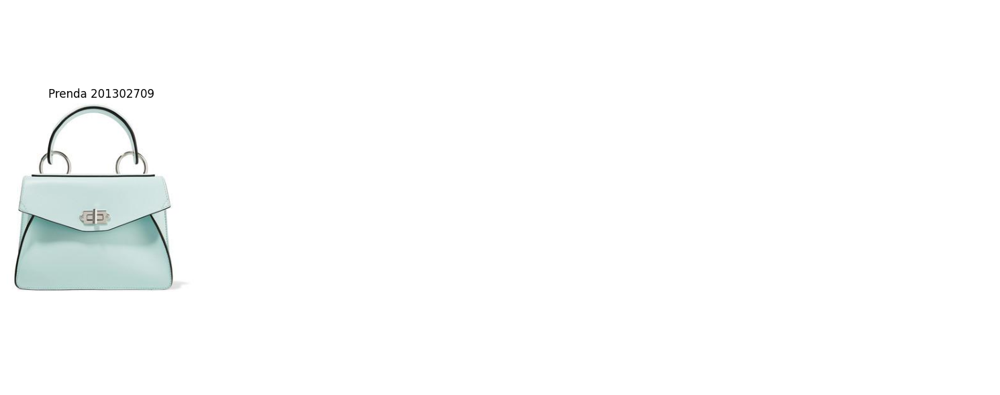


Cluster 32 (1 prendas):
 - Prenda 101041924: brelli tote
  Mostrando 1 imágenes del cluster 32:


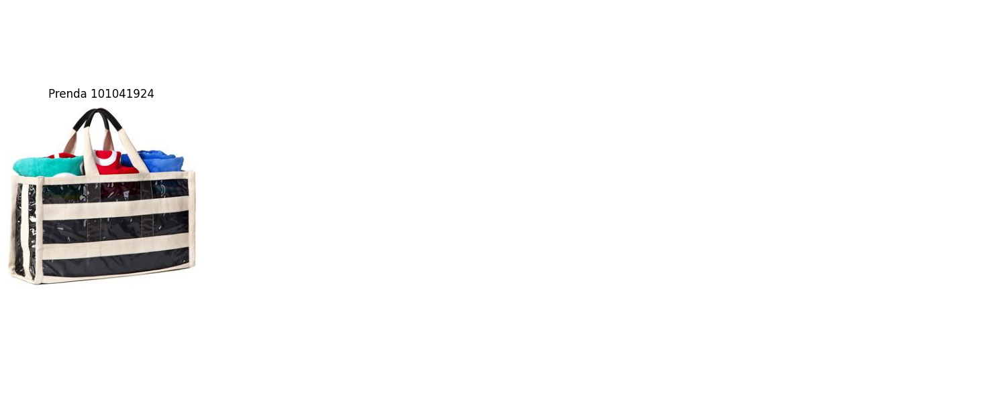


Cluster 35 (1 prendas):
 - Prenda 212529767: opening ceremony black striped terry
  Mostrando 1 imágenes del cluster 35:


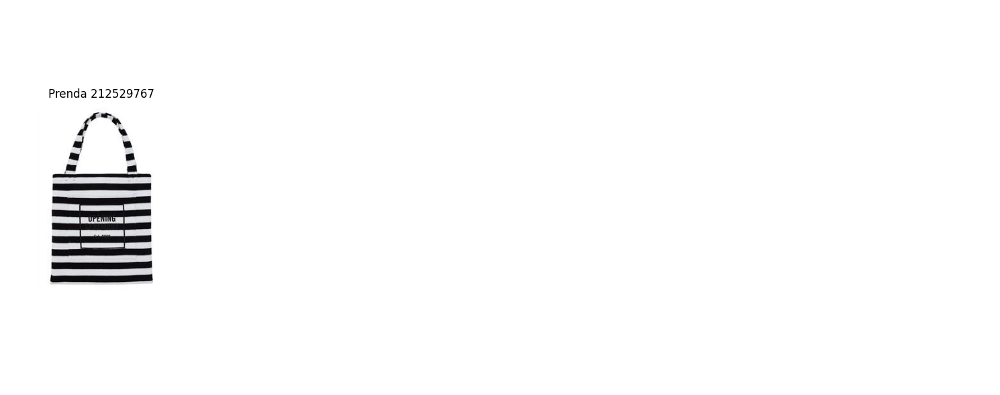


Cluster 39 (1 prendas):
 - Prenda 182433014: max mara hmor01 tote
  Mostrando 1 imágenes del cluster 39:


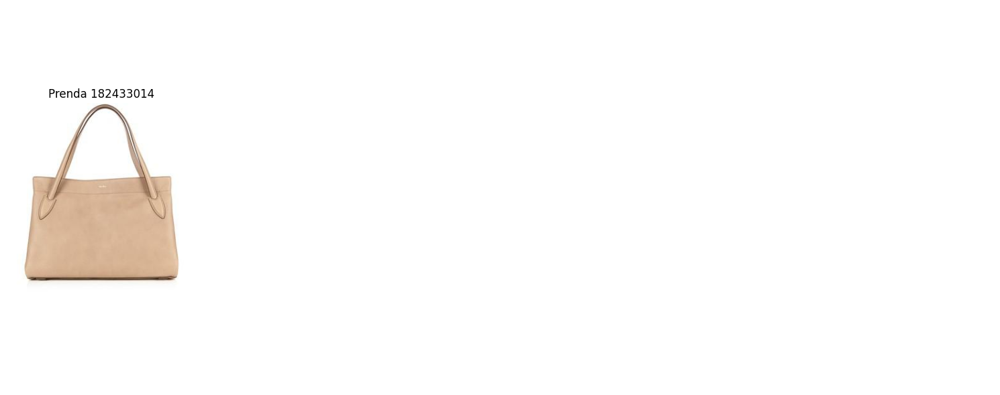


Cluster 41 (1 prendas):
 - Prenda 181570746: handbag mumu camilla british racing
  Mostrando 1 imágenes del cluster 41:


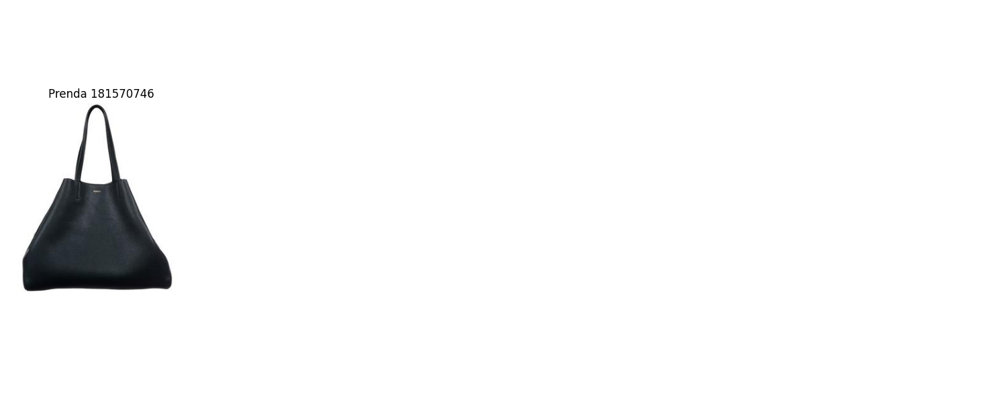


Cluster 45 (1 prendas):
 - Prenda 204229292: sophie anderson jonas stripe pompom-embellished
  Mostrando 1 imágenes del cluster 45:


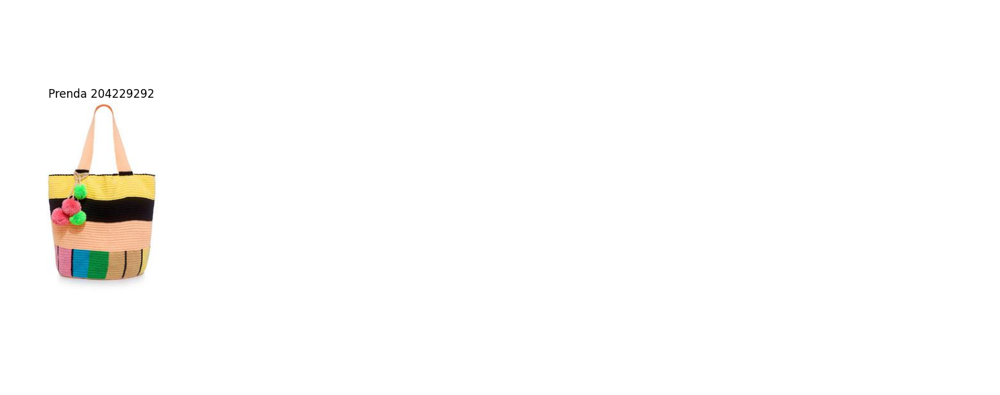


Cluster 71 (1 prendas):
 - Prenda 83558452: bottega veneta bi-colour shopper tote
  Mostrando 1 imágenes del cluster 71:


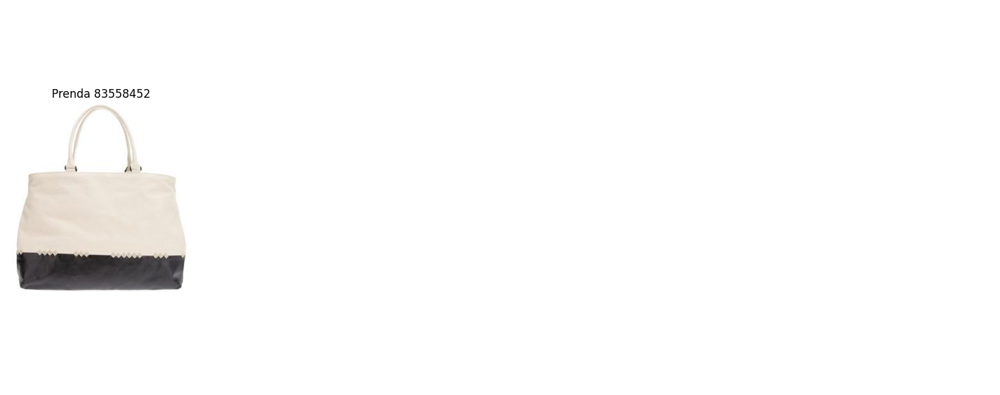


Cluster 95 (1 prendas):
 - Prenda 117124534: vivienne westwood accessories large monaco
  Mostrando 1 imágenes del cluster 95:


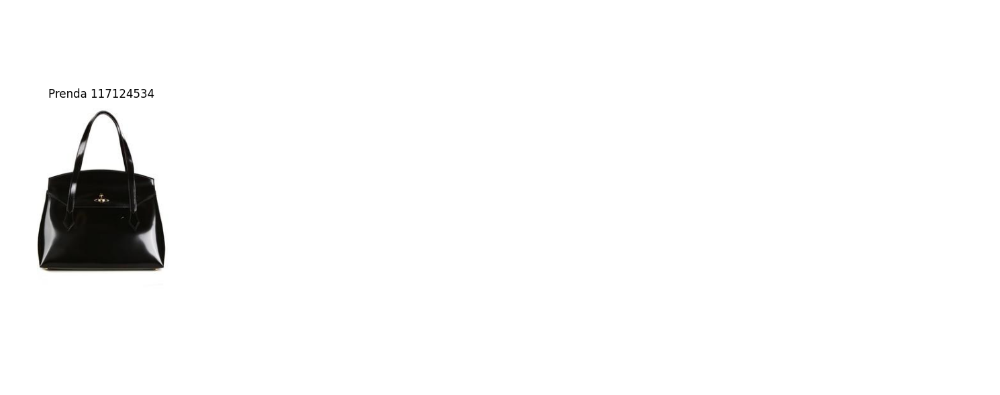

In [12]:
import os
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"
SUBCATEGORY = "bags"  # Subcategoría semántica
CATEGORY_ID = 36    # Subcategoría específica (ajusta según tus datos, por ejemplo, cat15)

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)[:100] + "..." if len(' '.join(parts)) > 100 else ' '.join(parts)

def show_cluster_examples():
    """Muestra 10 ejemplos de prendas por cluster y visualiza sus imágenes."""
    # Cargar metadatos
    metadata = load_metadata()
    
    # Ruta al CSV de la subcategoría
    csv_path = os.path.join(OUTPUT_DIR, SUBCATEGORY, f'cat{CATEGORY_ID}_hdp_clusters.csv')
    
    try:
        clusters_df = pd.read_csv(csv_path)
        print(f"Cargado {csv_path} con {len(clusters_df)} prendas")
    except FileNotFoundError:
        print(f"No se encontró {csv_path}. Verifica CATEGORY_ID o si los CSVs se generaron.")
        print("CSVs disponibles en hlda_outputs/tops/:")
        import glob
        csv_files = glob.glob(os.path.join(OUTPUT_DIR, SUBCATEGORY, "cat*.csv"))
        print([os.path.basename(f) for f in csv_files])
        return
    
    # Agrupar por cluster
    clusters = defaultdict(list)
    for _, row in clusters_df.iterrows():
        item_id = str(row['item_id'])
        cluster_id = row['cluster']
        if item_id in metadata:
            clusters[cluster_id].append((item_id, metadata[item_id]))
    
    # Mostrar ejemplos y visualizar
    for cluster_id in sorted(clusters.keys()):
        if cluster_id == -1:  # Saltar prendas sin cluster asignado
            continue
        print(f"\nCluster {cluster_id} ({len(clusters[cluster_id])} prendas):")
        
        # Mostrar hasta 10 ejemplos
        examples = clusters[cluster_id][:10]
        for item_id, item in examples:
            description = get_item_description(item)
            print(f" - Prenda {item_id}: {description}")
        
        # Visualizar imágenes
        num_items_to_show = min(10, len(examples))
        if num_items_to_show == 0:
            print("  No hay prendas para visualizar en este cluster.")
            continue
        
        images_per_row = 5
        num_rows = (num_items_to_show + images_per_row - 1) // images_per_row
        fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
        # Asegurar que axes sea un array 1D de Axes objects
        axes = axes.flatten() if num_rows * images_per_row > 1 else [axes] if num_items_to_show == 1 else axes
        
        print(f"  Mostrando {num_items_to_show} imágenes del cluster {cluster_id}:")
        for i, (item_id, _) in enumerate(examples):
            image_path = f"datasets/polyvore/images/{item_id}.jpg"
            try:
                img = mpimg.imread(image_path)
                axes[i].imshow(img)
                axes[i].set_title(f"Prenda {item_id}")
                axes[i].axis('off')
            except Exception as e:
                axes[i].text(0.5, 0.5, f"No se pudo cargar\nPrenda {item_id}\n{e}",
                             ha='center', va='center', fontsize=10, color='red')
                axes[i].axis('off')
        
        # Ocultar ejes vacíos
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

# Ejecutar
show_cluster_examples()

# Con todos los outfits de train, valid y test

In [15]:
import os
import json
import pickle
import pandas as pd
import numpy as np
from collections import defaultdict
from gensim.models import HdpModel
from gensim.corpora import Dictionary
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
import logging
from tqdm import tqdm
import shutil
import gc

# Configurar logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s')

# Descargar recursos de NLTK
nltk.download('punkt', quiet=True)
nltk.download('stopwords', quiet=True)

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
TRAIN_PATH = "datasets/polyvore/nondisjoint/train.json"
OUTPUT_DIR = "hlda_outputs"
MODEL_PATH = os.path.join(OUTPUT_DIR, "hdp_model.gensim")
CORPUS_PATH = os.path.join(OUTPUT_DIR, "corpus.pkl")
CHECKPOINT_DIR = os.path.join(OUTPUT_DIR, "checkpoints")
MIN_DF = 10  # Frecuencia mínima de palabras
MAX_DF = 0.3  # Frecuencia máxima de palabras
MAX_OUTFITS = None # Máximo número de outfits para pruebas

def check_disk_space(path):
    """Verifica si hay suficiente espacio en disco."""
    dir_path = os.path.dirname(path) or os.getcwd()
    try:
        total, used, free = shutil.disk_usage(dir_path)
        free_gb = free / (2**30)
        logging.info(f"Espacio libre en disco ({dir_path}): {free_gb:.2f} GB")
        if free_gb < 1:
            raise RuntimeError("Espacio en disco insuficiente (< 1 GB).")
    except FileNotFoundError as e:
        logging.error(f"Directorio no encontrado: {dir_path}. Error: {e}")
        raise
    except OSError as e:
        logging.error(f"Error al verificar espacio en disco para {dir_path}: {e}")
        raise

def ensure_writable_dir(directory):
    """Asegura que el directorio sea escribible."""
    try:
        os.makedirs(directory, exist_ok=True)
        if not os.access(directory, os.W_OK):
            raise PermissionError(f"No se tienen permisos de escritura en {directory}")
    except OSError as e:
        logging.error(f"Error al crear/verificar directorio {directory}: {e}")
        raise

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        logging.info(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        logging.error(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        logging.error(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def load_outfits():
    outfits = []
    for file in [TRAIN_PATH, "datasets/polyvore/nondisjoint/valid.json", "datasets/polyvore/nondisjoint/test.json"]:
        try:
            with open(file, 'r') as f:
                outfits.extend(json.load(f))
        except FileNotFoundError as e:
            logging.error(f"No se encontró {file}: {e}")
        except json.JSONDecodeError as e:
            logging.error(f"Error al decodificar {file}: {e}")
    logging.info(f"Cargados {len(outfits)} outfits")
    return outfits

def preprocess_text(text):
    """Preprocesa el texto: tokeniza, elimina stop words y puntuación."""
    stop_words = set(stopwords.words('english') + list(string.punctuation))
    tokens = word_tokenize(text.lower())
    tokens = [t for t in tokens if t not in stop_words and t.isalnum() and len(t) > 2]
    return tokens

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)

def prepare_corpus(outfits, metadata):
    """Prepara el corpus para HDP: documentos (outfits) y diccionario."""
    documents = []
    item_to_outfits = defaultdict(list)
    
    for outfit in tqdm(outfits, desc="Procesando outfits"):
        item_ids = [str(item_id) for item_id in outfit['item_ids']]
        valid_items = [item_id for item_id in item_ids if item_id in metadata]
        if not valid_items:
            continue
        outfit_text = ' '.join(get_item_description(metadata[item_id]) for item_id in valid_items)
        tokens = preprocess_text(outfit_text)
        if tokens:
            documents.append(tokens)
            for item_id in valid_items:
                item_to_outfits[item_id].append(len(documents) - 1)
    
    # Crear diccionario y filtrar vocabulario
    dictionary = Dictionary(documents)
    dictionary.filter_extremes(no_below=MIN_DF, no_above=MAX_DF)
    logging.info(f"Vocabulario reducido a {len(dictionary)} palabras")
    
    # Crear corpus (bag-of-words)
    corpus = [dictionary.doc2bow(doc) for doc in documents]
    
    logging.info(f"Preparados {len(documents)} documentos válidos")
    return corpus, dictionary, documents, item_to_outfits

def train_hdp(corpus, dictionary, max_iterations=200):
    """Entrena un modelo HDP o lo carga si ya existe."""
    ensure_writable_dir(OUTPUT_DIR)
    ensure_writable_dir(CHECKPOINT_DIR)
    check_disk_space(MODEL_PATH)
    
    if os.path.exists(MODEL_PATH):
        logging.info(f"Cargando modelo HDP desde {MODEL_PATH}")
        hdp = HdpModel.load(MODEL_PATH)
        with open(CORPUS_PATH, 'rb') as f:
            saved_corpus = pickle.load(f)
        return hdp, saved_corpus
    
    hdp = HdpModel(
        corpus,
        dictionary,
        T=100,
        K=20,
        alpha=1.0,
        gamma=1.0,
        eta=0.5
    )
    
    checkpoint_interval = 50
    for i in tqdm(range(0, max_iterations, 10), desc="Entrenando HDP"):
        hdp.update(corpus)
        logging.info(f"Iteración {i+10} completada")
        
        if (i + 10) % checkpoint_interval == 0:
            checkpoint_path = os.path.join(CHECKPOINT_DIR, f"hdp_checkpoint_iter_{i+10}.gensim")
            try:
                hdp.save(checkpoint_path)
                logging.info(f"Checkpoint guardado en {checkpoint_path}")
            except Exception as e:
                logging.error(f"Error al guardar checkpoint en iteración {i+10}: {e}")
    
    try:
        hdp.save(MODEL_PATH)
        logging.info(f"Modelo final guardado en {MODEL_PATH}")
    except Exception as e:
        logging.error(f"Error al guardar modelo final: {e}")
        raise
    
    with open(CORPUS_PATH, 'wb') as f:
        pickle.dump(corpus, f)
    logging.info(f"Corpus guardado en {CORPUS_PATH}")
    
    return hdp, corpus

def assign_clusters(hdp, corpus, item_to_outfits, metadata, dictionary):
    """Asigna clusters a cada prenda basándose en los temas de HDP."""
    doc_topic_dists = []
    for i in tqdm(range(0, len(corpus), 500), desc="Infiriendo temas"):
        batch = corpus[i:i + 500]
        batch_dists = [hdp[doc] for doc in batch]
        doc_topic_dists.extend(batch_dists)
        del batch_dists
        gc.collect()
    
    num_items = len(item_to_outfits)
    item_ids = list(item_to_outfits.keys())
    item_topic_probs = np.zeros((num_items, hdp.m_T), dtype=np.float32)
    
    for idx, item_id in enumerate(tqdm(item_ids, desc="Calculando probabilidades por prenda")):
        doc_indices = item_to_outfits[item_id]
        for doc_idx in doc_indices:
            for topic_id, prob in doc_topic_dists[doc_idx]:
                item_topic_probs[idx, topic_id] += prob
        total = item_topic_probs[idx].sum()
        if total > 0:
            item_topic_probs[idx] /= total
    
    clusters_by_category = defaultdict(list)
    for idx, item_id in enumerate(item_ids):
        if item_id not in metadata:
            continue
        semantic_cat = metadata[item_id].get('semantic_category', 'unknown')
        category_id = metadata[item_id].get('category_id', 'unknown')
        probs = item_topic_probs[idx]
        cluster = np.argmax(probs) if probs.sum() > 0 else -1
        clusters_by_category[(semantic_cat, category_id)].append({
            'item_id': item_id,
            'cluster': cluster,
            'probs': probs.tolist()
        })
    
    ensure_writable_dir(OUTPUT_DIR)
    for (semantic_cat, category_id), items in clusters_by_category.items():
        output_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        ensure_writable_dir(output_dir)
        df = pd.DataFrame(items)
        output_file = os.path.join(output_dir, f'cat{category_id}_hdp_clusters.csv')
        df.to_csv(output_file, index=False)
        logging.info(f"Guardados clusters para {semantic_cat}/cat{category_id} en {output_file}")

def inspect_clusters(hdp, metadata, item_to_outfits, corpus, dictionary, top_n_words=10, top_n_items=5):
    """Inspecciona los temas (clusters) mostrando palabras y prendas representativas."""
    logging.info("Inspeccionando clusters...")
    for topic_id in range(min(20, hdp.m_T)):
        words = hdp.show_topic(topic_id, topn=top_n_words)
        logging.info(f"\nCluster {topic_id}:")
        logging.info(f"Palabras más probables: {', '.join(f'{w} ({p:.4f})' for w, p in words)}")
        
        item_scores = []
        for item_id, doc_indices in item_to_outfits.items():
            probs = np.zeros(hdp.m_T)
            for doc_idx in doc_indices:
                doc_probs = hdp[corpus[doc_idx]]
                for tid, prob in doc_probs:
                    probs[tid] += prob
            total = probs.sum()
            if total > 0:
                probs /= total
            item_scores.append((item_id, probs[topic_id]))
        
        item_scores = sorted(item_scores, key=lambda x: x[1], reverse=True)[:top_n_items]
        logging.info("Prendas representativas:")
        for item_id, score in item_scores:
            item = metadata.get(item_id, {})
            description = get_item_description(item)[:50] + "..." if item else "Desconocida"
            logging.info(f" - Prenda {item_id} (score: {score:.4f}): {description}")

def main():
    ensure_writable_dir(OUTPUT_DIR)
    check_disk_space(OUTPUT_DIR)
    
    metadata = load_metadata()
    outfits = load_outfits()
    
    corpus, dictionary, documents, item_to_outfits = prepare_corpus(outfits, metadata)
    
    logging.info("Entrenando o cargando modelo HDP...")
    hdp, corpus = train_hdp(corpus, dictionary, max_iterations=200)
    
    inspect_clusters(hdp, metadata, item_to_outfits, corpus, dictionary)
    
    logging.info("Asignando clusters a prendas...")
    assign_clusters(hdp, corpus, item_to_outfits, metadata, dictionary)

if __name__ == "__main__":
    main()

2025-05-26 20:39:30,785 - INFO - Espacio libre en disco (/Users/lara/UNI/4imatLOCAL/TFG/TFG_CLIP): 4.58 GB
2025-05-26 20:39:32,257 - INFO - Cargados 251008 metadatos de prendas
2025-05-26 20:39:32,643 - INFO - Cargados 68306 outfits
Procesando outfits: 100%|██████████| 68306/68306 [00:29<00:00, 2353.93it/s]
2025-05-26 20:40:01,664 - INFO - adding document #0 to Dictionary<0 unique tokens: []>
2025-05-26 20:40:01,994 - INFO - adding document #10000 to Dictionary<27393 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...>
2025-05-26 20:40:02,319 - INFO - adding document #20000 to Dictionary<37764 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...>
2025-05-26 20:40:02,659 - INFO - adding document #30000 to Dictionary<45152 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...>
2025-05-26 20:40:02,970 - INFO - adding document #40000 to Dictionary<51180 unique tokens: ['authentic', 'bean', 'blend', 'blouses', 'body']...>
2025-05-26 20:40:03,276 

Cargados 251008 metadatos de prendas
Cargado hlda_outputs/tops/cat17_hdp_clusters.csv con 4956 prendas

Cluster 0 (2289 prendas):
 - Prenda 194799164: floral embroidered flounce blouse white Floral embroidered flounce blouse in white at Twinkledeals.c...
 - Prenda 184587087: iro womens greta mock neck A boxy blouse with mock neckline and long sleeves.  Zip closure at back. ...
 - Prenda 126047523: rotita long sleeve chiffon leopard Style:Casual.  Collar:Turndown Collar.  Sleeve's Length:Long Slee...
 - Prenda 201897442: yoins neck blouse with adjustable There is no doubt that basics are getting better and better with p...
 - Prenda 181349496: chloe lace silk blouse Colour: black Composition 100% polyamide  Composition II 100% silk  Lining 10...
 - Prenda 97503867: elizabeth james brendan sleeveless crop With a sheer chiffon panel at the shoulders plus an exposed ...
 - Prenda 143059889: joseph crepe de chine ambroise Long sleeve Crepe de Chine Ambroise Blouse in black.  A vintage-inspi

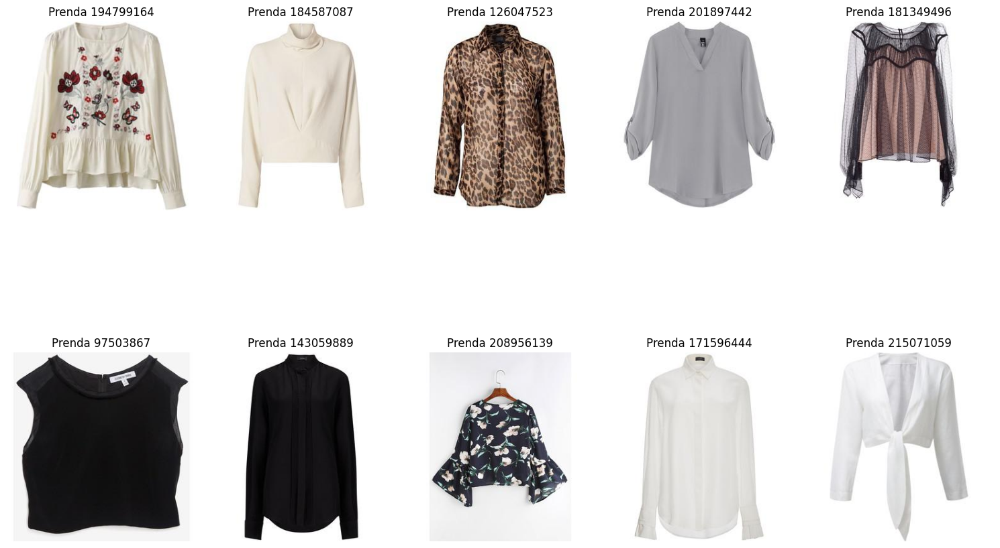


Cluster 1 (390 prendas):
 - Prenda 178910242: tie-neck blouse Flowy fabric, V-neck, Decorative bow, Long sleeve with buttoned cuffs, Side slit hem...
 - Prenda 115700751: cotton blouse Gently tailored blouse in airy cotton with pearly buttons, and long sleeves that can b...
 - Prenda 63966674: full tilt lace back womens Full Tilt shirt. Button front. Allover plaid. Slip chest pocket. Lace bac...
 - Prenda 147300271: long sleeve loose turn-down collar Material:Cotton, Polyester Style:Casual,Modern Collar:V Neck Slee...
 - Prenda 174531482: derek lam 10 crosby striped Black and cream silk striped bell sleeve blouse from Derek Lam 10 Crosby...
 - Prenda 42677194: chic shirt clothing new clothes Chic shirt, Chic clothing, New clothes, Romwe.com Blue shirt Shirt t...
 - Prenda 201152713: dondup checked off shoulder blouse Pink cotton checked off shoulder blouse from Dondup. Color: Pink/...
 - Prenda 100754012: owl pattern chiffon blouse
 - Prenda 197211890: mesh panel floral embroidered bl

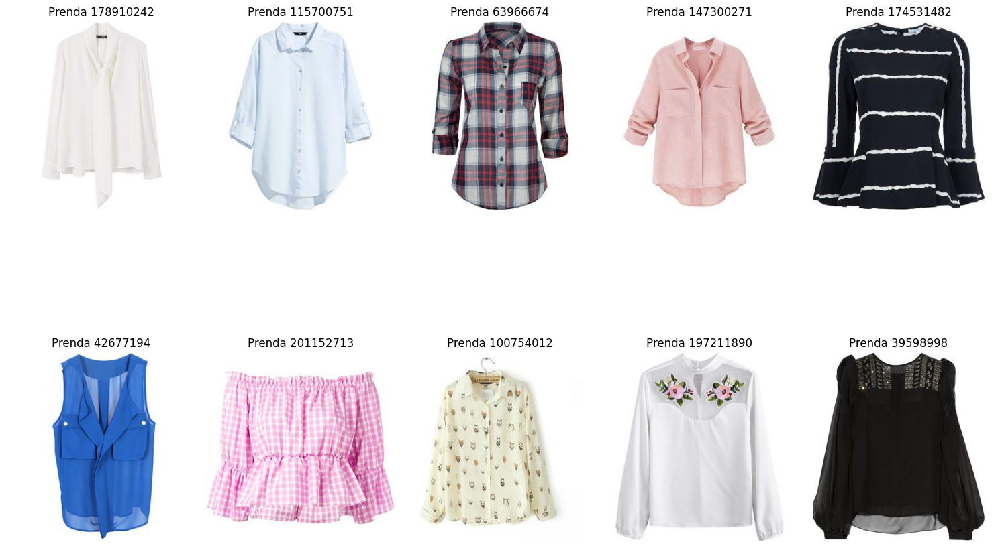


Cluster 2 (768 prendas):
 - Prenda 118413023: shein sheinside white lapel long White Cute Lapel Long Sleeve Polyester Plain Fall Blouses, Size Ava...
 - Prenda 143402157: alexander mcqueen blouse Crêpe No appliqués Solid colour Round collar Short sleeves Rear closure Hoo...
 - Prenda 183743678: spaghetti strap crochet patchwork black Spaghetti Strap Crochet Patchwork Black Blouse Spaghetti Str...
 - Prenda 139424673: mango linen-blend striped blouse Linen and cotton mix, short sleeve, striped print, teardrop fasteni...
 - Prenda 183609068: shein sheinside pink eyelet crochet Pink Beach Round Neck Long Sleeve Polyester Plain Crop Fabric ha...
 - Prenda 173413421: blouse camo
 - Prenda 174891146: high-low printed collarless long sleeve Shop for High-Low Printed Collarless Long Sleeve Blouse at Z...
 - Prenda 204716810: chicwish stripes charisma top with Gotta earn your stripes, babe, and there’s no better way to own t...
 - Prenda 49117062: prabal gurung ruffled blouse Deep v-neck long 

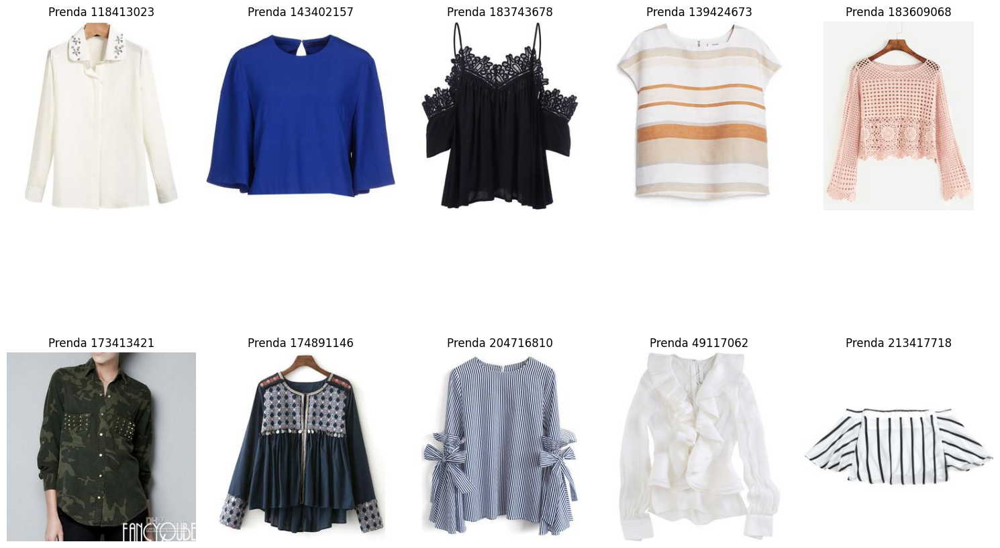


Cluster 3 (1337 prendas):
 - Prenda 22653517: charlie
 - Prenda 204298322: rosie assoulin asymmetric ruffled blouse Navy blue and white cotton blend asymmetric ruffled blouse ...
 - Prenda 169480508: blumarine blouse
 - Prenda 213469439: spaghetti strap ruffle blouse yellow
 - Prenda 191199166: stella mccartney striped cotton-blend blouse Stella McCartney's blouse is cut from airy cotton-blend...
 - Prenda 200044782: oscar de la renta metallic Bringing Oscar de la Renta’s refined femininity to evening looks, this to...
 - Prenda 164167001: rodarte chantilly lace draped blouse
 - Prenda 211024550: leaves print neck self tie
 - Prenda 149524212: cushnie et ochs pearl-trimmed silk-georgette
 - Prenda 210758800: zimmermann sleeveless lace blouse BLACK Natural (Vegetable)->Cotton Sleeveless Lace Blouse from Zimm...
  Mostrando 10 imágenes del cluster 3:


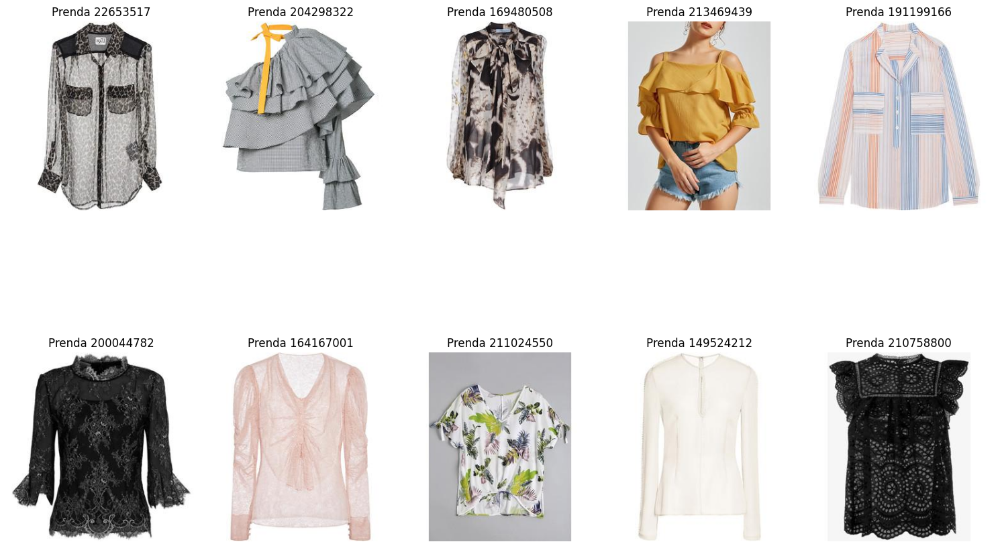


Cluster 4 (115 prendas):
 - Prenda 179791046: croosover poplin blouse Premium Collection, Cotton poplin, Crossover design, V-neck, Short sleeve, S...
 - Prenda 209360524: mogul womens red tank top
 - Prenda 169841987: caroline constas carmen off shoulder From the emerging New York-based designer comes this *Caroline ...
 - Prenda 213367105: beauty youth slit detail strapless
 - Prenda 205175954: tribal print off shoulder cropped Shop for Tribal Print Off The Shoulder Cropped Blouse at ZAFUL. Fr...
 - Prenda 207732252: lace insert chiffon high low
 - Prenda 208671438: ruffled stripe-patterned blouse Cotton fabric, Combined flowers and striped print, Decortive frill d...
 - Prenda 146349994: white lapel vertical striped self-tie White Lapel Vertical Striped Self-Tie Blouse Size Available :S...
 - Prenda 180506123: luisa beccaria chiffon printed peasant This *Luisa Beccaria** top features an off the shoulder neckl...
 - Prenda 207274455: vita kin all stars embroidered Vita Kin's white li

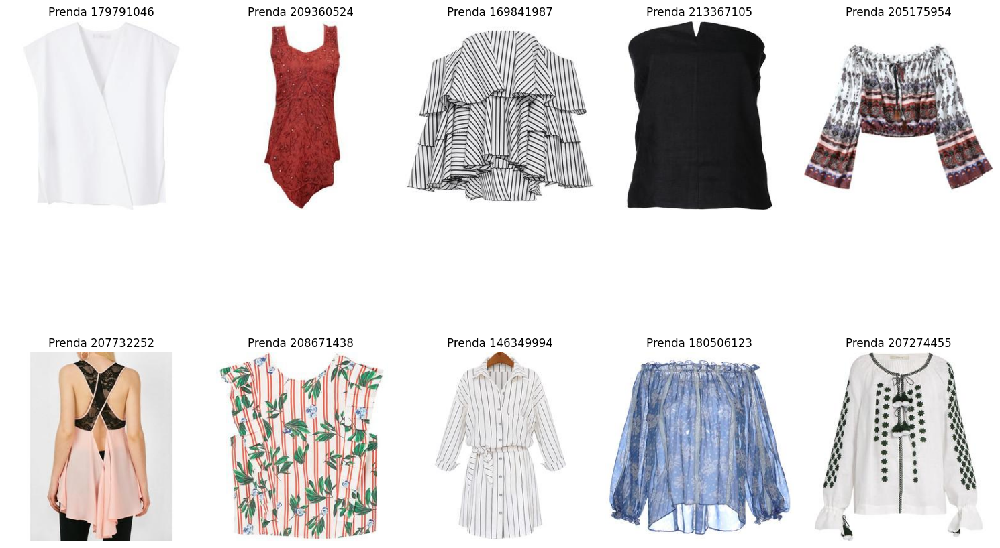


Cluster 5 (9 prendas):
 - Prenda 213547342: alexis regine white ruffled gypsy
 - Prenda 171629819: see-through embroidery shirt collar butterfly
 - Prenda 214968679: marissa webb coralie bow ties This Coralie button-up by Marissa Webb breaks all the rules with backl...
 - Prenda 183786563: volantbluse 39 99 Blau/Gestreift. Baumwollbluse mit kurzem Stehkragen, verdeckter Knopfleiste und le...
 - Prenda 183650930: shein sheinside burgundy crochet insert
 - Prenda 189860013: sequined neck asymmetric blouse
 - Prenda 148680591: lighting day blouse
 - Prenda 211823124: square neck striped smocked babydoll Shop for Square Neck Striped Smocked Babydoll Top BLUE: Blouses...
 - Prenda 210360230: lace trim cold shoulder blouse
  Mostrando 9 imágenes del cluster 5:


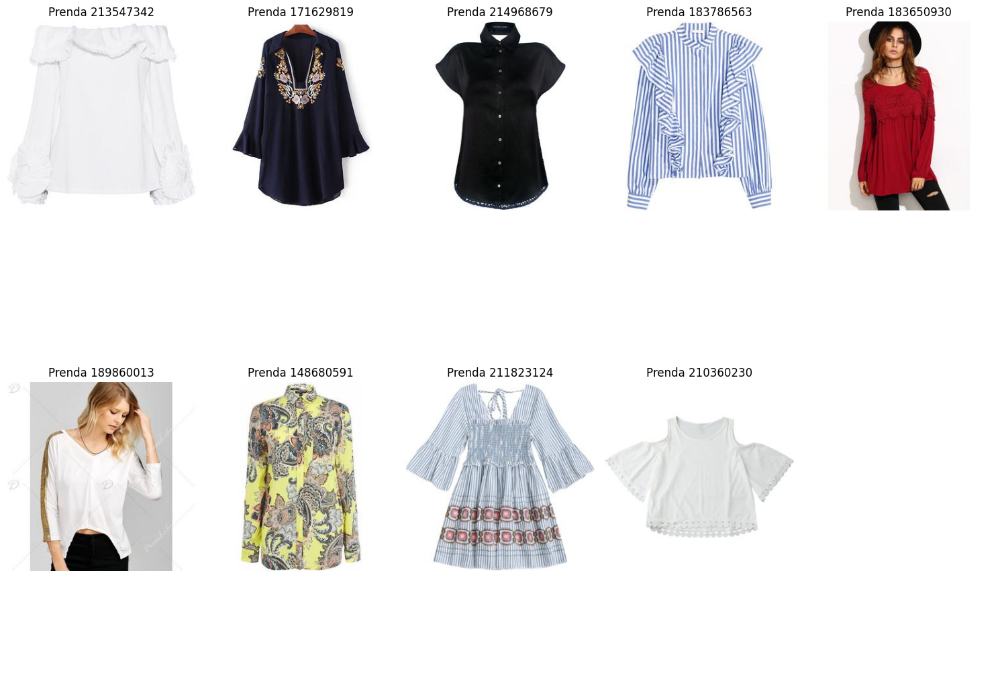


Cluster 6 (19 prendas):
 - Prenda 142813040: long-sleeved pintuck blouse
 - Prenda 208988201: off-the-shoulder blouse 19.99
 - Prenda 207431755: back slit stand neck sleeve
 - Prenda 182827779: striped off shoulder cropped blouse
 - Prenda 210958041: pinstripe flounce blouse Cheap Blue S Blouses&Shirts online, Gamiss offers you Pinstripe Flounce Blo...
 - Prenda 202605052: river island grey stripe oversized
 - Prenda 200277894: adjustable sleeves blouse
 - Prenda 100819915: giambattista valli ruffle overlay blouse Giambattista Valli Ruffle Overlay Blouse Giambattista Valli...
 - Prenda 208255290: brooks brothers gingham cotton poplin
 - Prenda 188712913: boat neck gingham check blouse Fashion Clothing Site with greatest number of Latest casual style Dre...
  Mostrando 10 imágenes del cluster 6:


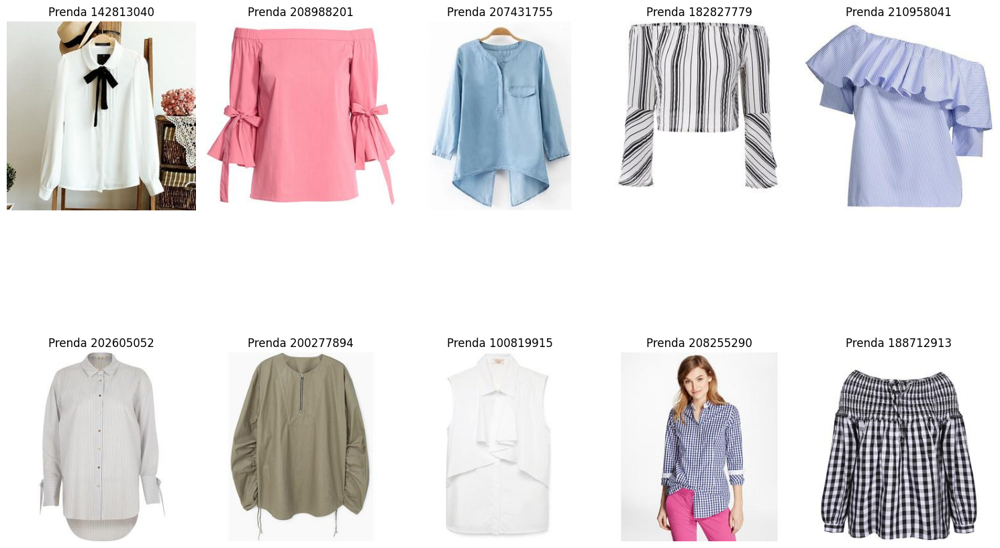


Cluster 7 (10 prendas):
 - Prenda 198226245: silk blouse 49.99
 - Prenda 170617221: trendy womens ethnic print neck
 - Prenda 207098186: neck ruched belted blouse
 - Prenda 181288959: shein sheinside brown long sleeve
 - Prenda 59554867: equipment cheetah-print silk blouse
 - Prenda 194646860: mafalda von hessen neck-tie silk
 - Prenda 198386093: shein sheinside navy bow front
 - Prenda 59628406: charvet ファッション誌『VOGUE JAPAN』の公式サイト。『VOGUE JAPAN』で掲載されたファッションアイテムの検索ページ。ファッションアイテム名からはもちろん、ファッションブランド...
 - Prenda 40593205: to be chic %E3%82%B3%E3%83%83%E3%83%88%E3%83%B3%E3%82%B7%E3%83%AB%E3%82%AF %E3%82%B8%E3%83%A3%E3%83%...
 - Prenda 82144796: elegant large turndown collar solid
  Mostrando 10 imágenes del cluster 7:


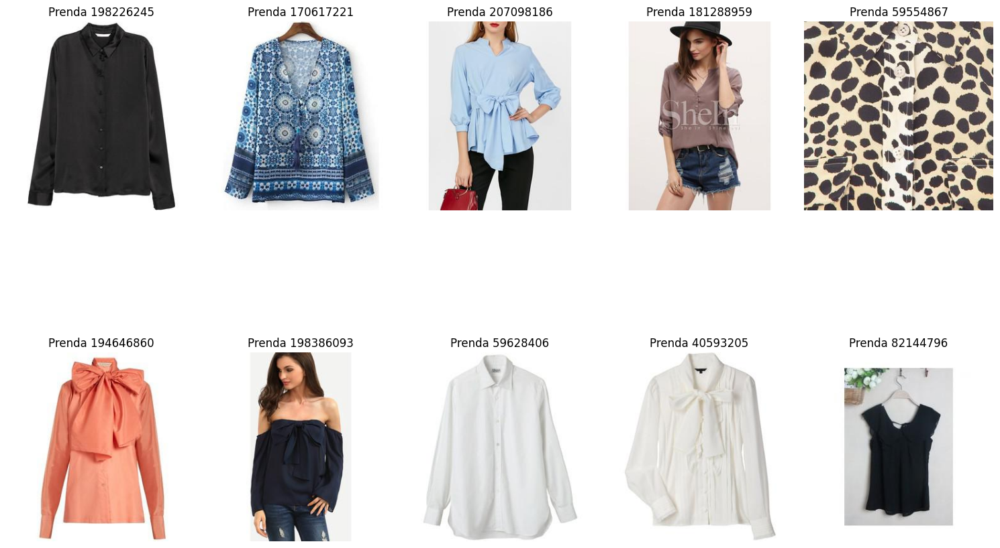


Cluster 8 (9 prendas):
 - Prenda 212395339: mania blouse
 - Prenda 207603339: blouse %C3%A9paules nues imprim%C3%A9e Blouse Épaules Nues Imprimée à découvrir ici et faites vos ac...
 - Prenda 203051828: loewe crystal dot blouse
 - Prenda 60803551: soaked in luxury top plura
 - Prenda 192748138: checked neck high low blouse
 - Prenda 211032149: lace-collared blouse 24.99 Naturweiß. Ärmellose Bluse aus Viskose mit Spitzenkragen. Die Bluse ist l...
 - Prenda 204084662: maison margiela pleated front sleeveless
 - Prenda 208107867: halcyon days blouse
 - Prenda 213898649: tropical print knot front blouse
  Mostrando 9 imágenes del cluster 8:


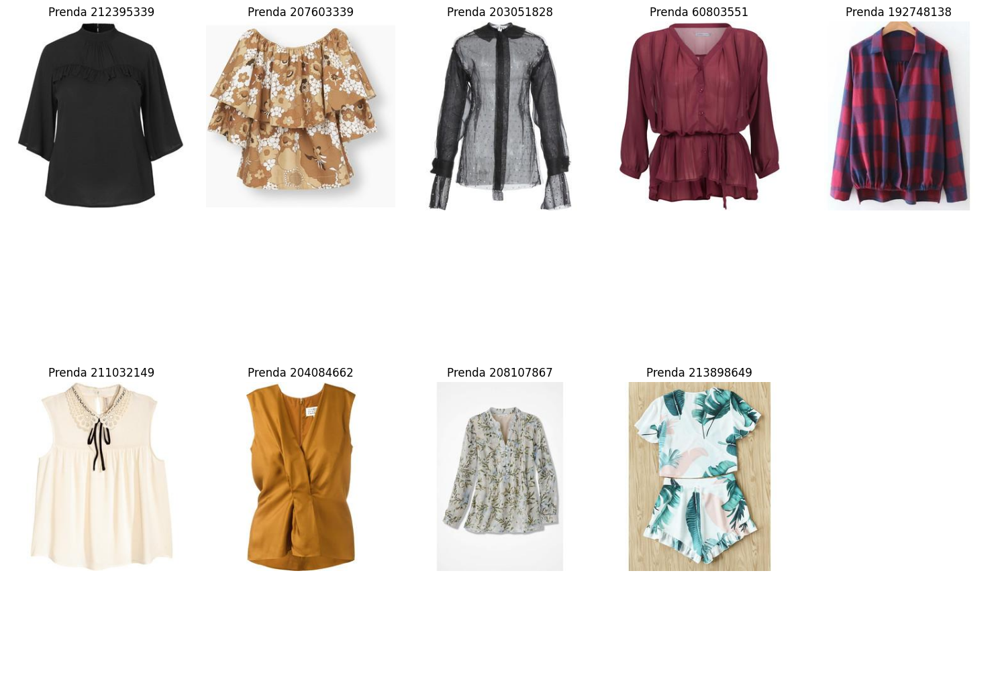


Cluster 9 (3 prendas):
 - Prenda 177072516: cinq sept stardust rowan floral-print
 - Prenda 126844526: violeta mango monochrome soft blouse
 - Prenda 143988286: mid-length short sleeves surprise tea
  Mostrando 3 imágenes del cluster 9:


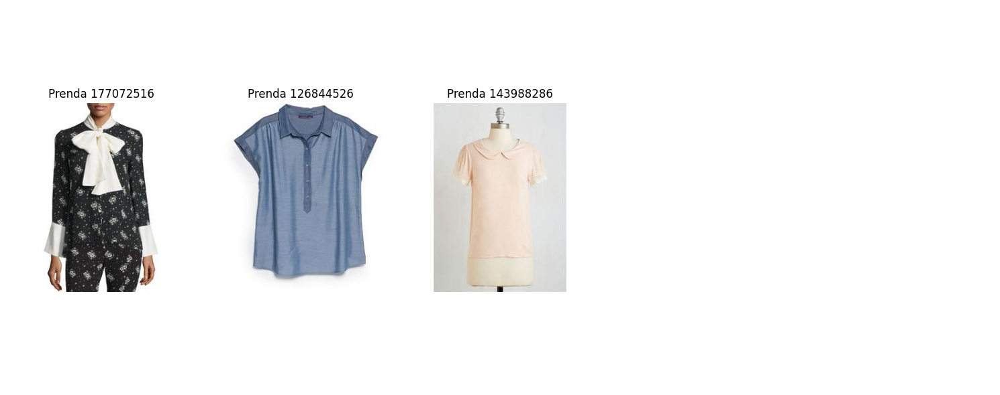


Cluster 10 (3 prendas):
 - Prenda 24408972: elle shops Shopping Guide Topic: ELLE-Shops-The-Classics Page .ELLE.com experts show you where to sh...
 - Prenda 101156182: wunderkind lilac blue bow blouse Locker geschnittene Bluse mit rundem, halsfernem Kragen und langen ...
 - Prenda 214363023: preowned saint laurent rive gauche
  Mostrando 3 imágenes del cluster 10:


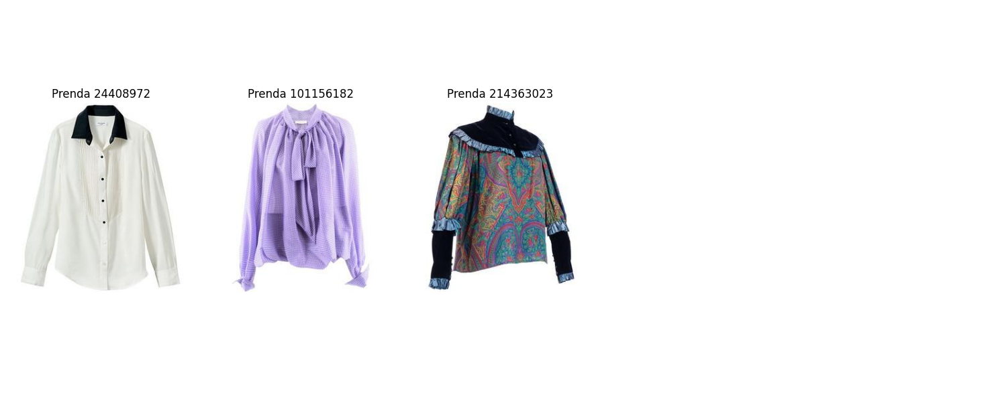


Cluster 12 (1 prendas):
 - Prenda 79206234: boy band outsiders printed boat
  Mostrando 1 imágenes del cluster 12:


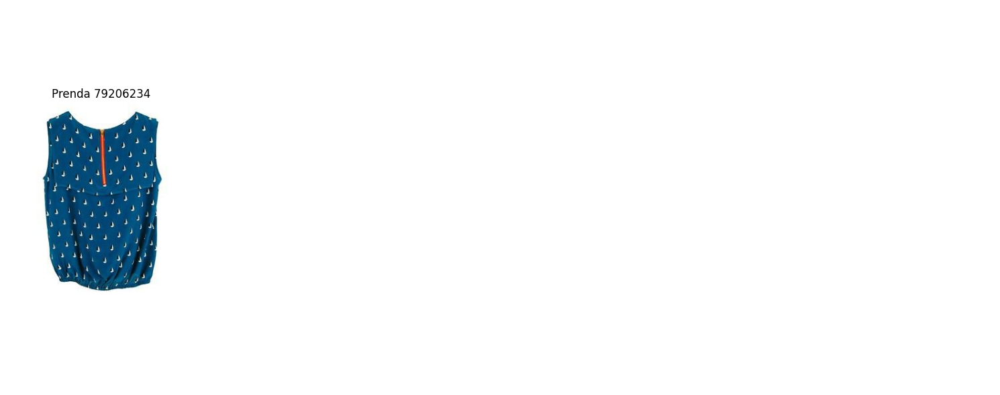


Cluster 30 (1 prendas):
 - Prenda 197937556: printed chiffon asymmetric plus size
  Mostrando 1 imágenes del cluster 30:


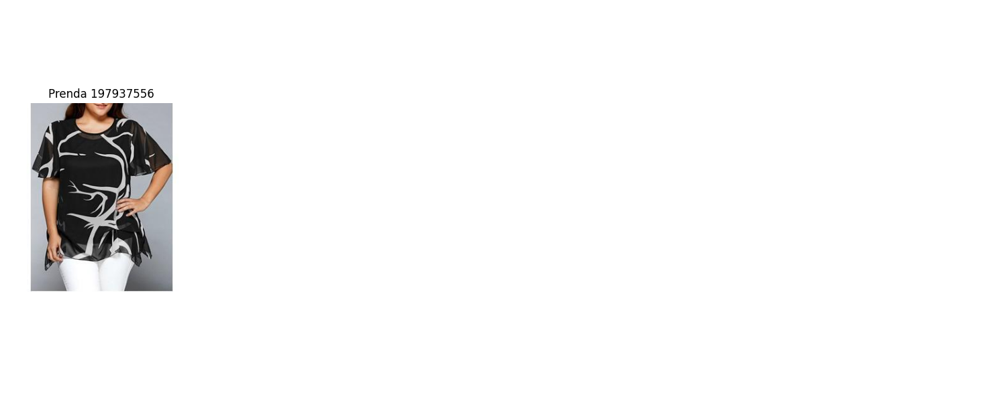


Cluster 49 (1 prendas):
 - Prenda 149514032: amazon.com iron fist womens creepers
  Mostrando 1 imágenes del cluster 49:


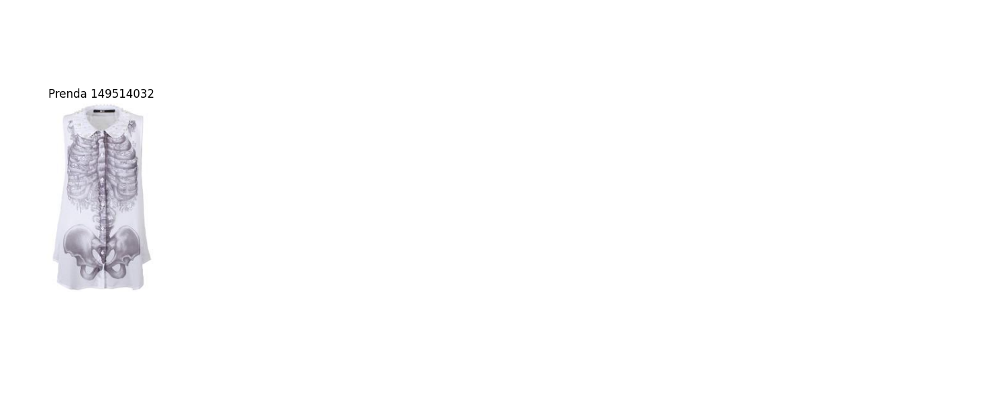


Cluster 75 (1 prendas):
 - Prenda 97781397: orla kiely solid crepe blouse Classic blouse in crepe fabric. This blouse has a large collar and an ...
  Mostrando 1 imágenes del cluster 75:


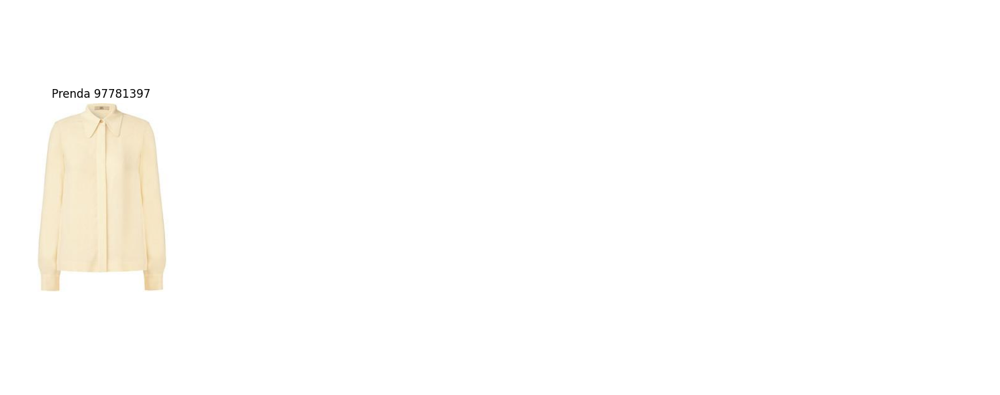

In [26]:
import os
import json
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"
SUBCATEGORY = "tops"  # Subcategoría semántica
CATEGORY_ID = 17    # Subcategoría específica (ajusta según tus datos, por ejemplo, cat15)

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def get_item_description(item):
    """Concatena todas las entradas de texto de una prenda."""
    fields = ['url_name', 'description', 'title', 'categories', 'related']
    parts = []
    for field in fields:
        value = item.get(field, '')
        if isinstance(value, list):
            value = ' '.join(str(v) for v in value)
        if value:
            parts.append(value)
    return ' '.join(parts)[:100] + "..." if len(' '.join(parts)) > 100 else ' '.join(parts)

def show_cluster_examples():
    """Muestra 10 ejemplos de prendas por cluster y visualiza sus imágenes."""
    # Cargar metadatos
    metadata = load_metadata()
    
    # Ruta al CSV de la subcategoría
    csv_path = os.path.join(OUTPUT_DIR, SUBCATEGORY, f'cat{CATEGORY_ID}_hdp_clusters.csv')
    
    try:
        clusters_df = pd.read_csv(csv_path)
        print(f"Cargado {csv_path} con {len(clusters_df)} prendas")
    except FileNotFoundError:
        print(f"No se encontró {csv_path}. Verifica CATEGORY_ID o si los CSVs se generaron.")
        print("CSVs disponibles en hlda_outputs/tops/:")
        import glob
        csv_files = glob.glob(os.path.join(OUTPUT_DIR, SUBCATEGORY, "cat*.csv"))
        print([os.path.basename(f) for f in csv_files])
        return
    
    # Agrupar por cluster
    clusters = defaultdict(list)
    for _, row in clusters_df.iterrows():
        item_id = str(row['item_id'])
        cluster_id = row['cluster']
        if item_id in metadata:
            clusters[cluster_id].append((item_id, metadata[item_id]))
    
    # Mostrar ejemplos y visualizar
    for cluster_id in sorted(clusters.keys()):
        if cluster_id == -1:  # Saltar prendas sin cluster asignado
            continue
        print(f"\nCluster {cluster_id} ({len(clusters[cluster_id])} prendas):")
        
        # Mostrar hasta 10 ejemplos
        examples = clusters[cluster_id][:10]
        for item_id, item in examples:
            description = get_item_description(item)
            print(f" - Prenda {item_id}: {description}")
        
        # Visualizar imágenes
        num_items_to_show = min(10, len(examples))
        if num_items_to_show == 0:
            print("  No hay prendas para visualizar en este cluster.")
            continue
        
        images_per_row = 5
        num_rows = (num_items_to_show + images_per_row - 1) // images_per_row
        fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
        # Asegurar que axes sea un array 1D de Axes objects
        axes = axes.flatten() if num_rows * images_per_row > 1 else [axes] if num_items_to_show == 1 else axes
        
        print(f"  Mostrando {num_items_to_show} imágenes del cluster {cluster_id}:")
        for i, (item_id, _) in enumerate(examples):
            image_path = f"datasets/polyvore/images/{item_id}.jpg"
            try:
                img = mpimg.imread(image_path)
                axes[i].imshow(img)
                axes[i].set_title(f"Prenda {item_id}")
                axes[i].axis('off')
            except Exception as e:
                axes[i].text(0.5, 0.5, f"No se pudo cargar\nPrenda {item_id}\n{e}",
                             ha='center', va='center', fontsize=10, color='red')
                axes[i].axis('off')
        
        # Ocultar ejes vacíos
        for j in range(i + 1, len(axes)):
            axes[j].axis('off')
        
        plt.tight_layout()
        plt.show()

# Ejecutar
show_cluster_examples()

In [18]:
import os
import json
import pandas as pd
from collections import defaultdict

# Configuración de rutas
METADATA_PATH = "datasets/polyvore/item_metadata.json"
OUTPUT_DIR = "hlda_outputs"

def load_metadata():
    """Carga los metadatos de las prendas."""
    try:
        with open(METADATA_PATH, 'r') as f:
            metadata = json.load(f)
        metadata_dict = {str(item['item_id']): item for item in metadata}
        print(f"Cargados {len(metadata_dict)} metadatos de prendas")
        return metadata_dict
    except FileNotFoundError as e:
        print(f"No se encontró {METADATA_PATH}: {e}")
        raise
    except json.JSONDecodeError as e:
        print(f"Error al decodificar {METADATA_PATH}: {e}")
        raise

def count_cluster_assignments():
    """Cuenta las prendas asignadas a clusters y muestra la distribución por cluster."""
    # Cargar metadatos
    metadata = load_metadata()
    all_item_ids = set(metadata.keys())
    
    # Recopilar asignaciones de clusters
    assigned_items = defaultdict(list)  # (semantic_cat, category_id) -> [(item_id, cluster)]
    cluster_counts = defaultdict(lambda: defaultdict(int))  # (semantic_cat, category_id) -> cluster -> count
    cluster_minus_one_counts = defaultdict(int)  # (semantic_cat, category_id) -> count for -1
    total_assigned = set()
    
    # Recorrer todos los CSVs en hlda_outputs
    for semantic_cat in os.listdir(OUTPUT_DIR):
        semantic_dir = os.path.join(OUTPUT_DIR, semantic_cat)
        if not os.path.isdir(semantic_dir):
            continue
        for csv_file in os.listdir(semantic_dir):
            if csv_file.endswith("_hdp_clusters.csv"):
                try:
                    category_id = int(csv_file.replace("cat", "").replace("_hdp_clusters.csv", ""))
                except ValueError:
                    continue
                csv_path = os.path.join(semantic_dir, csv_file)
                try:
                    df = pd.read_csv(csv_path)
                    for _, row in df.iterrows():
                        item_id = str(row['item_id'])
                        cluster_id = row['cluster']
                        assigned_items[(semantic_cat, category_id)].append((item_id, cluster_id))
                        cluster_counts[(semantic_cat, category_id)][cluster_id] += 1
                        total_assigned.add(item_id)
                        if cluster_id == -1:
                            cluster_minus_one_counts[(semantic_cat, category_id)] += 1
                except Exception as e:
                    print(f"Error al leer {csv_path}: {e}")
    
    # Prendas no asignadas
    unassigned_items = all_item_ids - total_assigned
    
    # Imprimir resumen general
    print("\n=== Resumen de Asignación de Clusters ===")
    print(f"Total de prendas en item_metadata.json: {len(all_item_ids)}")
    print(f"Prendas asignadas a un cluster: {len(total_assigned)} ({len(total_assigned)/len(all_item_ids)*100:.2f}%)")
    print(f"Prendas no asignadas: {len(unassigned_items)} ({len(unassigned_items)/len(all_item_ids)*100:.2f}%)")
    if unassigned_items:
        print(f"Ejemplo de prendas no asignadas (hasta 10): {list(unassigned_items)[:10]}")
    
    total_minus_one = sum(cluster_minus_one_counts.values())
    print(f"\nTotal de prendas en cluster basura (-1): {total_minus_one} ({total_minus_one/len(total_assigned)*100:.2f}% de las asignadas)")
    
    # Detalle por categoría semántica y subcategoría
    print("\n=== Distribución de Prendas por Categoría, Subcategoría y Cluster ===")
    for (semantic_cat, category_id), items in sorted(assigned_items.items()):
        total_in_category = len(items)
        minus_one_count = cluster_minus_one_counts.get((semantic_cat, category_id), 0)
        print(f"\n{semantic_cat}/cat{category_id}:")
        print(f" - Total de prendas asignadas: {total_in_category}")
        print(f" - Prendas en cluster basura (-1): {minus_one_count} ({minus_one_count/total_in_category*100:.2f}%)")
        print(f" - Prendas en clusters válidos: {total_in_category - minus_one_count}")
        print(" - Distribución por cluster:")
        for cluster_id in sorted(cluster_counts[(semantic_cat, category_id)].keys()):
            count = cluster_counts[(semantic_cat, category_id)][cluster_id]
            print(f"   - Cluster {cluster_id}: {count} prendas ({count/total_in_category*100:.2f}%)")

# Ejecutar
count_cluster_assignments()

Cargados 251008 metadatos de prendas

=== Resumen de Asignación de Clusters ===
Total de prendas en item_metadata.json: 251008
Prendas asignadas a un cluster: 251008 (100.00%)
Prendas no asignadas: 0 (0.00%)

Total de prendas en cluster basura (-1): 0 (0.00% de las asignadas)

=== Distribución de Prendas por Categoría, Subcategoría y Cluster ===

accessories/cat52:
 - Total de prendas asignadas: 1815
 - Prendas en cluster basura (-1): 0 (0.00%)
 - Prendas en clusters válidos: 1815
 - Distribución por cluster:
   - Cluster 0: 640 prendas (35.26%)
   - Cluster 1: 203 prendas (11.18%)
   - Cluster 2: 390 prendas (21.49%)
   - Cluster 3: 493 prendas (27.16%)
   - Cluster 4: 27 prendas (1.49%)
   - Cluster 5: 14 prendas (0.77%)
   - Cluster 6: 11 prendas (0.61%)
   - Cluster 7: 12 prendas (0.66%)
   - Cluster 8: 6 prendas (0.33%)
   - Cluster 9: 6 prendas (0.33%)
   - Cluster 10: 1 prendas (0.06%)
   - Cluster 11: 1 prendas (0.06%)
   - Cluster 13: 3 prendas (0.17%)
   - Cluster 14: 1 prend

## Creamos diccionarios de los clusters para el entrenamiento

In [19]:
import os
import pandas as pd
import numpy as np
from collections import defaultdict
import pickle

# Ruta base donde están los CSV y donde se guardarán los diccionarios
BASE_OUTPUT_DIR = "hlda_outputs"

def build_cluster_dictionaries(base_dir):
    """
    Construye tres diccionarios a partir de los CSV de clusters HDP:
    - item_to_info: Mapea item_id a su semantic_category, category_id y cluster_id.
    - cluster_to_items: Mapea (semantic_category, category_id, cluster_id) a una lista de item_id.
    - category_to_clusters: Mapea (semantic_category, category_id) a un conjunto de cluster_id.
    """
    item_to_info = {}
    cluster_to_items = defaultdict(list)
    category_to_clusters = defaultdict(set)
    
    # Recorrer todas las carpetas dentro de hlda_outputs (cada carpeta es una semantic_category)
    for semantic_cat in os.listdir(base_dir):
        semantic_dir = os.path.join(base_dir, semantic_cat)
        if not os.path.isdir(semantic_dir):
            continue
        
        # Recorrer todos los archivos CSV dentro de la carpeta semantic_category
        for filename in os.listdir(semantic_dir):
            if not filename.endswith('_hdp_clusters.csv'):
                continue
            
            # Extraer category_id del nombre del archivo (por ejemplo, cat15_hdp_clusters.csv -> 15)
            category_id_str = filename.replace('cat', '').replace('_hdp_clusters.csv', '')
            try:
                category_id = int(category_id_str)
            except ValueError:
                continue
            
            # Leer el CSV
            filepath = os.path.join(semantic_dir, filename)
            try:
                df = pd.read_csv(filepath)
            except Exception as e:
                print(f"Error al leer {filepath}: {e}")
                continue
            
            # Procesar cada fila del CSV
            for _, row in df.iterrows():
                item_id = str(row['item_id'])  # Asegurarnos de que item_id sea string
                cluster_id = int(row['cluster'])
                
                # Añadir al diccionario item_to_info
                item_to_info[item_id] = {
                    'semantic_category': semantic_cat,
                    'category_id': category_id,
                    'cluster_id': cluster_id
                }
                
                # Añadir al diccionario cluster_to_items
                cluster_key = (semantic_cat, category_id, cluster_id)
                cluster_to_items[cluster_key].append(item_id)
                
                # Añadir al diccionario category_to_clusters
                category_key = (semantic_cat, category_id)
                category_to_clusters[category_key].add(cluster_id)
    
    print(f"Se procesaron {len(item_to_info)} prendas en total.")
    print(f"Se encontraron {len(cluster_to_items)} combinaciones de (semantic_category, category_id, cluster_id).")
    print(f"Se encontraron {len(category_to_clusters)} combinaciones de (semantic_category, category_id).")
    return item_to_info, cluster_to_items, category_to_clusters

def sample_negatives_from_different_clusters(positive_item_id, item_to_info, cluster_to_items, category_to_clusters, num_negatives=5):
    """
    Dado un item_id positivo, samplea negativos de la misma semantic_category y category_id
    pero de distintos clusters al del positivo.
    
    Args:
        positive_item_id (str): ID de la prenda positiva.
        item_to_info (dict): Diccionario que mapea item_id a su información.
        cluster_to_items (dict): Diccionario que mapea (semantic_category, category_id, cluster_id) a item_id.
        category_to_clusters (dict): Diccionario que mapea (semantic_category, category_id) a un conjunto de cluster_id.
        num_negatives (int): Número de negativos a samplear.
    
    Returns:
        list: Lista de item_id de negativos sampleados.
    """
    # Obtener la información del positivo
    if positive_item_id not in item_to_info:
        raise ValueError(f"Item ID {positive_item_id} no encontrado en item_to_info.")
    
    info = item_to_info[positive_item_id]
    semantic_cat = info['semantic_category']
    category_id = info['category_id']
    positive_cluster = info['cluster_id']
    
    # Obtener todos los cluster_id disponibles para esta semantic_category y category_id
    category_key = (semantic_cat, category_id)
    if category_key not in category_to_clusters:
        print(f"No se encontraron clusters para {semantic_cat}/{category_id}.")
        return []
    
    all_clusters = category_to_clusters[category_key]
    # Excluir el cluster del positivo
    possible_clusters = [cluster_id for cluster_id in all_clusters if cluster_id != positive_cluster]
    
    if not possible_clusters:
        print(f"No se encontraron clusters distintos para {semantic_cat}/{category_id}.")
        return []
    
    # Samplear negativos de los clusters distintos
    negatives = []
    for _ in range(num_negatives):
        # Elegir un cluster aleatorio de los posibles
        cluster_id = possible_clusters[np.random.randint(len(possible_clusters))]
        cluster_key = (semantic_cat, category_id, cluster_id)
        items_in_cluster = cluster_to_items[cluster_key]
        
        # Samplear un item aleatorio de ese cluster
        negative_item = np.random.choice(items_in_cluster)
        negatives.append(negative_item)
    
    return negatives

def main():
    # Construir los diccionarios a partir de los CSV
    print("Construyendo diccionarios a partir de los CSV de HDP...")
    item_to_info, cluster_to_items, category_to_clusters = build_cluster_dictionaries(BASE_OUTPUT_DIR)
    
    # Ejemplo de uso: Samplear negativos para un item_id positivo
    # Cambia '211990161' por un item_id válido de tus CSVs (por ejemplo, de tops/cat15)
    positive_item_id = '211990161'
    try:
        negatives = sample_negatives_from_different_clusters(
            positive_item_id, item_to_info, cluster_to_items, category_to_clusters, num_negatives=5
        )
        print(f"\nNegativos sampleados para item_id = {positive_item_id}:")
        for neg in negatives:
            print(f"- {neg} (Cluster: {item_to_info[neg]['cluster_id']})")
    except ValueError as e:
        print(f"Error: {e}")
        print("Prueba con un item_id presente en los CSVs, por ejemplo:")
        print(list(item_to_info.keys())[:5])  # Mostrar 5 item_id válidos
    
    # Guardar los diccionarios dentro de la carpeta hlda_outputs
    with open(os.path.join(BASE_OUTPUT_DIR, 'item_to_info_hdp.pkl'), 'wb') as f:
        pickle.dump(item_to_info, f)
    with open(os.path.join(BASE_OUTPUT_DIR, 'cluster_to_items_hdp.pkl'), 'wb') as f:
        pickle.dump(cluster_to_items, f)
    with open(os.path.join(BASE_OUTPUT_DIR, 'category_to_clusters_hdp.pkl'), 'wb') as f:
        pickle.dump(category_to_clusters, f)
    print(f"\nDiccionarios guardados en '{BASE_OUTPUT_DIR}' como 'item_to_info_hdp.pkl', 'cluster_to_items_hdp.pkl' y 'category_to_clusters_hdp.pkl'.")

if __name__ == "__main__":
    main()

Construyendo diccionarios a partir de los CSV de HDP...
Se procesaron 251008 prendas en total.
Se encontraron 2160 combinaciones de (semantic_category, category_id, cluster_id).
Se encontraron 153 combinaciones de (semantic_category, category_id).

Negativos sampleados para item_id = 211990161:
- 109440813 (Cluster: 1)
- 71916103 (Cluster: 9)
- 171154878 (Cluster: 5)
- 210229514 (Cluster: 8)
- 172617949 (Cluster: 8)

Diccionarios guardados en 'hlda_outputs' como 'item_to_info_hdp.pkl', 'cluster_to_items_hdp.pkl' y 'category_to_clusters_hdp.pkl'.


Loaded 53306 outfits from datasets/polyvore/nondisjoint/train.json
Diccionarios cargados desde kmeans:
- item_to_info: 251008 prendas
- cluster_to_items: 2160 combinaciones
- category_to_clusters: 153 combinaciones

Outfit seleccionado: set_id = 219064623, items = [200948689, 197196143, 203042119, 204490525]
Ítem quitado: 204490525
Ítems restantes: [200948689, 197196143, 203042119]

Mostrando el outfit original (incluyendo el ítem quitado):


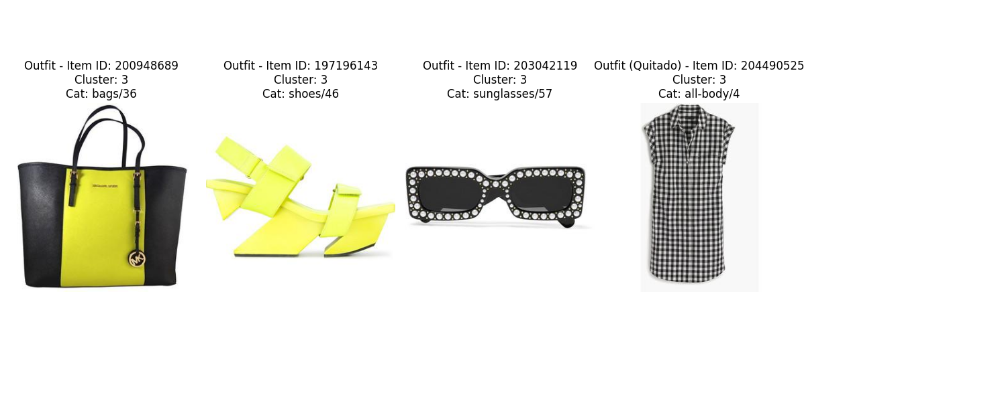


Negativos sampleados para el ítem quitado (204490525):

Mostrando los negativos sampleados:


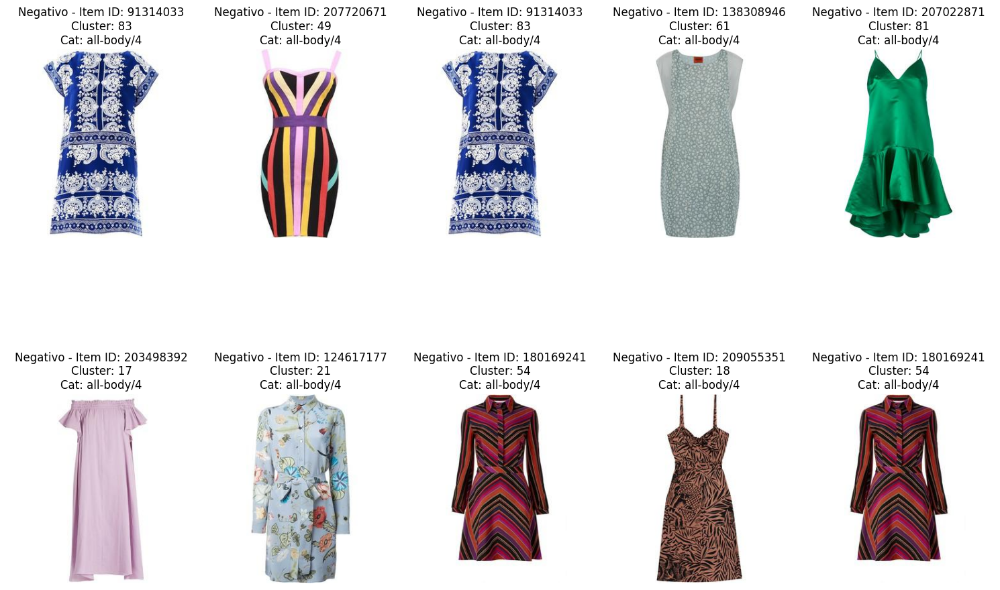

In [24]:

# Paso 4: Importar las bibliotecas necesarias
import os
import json
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import defaultdict

# Rutas a los archivos
TRAIN_JSON_PATH = "datasets/polyvore/nondisjoint/train.json"
BASE_OUTPUT_DIR = "hlda_outputs"

def load_outfits(json_path):
    """Carga los outfits desde el archivo JSON."""
    with open(json_path, 'r') as f:
        outfits = json.load(f)
    print(f"Loaded {len(outfits)} outfits from {json_path}")
    return outfits

def load_dictionaries(base_dir):
    """Carga los diccionarios desde los archivos pickle."""
    with open(os.path.join(base_dir, 'item_to_info.pkl'), 'rb') as f:
        item_to_info = pickle.load(f)
    with open(os.path.join(base_dir, 'cluster_to_items.pkl'), 'rb') as f:
        cluster_to_items = pickle.load(f)
    with open(os.path.join(base_dir, 'category_to_clusters.pkl'), 'rb') as f:
        category_to_clusters = pickle.load(f)
    print("Diccionarios cargados desde kmeans:")
    print(f"- item_to_info: {len(item_to_info)} prendas")
    print(f"- cluster_to_items: {len(cluster_to_items)} combinaciones")
    print(f"- category_to_clusters: {len(category_to_clusters)} combinaciones")
    return item_to_info, cluster_to_items, category_to_clusters

def sample_negatives_from_different_clusters(positive_item_id, item_to_info, cluster_to_items, category_to_clusters, num_negatives=10):
    """
    Dado un item_id positivo, samplea negativos de la misma semantic_category y category_id
    pero de distintos clusters al del positivo.
    """
    if positive_item_id not in item_to_info:
        raise ValueError(f"Item ID {positive_item_id} no encontrado en item_to_info.")
    
    info = item_to_info[positive_item_id]
    semantic_cat = info['semantic_category']
    category_id = info['category_id']
    positive_cluster = info['cluster_id']
    
    category_key = (semantic_cat, category_id)
    if category_key not in category_to_clusters:
        print(f"No se encontraron clusters para {semantic_cat}/{category_id}.")
        return []
    
    all_clusters = category_to_clusters[category_key]
    possible_clusters = [cluster_id for cluster_id in all_clusters if cluster_id != positive_cluster]
    
    if not possible_clusters:
        print(f"No se encontraron clusters distintos para {semantic_cat}/{category_id}.")
        return []
    
    negatives = []
    for _ in range(num_negatives):
        cluster_id = possible_clusters[np.random.randint(len(possible_clusters))]
        cluster_key = (semantic_cat, category_id, cluster_id)
        items_in_cluster = cluster_to_items[cluster_key]
        negative_item = np.random.choice(items_in_cluster)
        negatives.append(negative_item)
    
    return negatives

def display_items(item_ids, item_to_info, title_prefix="", removed_item=None):
    """Muestra las imágenes de los ítems con información de sus clusters."""
    num_items = len(item_ids)
    images_per_row = 5
    num_rows = (num_items + images_per_row - 1) // images_per_row
    
    # Crear la cuadrícula de subgráficos
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 6 * num_rows))
    
    # Asegurarnos de que axes sea siempre un array unidimensional de objetos Axes
    if num_rows == 1 and num_items == 1:
        axes = np.array([axes])
    elif num_rows == 1:
        axes = axes.flatten() if isinstance(axes, np.ndarray) else np.array(axes)
    else:
        axes = axes.flatten()
    
    for i, item_id in enumerate(item_ids):
        image_path = f"datasets/polyvore/images/{item_id}.jpg"
        # Determinar el prefijo del título según si el ítem es el quitado
        prefix = title_prefix
        if removed_item is not None and str(item_id) == str(removed_item):
            prefix = "Outfit (Quitado) - "
        else:
            prefix = title_prefix
        
        try:
            img = mpimg.imread(image_path)
            axes[i].imshow(img)
            info = item_to_info.get(str(item_id), {})
            cluster_info = f"Cluster: {info.get('cluster_id', 'N/A')}\n" \
                          f"Cat: {info.get('semantic_category', 'N/A')}/{info.get('category_id', 'N/A')}"
            axes[i].set_title(f"{prefix}Item ID: {item_id}\n{cluster_info}")
            axes[i].axis('off')
        except Exception as e:
            axes[i].text(0.5, 0.5, f"No se pudo cargar\nItem ID: {item_id}\n{e}",
                         ha='center', va='center', fontsize=10, color='red')
            axes[i].axis('off')
    
    # Ocultar ejes vacíos
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()

def main():
    # Cargar los outfits
    outfits = load_outfits(TRAIN_JSON_PATH)
    
    # Cargar los diccionarios
    item_to_info, cluster_to_items, category_to_clusters = load_dictionaries(BASE_OUTPUT_DIR)
    
    # Samplear un outfit aleatorio
    random_outfit = np.random.choice(outfits)
    set_id = random_outfit['set_id']
    outfit_items = random_outfit['item_ids']
    print(f"\nOutfit seleccionado: set_id = {set_id}, items = {outfit_items}")
    
    # Seleccionar un ítem aleatorio para quitar
    removed_item = np.random.choice(outfit_items)
    remaining_items = [item for item in outfit_items if item != removed_item]
    print(f"Ítem quitado: {removed_item}")
    print(f"Ítems restantes: {remaining_items}")
    
    # Mostrar el outfit original (incluyendo el ítem quitado)
    print("\nMostrando el outfit original (incluyendo el ítem quitado):")
    display_items(outfit_items, item_to_info, title_prefix="Outfit - ", removed_item=removed_item)
    
    # Samplear 10 negativos de la misma semantic_category y category_id pero de distintos clusters
    try:
        negatives = sample_negatives_from_different_clusters(
            str(removed_item), item_to_info, cluster_to_items, category_to_clusters, num_negatives=10
        )
        print(f"\nNegativos sampleados para el ítem quitado ({removed_item}):")
        for neg in negatives:
            #print(f"- {neg} (Cluster: {item_to_info[neg]['cluster_id']})")
            continue
        # Mostrar los negativos
        print("\nMostrando los negativos sampleados:")
        display_items(negatives, item_to_info, title_prefix="Negativo - ")
    except ValueError as e:
        print(e)

if __name__ == "__main__":
    main()